# Subclustering of Trunk ectoderm in integration data

In [1]:
library(Seurat)
library(ggplot2)
library(magrittr)
library(data.table)
library(Matrix)
library(dplyr)
library(tibble)
library(harmony)


Attaching package: ‘dplyr’


The following objects are masked from ‘package:data.table’:

    between, first, last


The following objects are masked from ‘package:stats’:

    filter, lag


The following objects are masked from ‘package:base’:

    intersect, setdiff, setequal, union


Loading required package: Rcpp



In [2]:
sessionInfo()

R version 4.0.3 (2020-10-10)
Platform: x86_64-apple-darwin17.0 (64-bit)
Running under: macOS Catalina 10.15.7

Matrix products: default
BLAS:   /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRblas.dylib
LAPACK: /Library/Frameworks/R.framework/Versions/4.0/Resources/lib/libRlapack.dylib

locale:
[1] ja_JP.UTF-8/ja_JP.UTF-8/ja_JP.UTF-8/C/ja_JP.UTF-8/ja_JP.UTF-8

attached base packages:
[1] stats     graphics  grDevices utils     datasets  methods   base     

other attached packages:
[1] harmony_0.1.0     Rcpp_1.0.7        tibble_3.0.5      dplyr_1.0.3      
[5] Matrix_1.3-2      data.table_1.13.6 magrittr_2.0.1    ggplot2_3.3.3    
[9] Seurat_3.2.3     

loaded via a namespace (and not attached):
 [1] nlme_3.1-151          matrixStats_0.57.0    RcppAnnoy_0.0.18     
 [4] RColorBrewer_1.1-2    httr_1.4.2            repr_1.1.0           
 [7] sctransform_0.3.2     tools_4.0.3           R6_2.5.1             
[10] irlba_2.3.3           rpart_4.1-15          KernSmooth_2.23-18

In [3]:
func.centering <- function(seu){
    DefaultAssay(seu) <- 'SCT'
    scale.data <- GetAssayData(seu, assay = 'SCT', slot = 'scale.data') #scale.dataを取得
    new.data <- ScaleData(object = scale.data, do.scale = F, do.center = T) #centering
    
    seu <- SetAssayData(object = seu, assay = 'SCT',
                        slot = 'scale.data', new.data = new.data) #scale.data slotに挿入
    return(seu)
    
}

func.normalize <- function(seu){
    if(dim(seu)[2]>=500){
        DefaultAssay(seu) <- 'RNA'
        if(seu$set[1]=='Set 1'){
            vars.to.regress <- c("percent.mt", "percent.rRNA","percent.ERCC")
        }else{
            vars.to.regress <- c("percent.mt", "percent.rRNA")
        }
        seu <- suppressWarnings(SCTransform(seu, vars.to.regress = vars.to.regress))
    }else{
        seu <- func.centering(seu)
    }
    return(seu)
}

func.subclustering.prep <- function(seu){
    obj.list <- SplitObject(seu, split.by = 'set')
    
    print(obj.list)
    
    obj.list <- lapply(X = obj.list, FUN = func.normalize)
    print(obj.list)
    integration.features <- SelectIntegrationFeatures(object.list = obj.list, nfeatures = 3000)
    seu <- merge(x = obj.list[['Set 3']], y = c(obj.list[['Set 2']],obj.list[['Set 1']],obj.list[['NK-data']]))
    VariableFeatures(seu) <- integration.features
    seu <- RunPCA(seu)
    seu <- RunHarmony(object = seu, group.by.vars = 'set', assay.use="SCT")
    seu <- RunUMAP(seu, dims = 1:30, n.neighbors = 20L, reduction = 'harmony')
    seu <- RunUMAP(seu, dims = 1:30, n.neighbors = 20L, reduction = 'pca', reduction.name = 'umapwoharmony')

    options(repr.plot.width=16, repr.plot.height=8)
    p <- DimPlot(seu, reduction = 'umapwoharmony', group.by = 'set') + DimPlot(seu, reduction = 'umap', group.by = 'set')
    plot(p)
    
    print(seu)
    return(seu)
}

func.subclustering <- function(seu, resolution=0.8){
    seu <- FindNeighbors(seu, dims = 1:30, reduction = 'harmony')
    seu <- FindClusters(seu, resolution = resolution)
    options(repr.plot.width=16, repr.plot.height=8)
    p <- DimPlot(seu, reduction = 'umap', label = T) + NoLegend() + DimPlot(seu, reduction = 'umap', group.by = 'set')
    plot(p)
    return(seu)
}

In [4]:
seu_HQC <- readRDS(file = '../../data/seurat_object/all_integration/seu_Harmony_integrated.obj')
seu_HQC

An object of class Seurat 
25136 features across 13467 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

Warning message:
“Using `as.character()` on a quosure is deprecated as of rlang 0.3.0.
Please use `as_label()` or `as_name()` instead.
This warning is displayed once per session.”


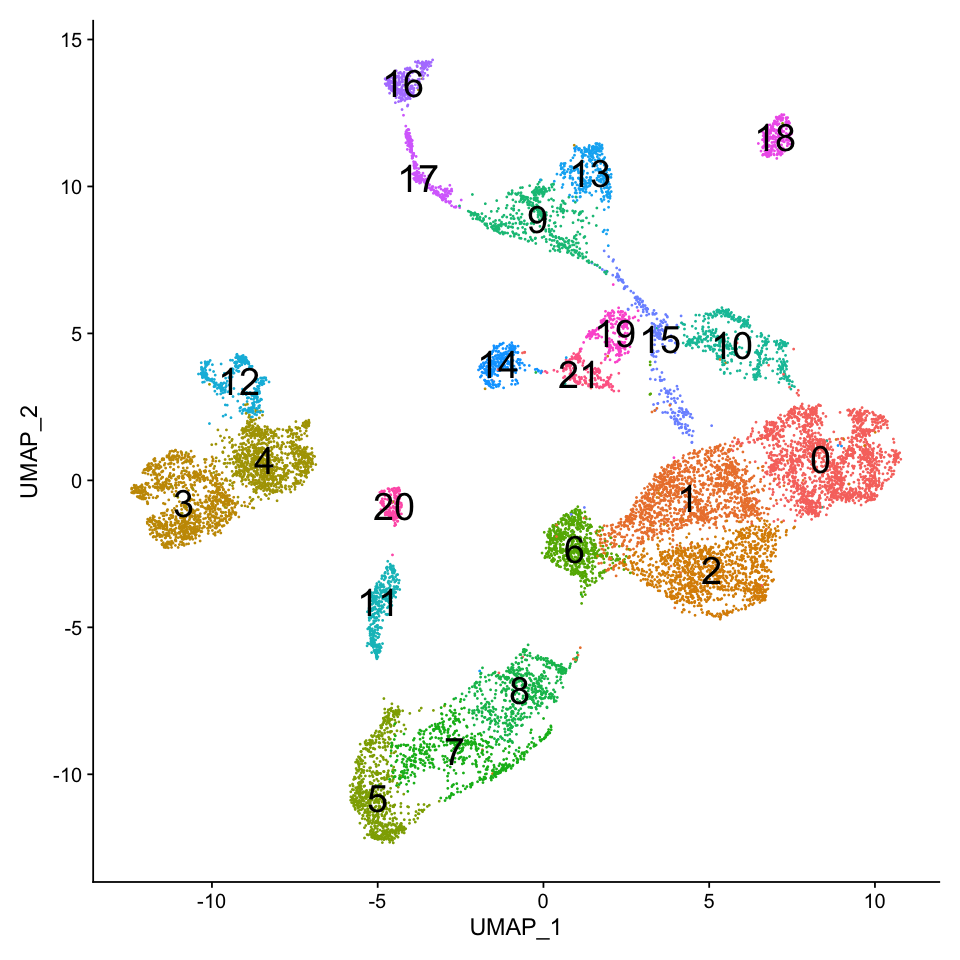

In [5]:
Idents(seu_HQC) <- 'seurat_clusters'
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu_HQC, reduction = 'umap', label = TRUE, label.size = 8) + NoLegend()

## Picking up target clusters

In [6]:
options(repr.plot.width=8, repr.plot.height=8)
highlight.cells <- WhichCells(seu_HQC,idents = c(0,1,2,6,10,19,21,15))
fig <- DimPlot(seu_HQC, reduction =  "umap", cells.highlight = highlight.cells, pt.size = 0.5, sizes.highlight = 0.5,
        cols.highlight = 'magenta3', label = FALSE) + NoLegend() + ggtitle(
        'Cluster 0,1,2,6,10,19,21,15: lateral ectoderm'
        )
ggsave(fig, file = './figures/06_lateral_ecto_subclustering_integrate_all/Highlight_lateral_ecto_PS1.eps')

Saving 7 x 7 in image



In [7]:
seu.ecto <- subset(seu_HQC, idents = c(0,1,2,6,10,19,21,15))
seu.ecto$cluster.allcell <- seu.ecto$seurat_clusters
seu.ecto

An object of class Seurat 
25136 features across 6432 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

## Clustering

$`Set 3`
An object of class Seurat 
25136 features across 2629 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

$`Set 2`
An object of class Seurat 
25136 features across 2703 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

$`NK-data`
An object of class Seurat 
25136 features across 646 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

$`Set 1`
An object of class Seurat 
25136 features across 454 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony



Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 9939 by 2629

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2629 cells



  |======================================================================| 100%


Found 135 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 9939 genes



  |======================================================================| 100%


Computing corrected count matrix for 9939 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 26.70025 secs

Determine variable features

Set 3000 variable features

Place corrected count matrix in counts slot

Regressing out percent.mt, percent.rRNA

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 9908 by 2703

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 2703 cells



  |======================================================================| 100%


Found 115 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 9908 genes



  |======================================================================| 100%


Computing corrected count matrix for 9908 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 26.59113 secs

Determine variable features

Set 3000 variable features

Place corrected count matrix in counts slot

Regressing out percent.mt, percent.rRNA

Centering data matrix

Set default assay to SCT

Calculating cell attributes from input UMI matrix: log_umi

Variance stabilizing transformation of count matrix of size 8717 by 646

Model formula is y ~ log_umi

Get Negative Binomial regression parameters per gene

Using 2000 genes, 646 cells



  |======================================================================| 100%


Found 62 outliers - those will be ignored in fitting/regularization step


Second step: Get residuals using fitted parameters for 8717 genes



  |======================================================================| 100%


Computing corrected count matrix for 8717 genes



  |======================================================================| 100%


Calculating gene attributes

Wall clock passed: Time difference of 7.22412 secs

Determine variable features

Set 3000 variable features

Place corrected count matrix in counts slot

Regressing out percent.mt, percent.rRNA

Centering data matrix

Set default assay to SCT

Centering data matrix



$`Set 3`
An object of class Seurat 
22507 features across 2629 samples within 2 assays 
Active assay: SCT (9939 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

$`Set 2`
An object of class Seurat 
22476 features across 2703 samples within 2 assays 
Active assay: SCT (9908 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

$`NK-data`
An object of class Seurat 
21285 features across 646 samples within 2 assays 
Active assay: SCT (8717 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony

$`Set 1`
An object of class Seurat 
25136 features across 454 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 3 dimensional reductions calculated: pca, umap, harmony



Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 18 features requested have not been scaled (running reduction without them): St4, lncRNA:CR44017, asRNA:CR44351, asRNA:CR44873, sing, CG15449, lncRNA:CR45602, TTLL6A, lncRNA:CR43640, asRNA:CR45468, CG9254, lncRNA:CR46031, lncRNA:CR44082, asRNA:CR45124, yellow-f2, asRNA:CR43786, asRNA:CR45208, GstO3”
PC_ 1 
Positive:  SoxN, sog, sca, ImpL2, ths, Toll-6, D, CG43355-sala, Cys, Tet 
	   brk, slp1, Tollo, gsb, Dl, pnt, Meltrin, l(1)sc, Pino, path 
	   rdx, wg, CG17724-Kdm4B-seq, pyr, ind, noc, ac, mid, Ilp4, tkv 
Negative:  mirr, tup, emc, Ama, egr, CG45263, cv-2, Dtg, Doc1, peb 
	   Doc3, Z600, ush, Svil, hbs, Ance, srp, Alk, dap, rho 
	   CG12420, scyl, Doc2, kay, net, CG14427, rst, pnr, chrb, prage 
PC_ 2 
Positive:  sog, D, vn, SoxN, CG43355-sala, pnt, sca, peb, rho, dap 
	   CG12986, Ilp4, rst, fend, halo, egr, toc, prage, Ance, Doc3 
	   vnd, CG13653, brk, scyl, chrb, srp, Doc2, tup, C15

An object of class Seurat 
25136 features across 6432 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, harmony, umap, umapwoharmony


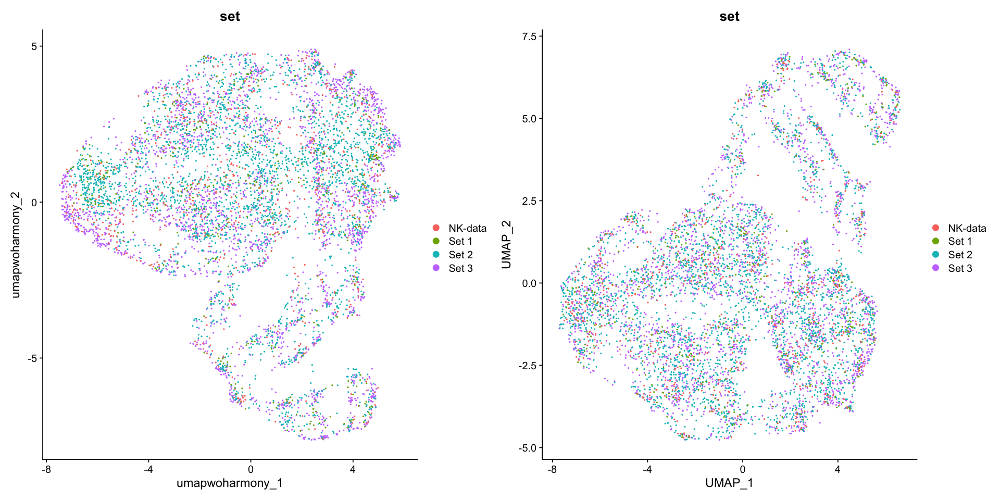

In [8]:
seu.ecto <- func.subclustering.prep(seu.ecto)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 6432
Number of edges: 247901

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8196
Number of communities: 12
Elapsed time: 0 seconds


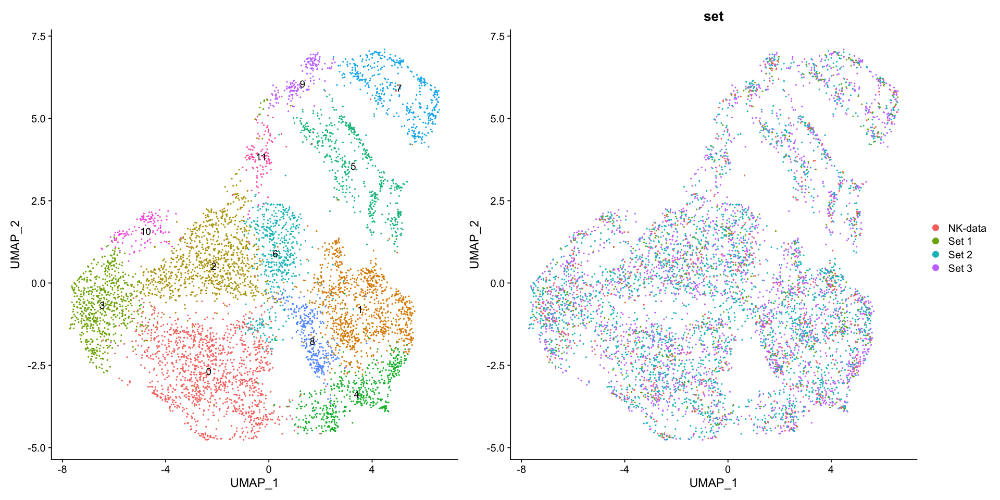

In [9]:
seu.ecto <- func.subclustering(seu.ecto, resolution = 0.8)

In [10]:
all.markers <- FindAllMarkers(object = seu.ecto, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10

Calculating cluster 11



[1] 1963

[1] 120

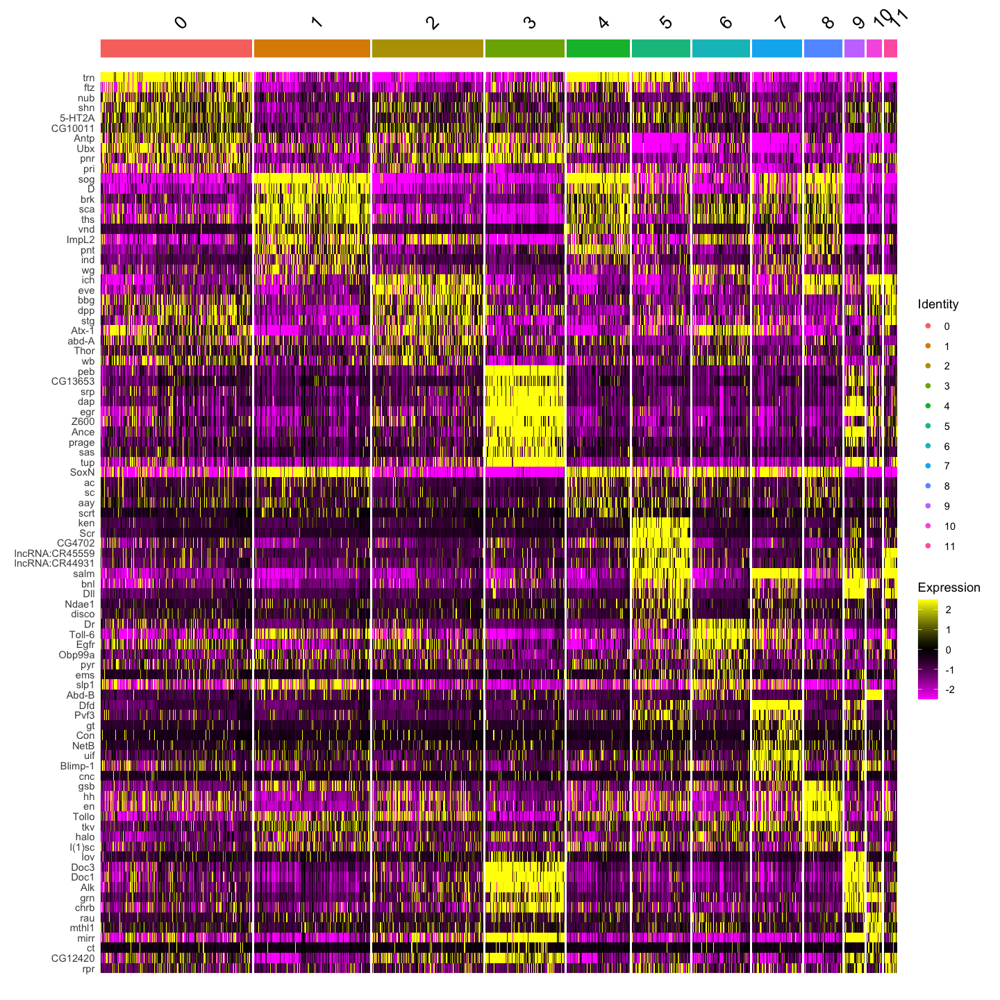

In [11]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto, features = c(all.markers.top10$gene))

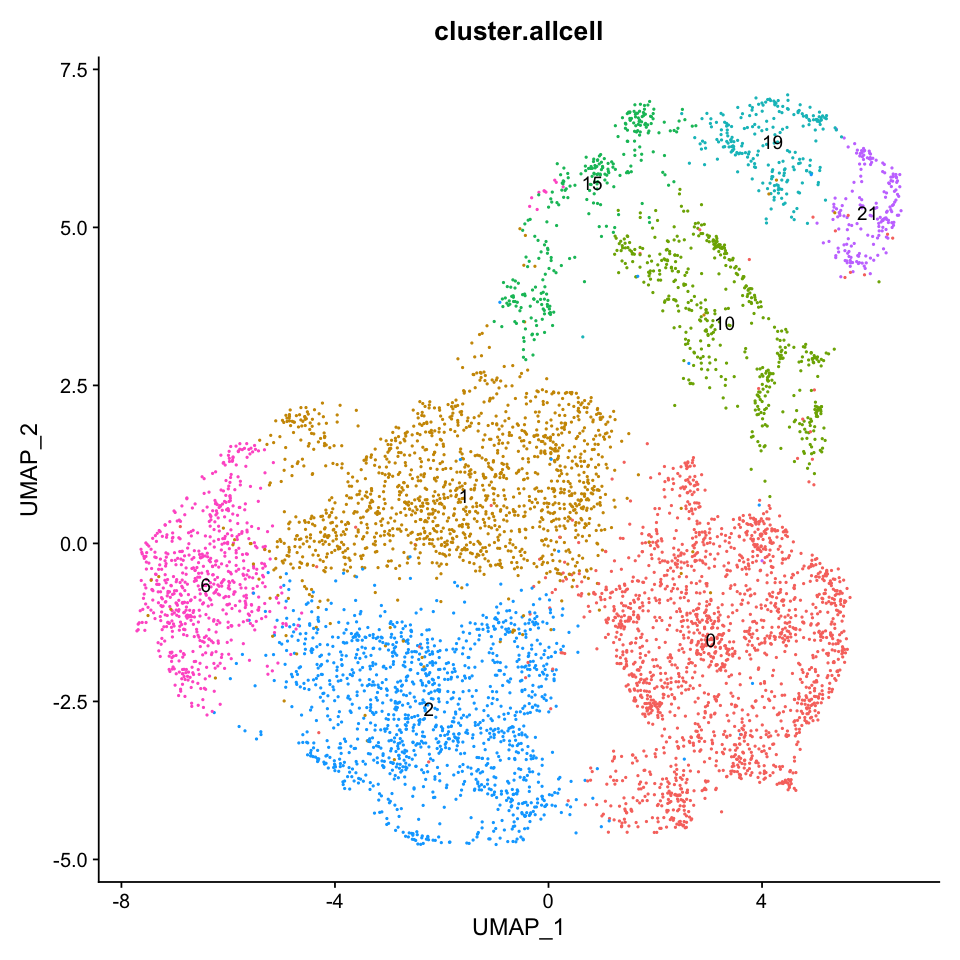

In [12]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', group.by = 'cluster.allcell', label =T) + NoLegend()

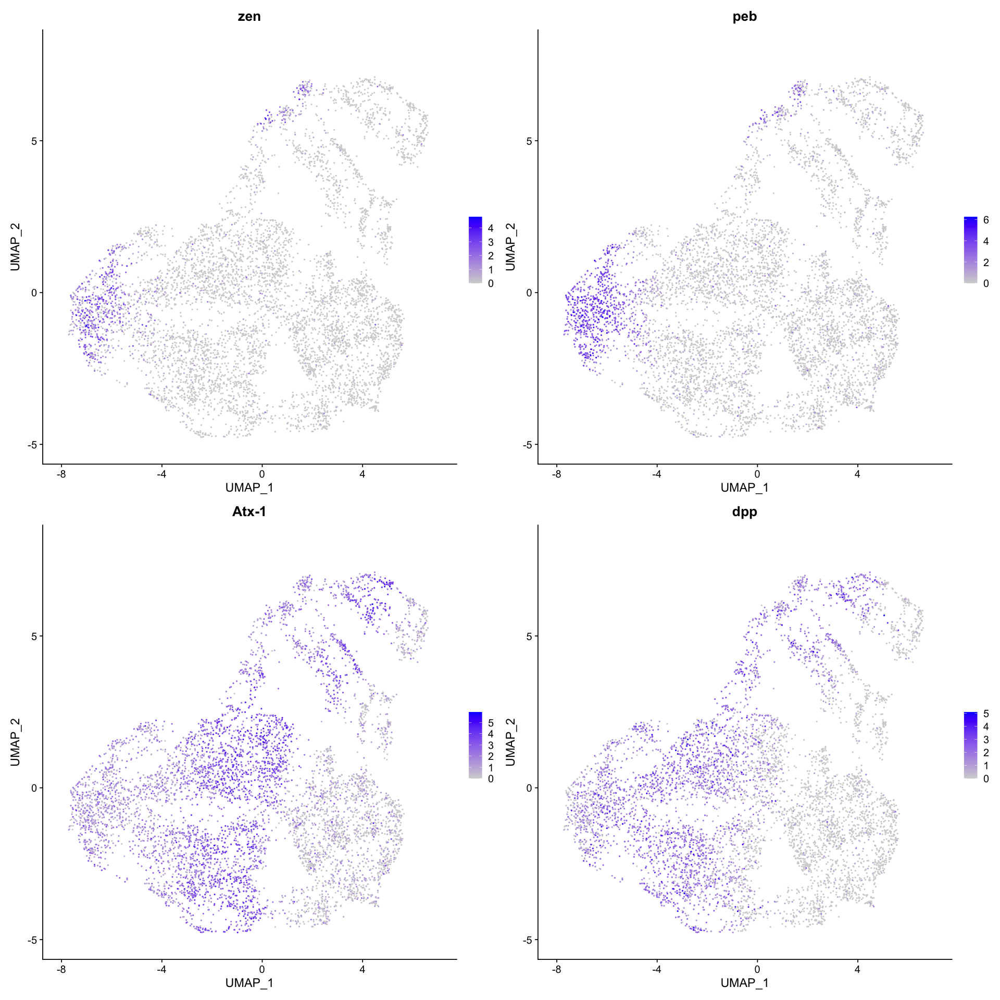

In [13]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = 'umap', features = c('zen','peb','Atx-1','dpp'))

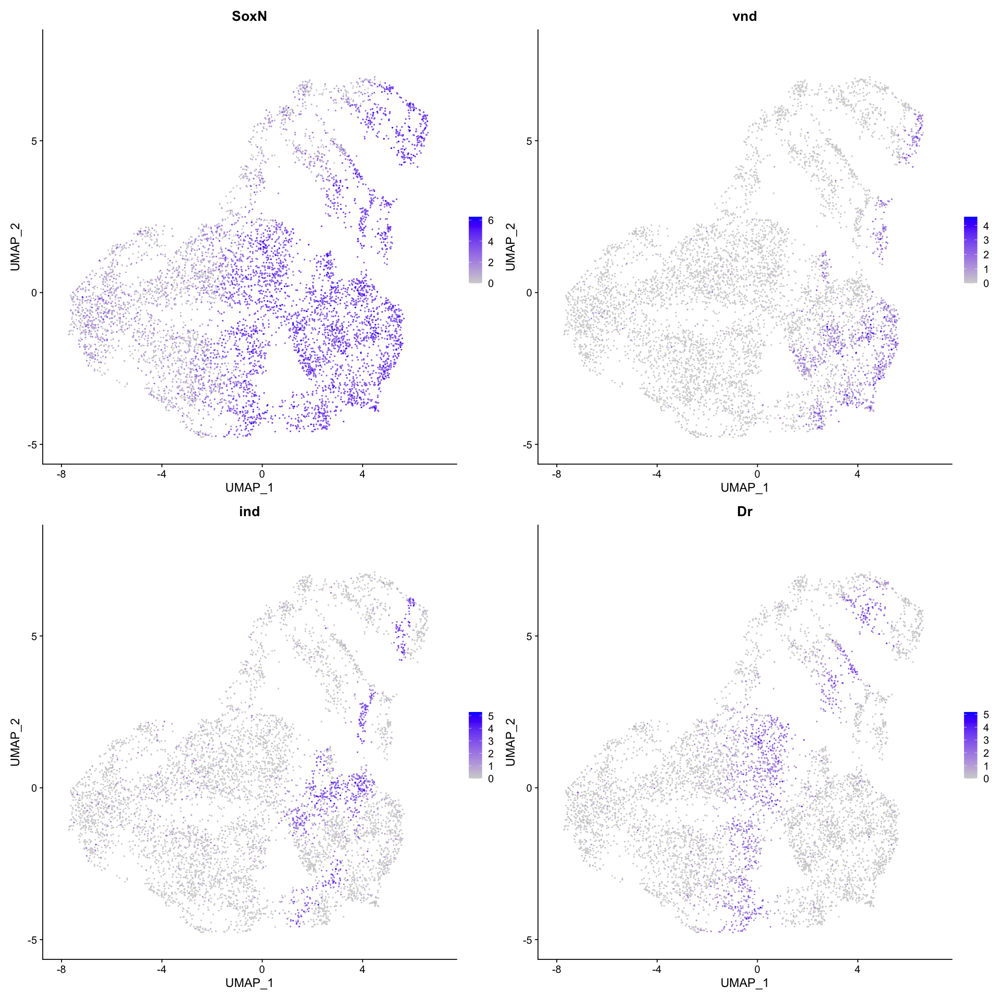

In [14]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = 'umap', features = c('SoxN','vnd','ind','Dr'))

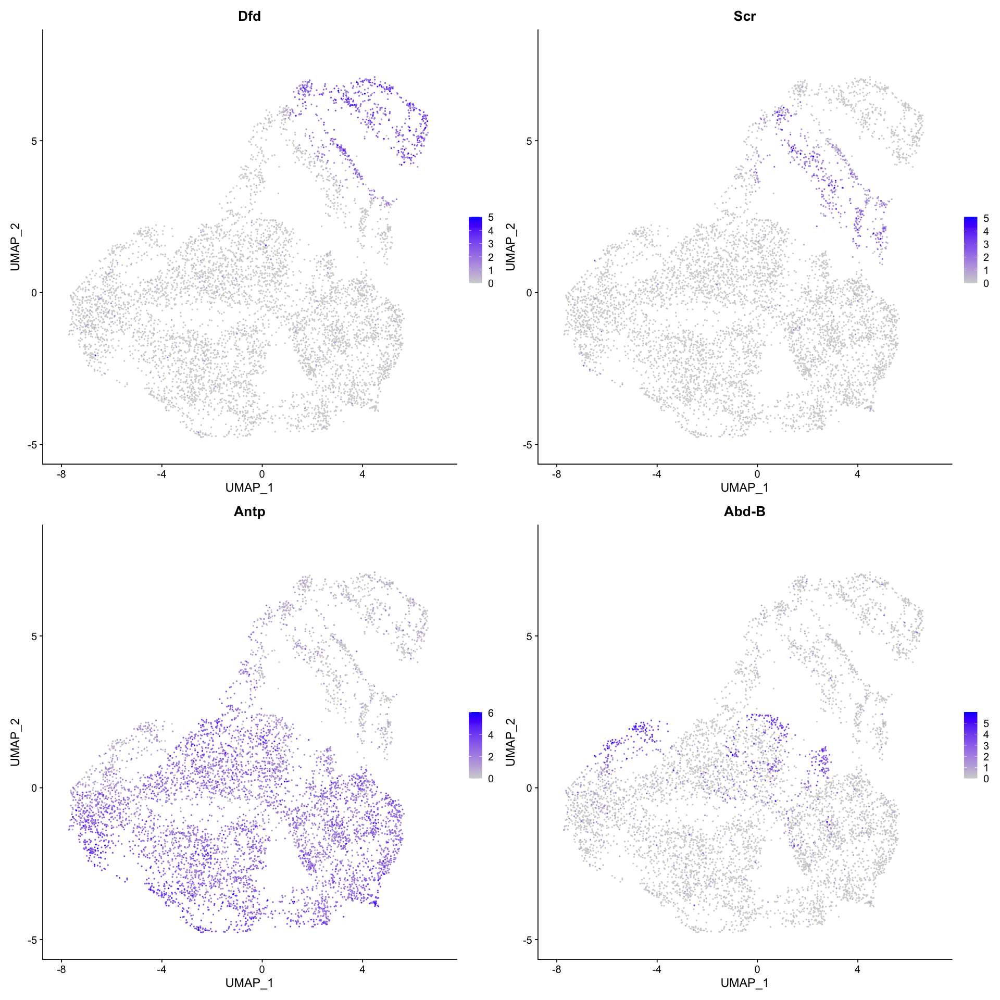

In [15]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto, reduction = 'umap', features = c('Dfd','Scr','Antp','Abd-B'))

Cluster 9: Dll+, dap+ --> anterior amnioserosa  
Cluster 7: Dfd+  --> PS1

## Annotate anterior amnioserosa
### clustering

In [16]:
seu.ant.as <- subset(seu.ecto, idents = 9)
seu.ant.as

An object of class Seurat 
25136 features across 165 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, harmony, umap, umapwoharmony

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 18 features requested have not been scaled (running reduction without them): St4, lncRNA:CR44017, asRNA:CR44351, asRNA:CR44873, sing, CG15449, lncRNA:CR45602, TTLL6A, lncRNA:CR43640, asRNA:CR45468, CG9254, lncRNA:CR46031, lncRNA:CR44082, asRNA:CR45124, yellow-f2, asRNA:CR43786, asRNA:CR45208, GstO3”
PC_ 1 
Positive:  SoxN, ImpL2, sog, Antp, lncRNA:bxd, sca, Ubx, ths, tsh, CG34224 
	   Toll-6, Tet, slp1, D, Tollo, trn, Dl, wb, mid, 18w 
	   abd-A, Cys, run, Pino, Meltrin, pyr, Kr, brk, stg, wg 
Negative:  Dll, Ance, egr, bnl, mirr, Doc1, Doc3, lov, scyl, rho 
	   tup, chrb, Doc2, dap, grn, Alk, emc, cv-2, Sema5c, salm 
	   toc, CG13653, kay, Ama, E(spl)m5-HLH, halo, hbs, ush, prage, Dfd 
PC_ 2 
Positive:  CG45263, salm, Scr, rho, dap, rst, lncRNA:CR45559, Svil, CG4702, CG14427 
	   lncRNA:CR46003, Dtg, E(spl)malpha-BFM, wun2, halo, lncRNA:CR44931, bun, E(spl)m4-BFM, 5-HT2A, E(spl)m2-BFM 
	

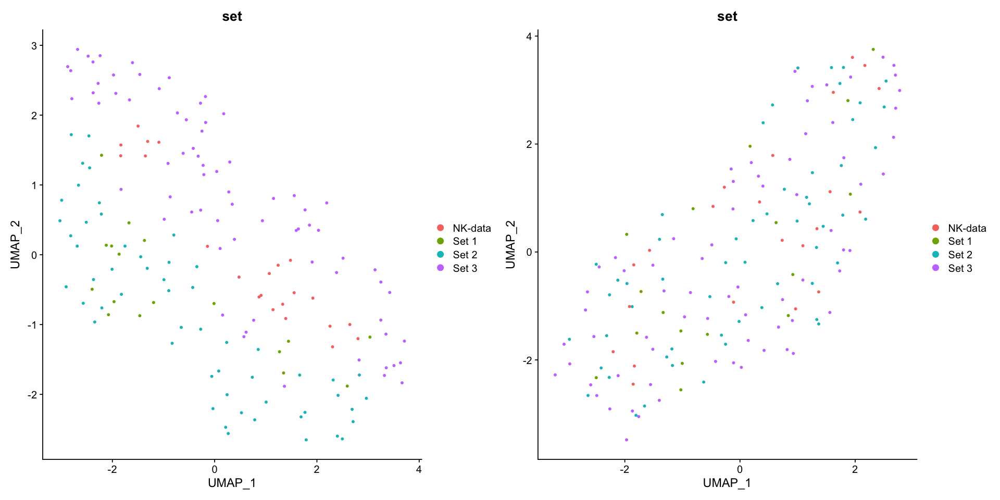

In [17]:
seu.ant.as <- RunPCA(seu.ant.as)
seu.ant.as <- RunHarmony(object = seu.ant.as, group.by.vars = 'set', assay.use="SCT")
seu.ant.as <- RunUMAP(seu.ant.as, dims = 1:30, n.neighbors = 20L, reduction = 'harmony')
seu.ant.as <- RunUMAP(seu.ant.as, dims = 1:30, n.neighbors = 20L, reduction = 'pca', reduction.name = 'umapwoharmony')

options(repr.plot.width=16, repr.plot.height=8)
p <- DimPlot(seu.ant.as, reduction = 'umapwoharmony', group.by = 'set') + DimPlot(seu.ant.as, reduction = 'umap', group.by = 'set')
plot(p)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 165
Number of edges: 11401

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.2729
Number of communities: 2
Elapsed time: 0 seconds


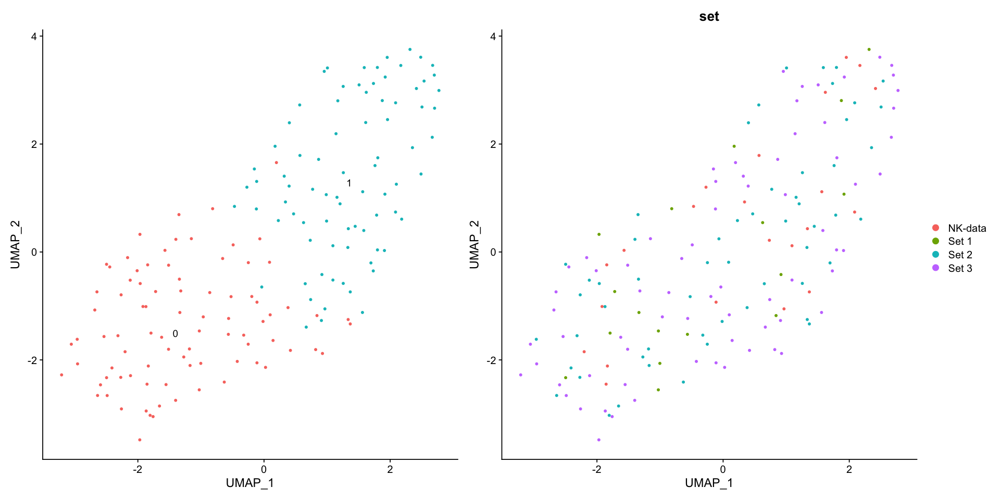

In [18]:
seu.ant.as <- func.subclustering(seu.ant.as, resolution = 0.8)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 165
Number of edges: 11401

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.1769
Number of communities: 3
Elapsed time: 0 seconds


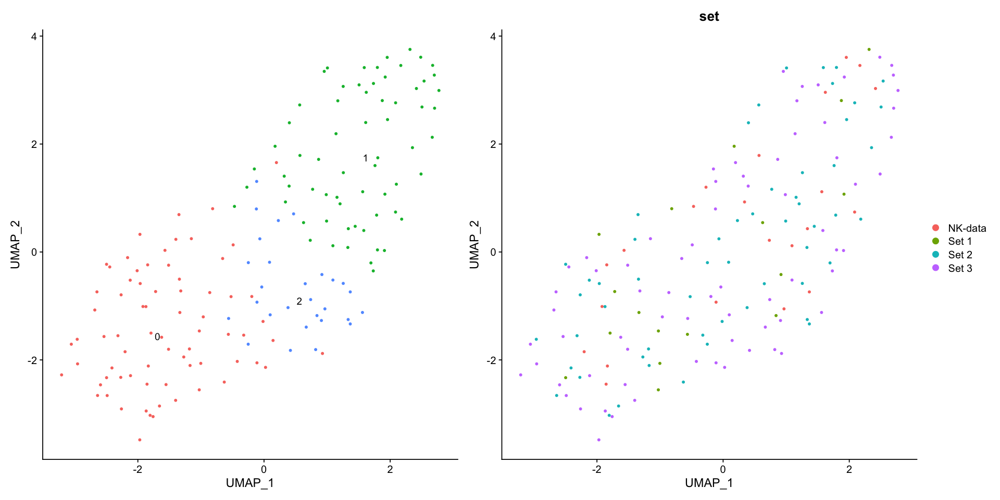

In [19]:
seu.ant.as <- func.subclustering(seu.ant.as, resolution = 1.0)

In [20]:
levels(seu.ant.as) <- c(0,2,1)
all.markers <- FindAllMarkers(object = seu.ant.as, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

Calculating cluster 0

Calculating cluster 2

Calculating cluster 1



[1] 249

[1] 30

Warning message in DoHeatmap(seu.ant.as, features = c("zen", "peb", all.markers.top10$gene)):
“The following features were omitted as they were not found in the scale.data slot for the SCT assay: AstA-R1”


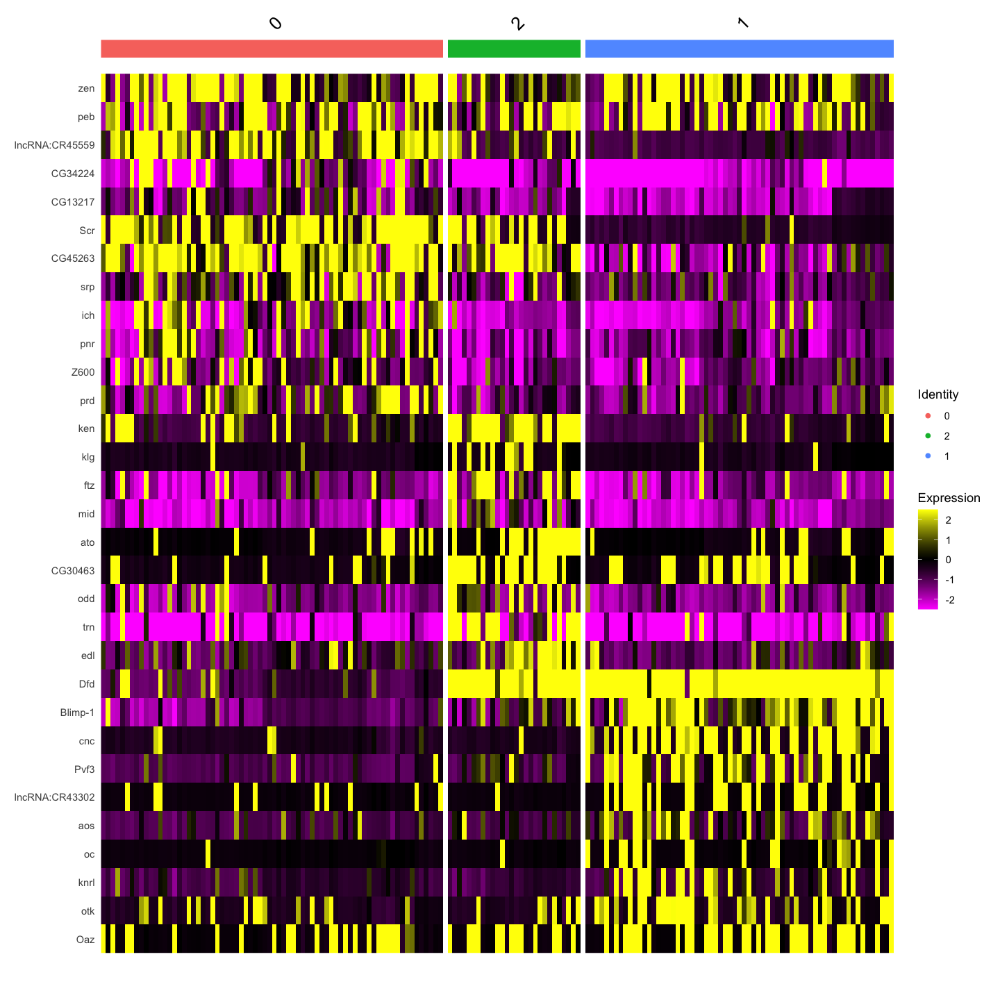

In [21]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ant.as, features = c('zen','peb',all.markers.top10$gene))

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 165
Number of edges: 11401

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.1192
Number of communities: 6
Elapsed time: 0 seconds


1 singletons identified. 5 final clusters.



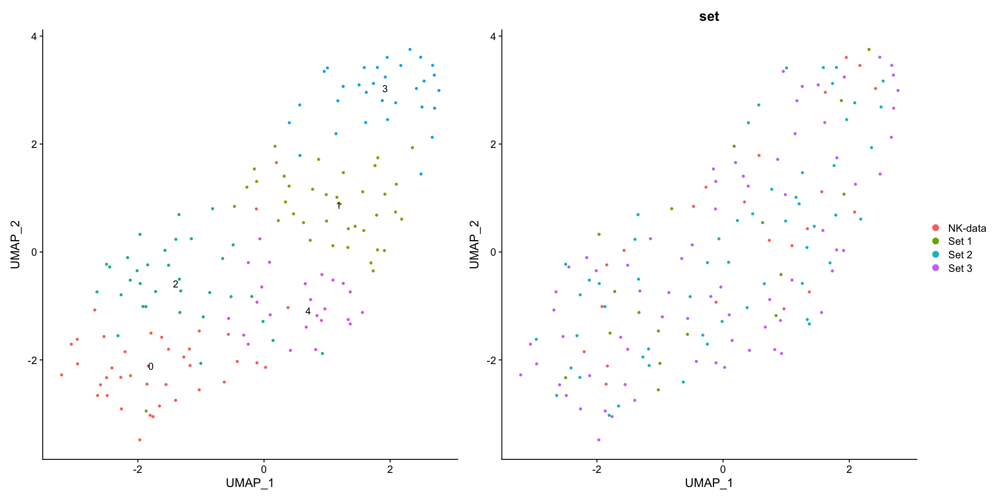

In [22]:
seu.ant.as <- func.subclustering(seu.ant.as, resolution = 1.2)

In [23]:
levels(seu.ant.as) <- c(0,2,4,1,3)
all.markers <- FindAllMarkers(object = seu.ant.as, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

Calculating cluster 0

Calculating cluster 2

Calculating cluster 4

Calculating cluster 1

Calculating cluster 3



[1] 315

[1] 50

Warning message in DoHeatmap(seu.ant.as, features = c("zen", "peb", "en", "eve", :
“The following features were omitted as they were not found in the scale.data slot for the SCT assay: Dscam2, AstA-R1, hd”


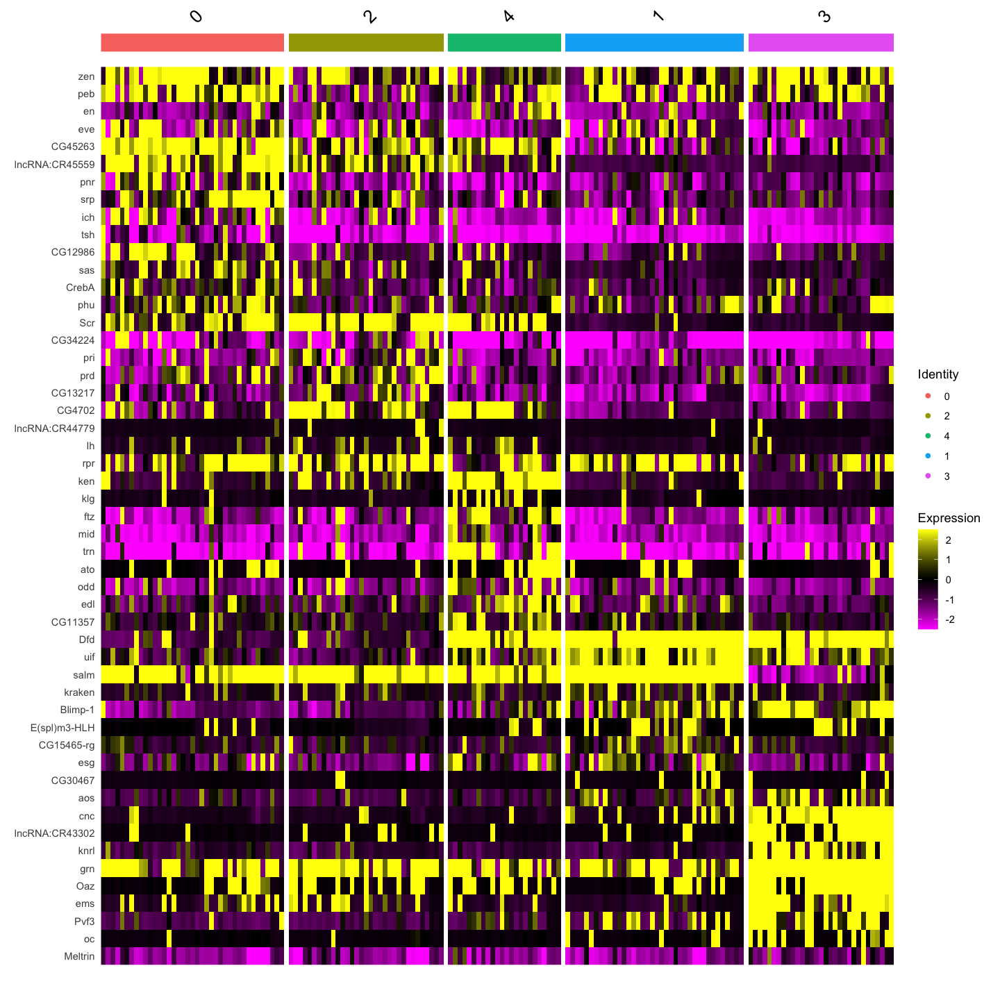

In [24]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ant.as, features = c('zen','peb','en','eve',all.markers.top10$gene))

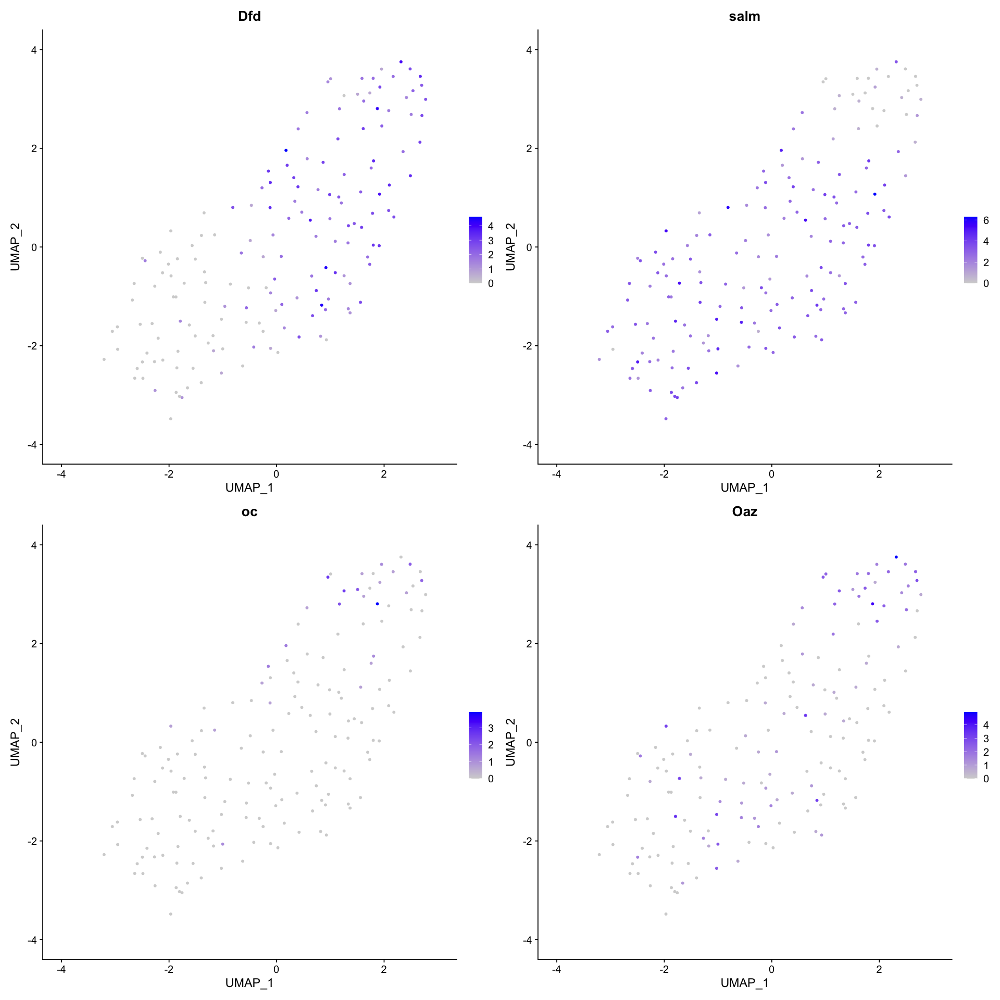

In [25]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ant.as, reduction = 'umap', features = c('Dfd','salm','oc','Oaz'))

### annotation

,manual_ID
,<fct>
Set3_CAGATCAGTTTGACAC,1
Set3_CTCAGTCCACGAGAAC,1
Set3_TATCTGTTCCAGCCTT,1
Set3_TCTCAGCAGTGCACAG,1
Set3_AAACCCAGTCATAGTC,2
Set3_AAGGTAAGTGTCGCTG,4


,manual_ID
,<fct>
Set3_CAGATCAGTTTGACAC,amnioserosa_PS1
Set3_CTCAGTCCACGAGAAC,amnioserosa_PS1
Set3_TATCTGTTCCAGCCTT,amnioserosa_PS1
Set3_TCTCAGCAGTGCACAG,amnioserosa_PS1
Set3_AAACCCAGTCATAGTC,amnioserosa_PS2
Set3_AAGGTAAGTGTCGCTG,amnioserosa_PS2


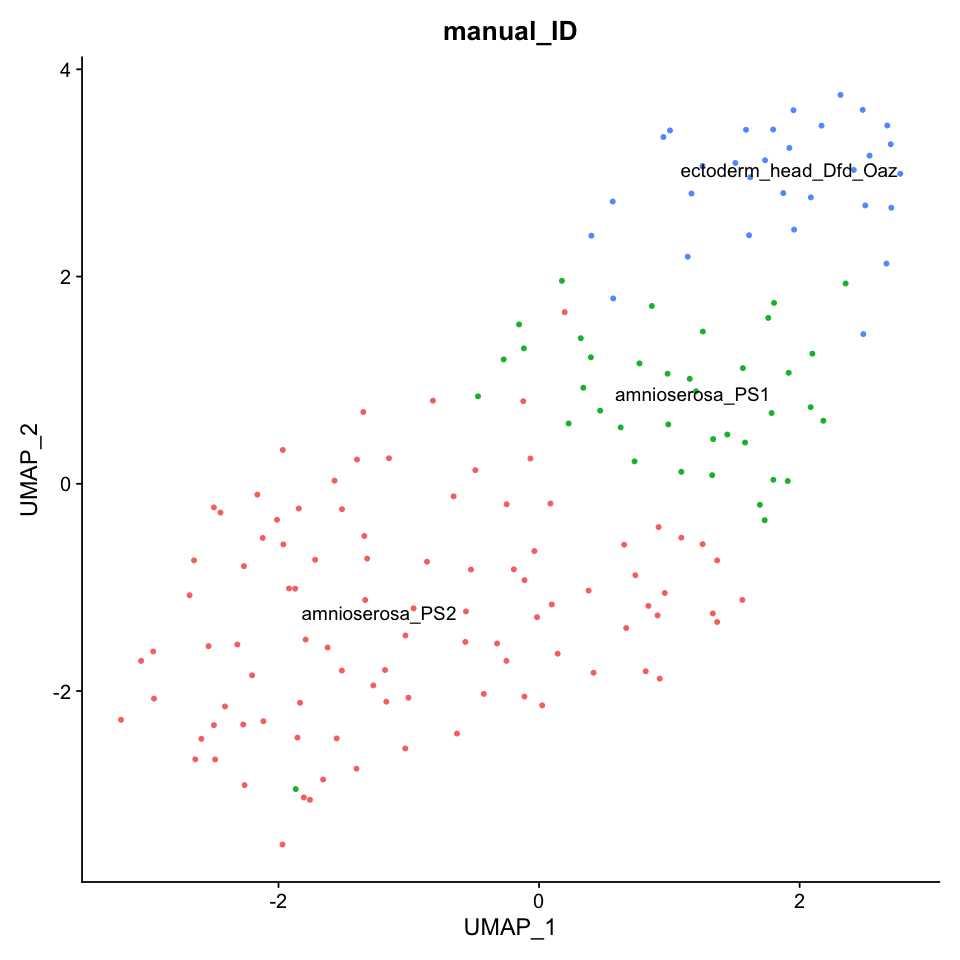

In [26]:
manual_id <- as.data.frame(seu.ant.as$seurat_clusters)
colnames(manual_id) <- c('manual_ID')
head(manual_id)
manual_id$manual_ID = dplyr::recode(manual_id$manual_ID, 
                                     "0"="amnioserosa_PS2", #Scr+
                                     "1"="amnioserosa_PS1", #Dfd+
                                     "2"="amnioserosa_PS2", #Scr+
                                     "3"="ectoderm_head_Dfd_Oaz", #Dfd+, Oaz+, oc+/-
                                     "4"="amnioserosa_PS2", #Scr+
                                   )
                                    

head(manual_id)
seu.ant.as$manual_ID <- manual_id
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ant.as, reduction = 'umap', label = T, group.by = 'manual_ID') + NoLegend()

In [27]:
levels.ant.as <- c('ectoderm_head_Dfd_Oaz', 'amnioserosa_PS1', 'amnioserosa_PS2')
Idents(seu.ant.as) <- 'manual_ID'
levels(seu.ant.as) <- levels.ant.as
levels(seu.ant.as) 
all.markers <- FindAllMarkers(object = seu.ant.as, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

[1] "ectoderm_head_Dfd_Oaz" "amnioserosa_PS1"       "amnioserosa_PS2"

Calculating cluster ectoderm_head_Dfd_Oaz

Calculating cluster amnioserosa_PS1

Calculating cluster amnioserosa_PS2



[1] 260

[1] 30

Saving 7 x 7 in image



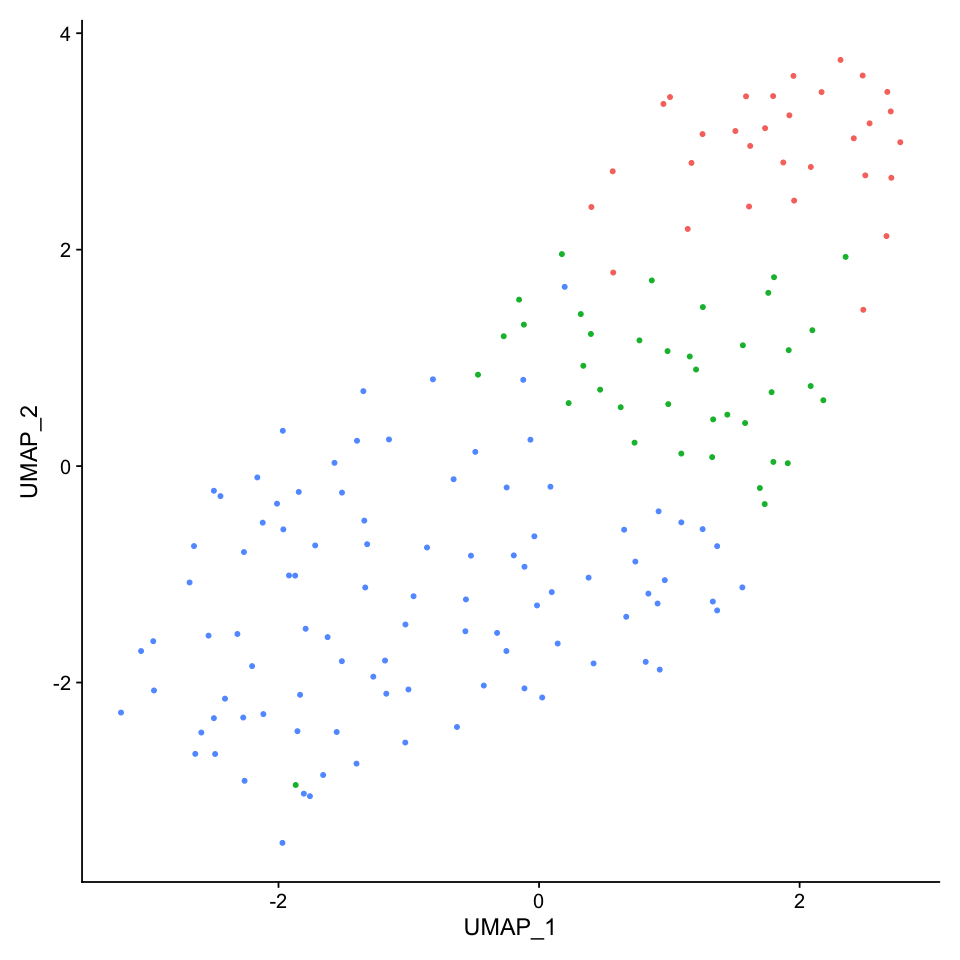

In [28]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ant.as, reduction =  "umap", label = FALSE) + NoLegend() 
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/ant.as_umap1.eps", dpi = 300)

Saving 7 x 7 in image



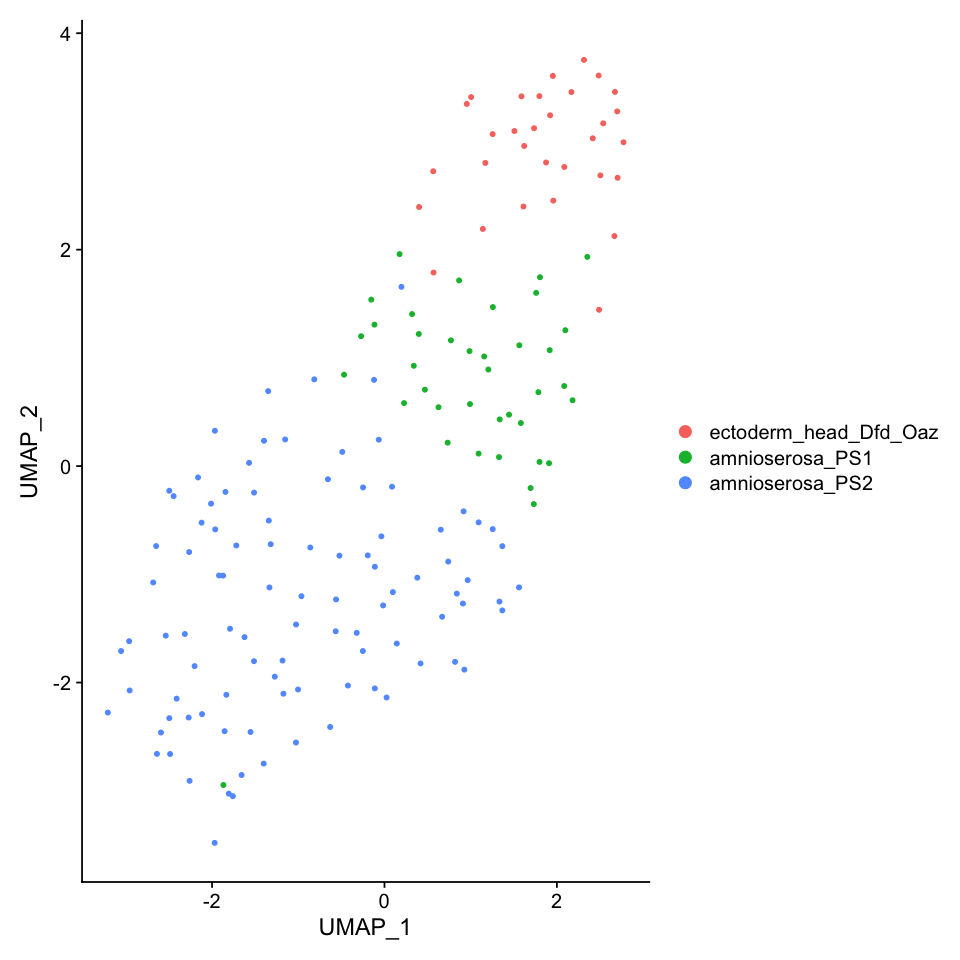

In [29]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ant.as, reduction =  "umap", label = FALSE)
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/ant.as_umap2.eps", dpi = 300)

Warning message in DoHeatmap(seu.ant.as, features = c(all.markers.top10$gene)):
“The following features were omitted as they were not found in the scale.data slot for the SCT assay: Dscam2”


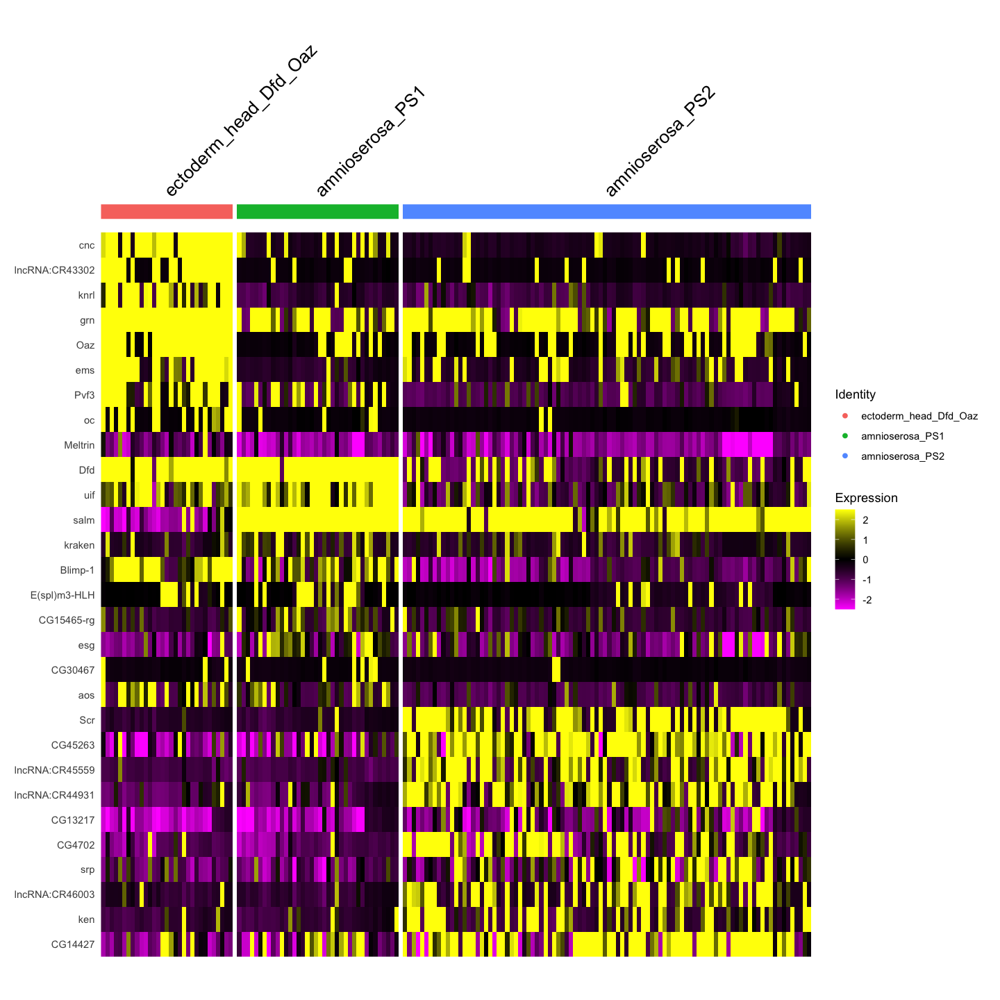

In [30]:
options(repr.plot.width=12, repr.plot.height=12)
fig <- DoHeatmap(seu.ant.as, features = c(all.markers.top10$gene))
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/ant_as_manualID_heatmap.eps", dpi = 300,  width = 12, height = 8)

## Annotation of trunk ectoderm

In [31]:
seu.ecto.others <- subset(seu.ecto, idents = c(9,7), invert = T)

In [32]:
options(repr.plot.width=8, repr.plot.height=8)
highlight.cells <- colnames(seu.ecto.others)
fig <- DimPlot(seu_HQC, reduction =  "umap", cells.highlight = highlight.cells, pt.size = 0.5, sizes.highlight = 0.5,
        cols.highlight = 'magenta3', label = FALSE) + NoLegend() + ggtitle(
        'lateral ectoderm without PS1'
        )
ggsave(fig, file = './figures/06_lateral_ecto_subclustering_integrate_all/Highlight_lateral_ecto.eps')

Saving 7 x 7 in image



### clustering

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 18 features requested have not been scaled (running reduction without them): St4, lncRNA:CR44017, asRNA:CR44351, asRNA:CR44873, sing, CG15449, lncRNA:CR45602, TTLL6A, lncRNA:CR43640, asRNA:CR45468, CG9254, lncRNA:CR46031, lncRNA:CR44082, asRNA:CR45124, yellow-f2, asRNA:CR43786, asRNA:CR45208, GstO3”
PC_ 1 
Positive:  SoxN, sog, sca, ths, ImpL2, Toll-6, D, Cys, CG43355-sala, Tet 
	   brk, gsb, Tollo, slp1, Dl, pnt, l(1)sc, Meltrin, Pino, CG17724-Kdm4B-seq 
	   ac, rdx, pyr, wg, path, wb, noc, ind, mid, Ilp4 
Negative:  mirr, Ama, emc, tup, CG45263, egr, cv-2, Dtg, Doc1, peb 
	   Z600, srp, Svil, ush, hbs, Doc3, Alk, Ance, dap, CG12420 
	   rho, scyl, kay, CG14427, net, Doc2, pnr, Nrt, MFS14, rst 
PC_ 2 
Positive:  sog, D, vn, SoxN, pnt, CG43355-sala, peb, sca, CG12986, dap 
	   rho, rst, Ilp4, fend, srp, egr, prage, halo, toc, brk 
	   vnd, Ance, C15, CG13653, Doc3, esg, scyl, tup, Dtg, ch

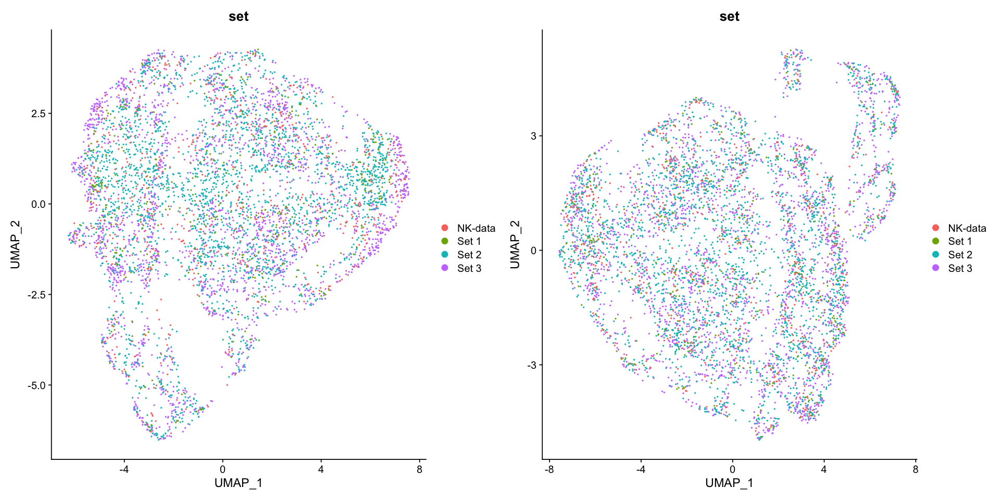

In [33]:
seu.ecto.others <- RunPCA(seu.ecto.others)
seu.ecto.others <- RunHarmony(object = seu.ecto.others, group.by.vars = 'set', assay.use="SCT")
seu.ecto.others <- RunUMAP(seu.ecto.others, dims = 1:30, n.neighbors = 20L, reduction = 'harmony')
seu.ecto.others <- RunUMAP(seu.ecto.others, dims = 1:30, n.neighbors = 20L, reduction = 'pca', reduction.name = 'umapwoharmony')

options(repr.plot.width=16, repr.plot.height=8)
p <- DimPlot(seu.ecto.others, reduction = 'umapwoharmony', group.by = 'set') + DimPlot(seu.ecto.others, reduction = 'umap', group.by = 'set')
plot(p)

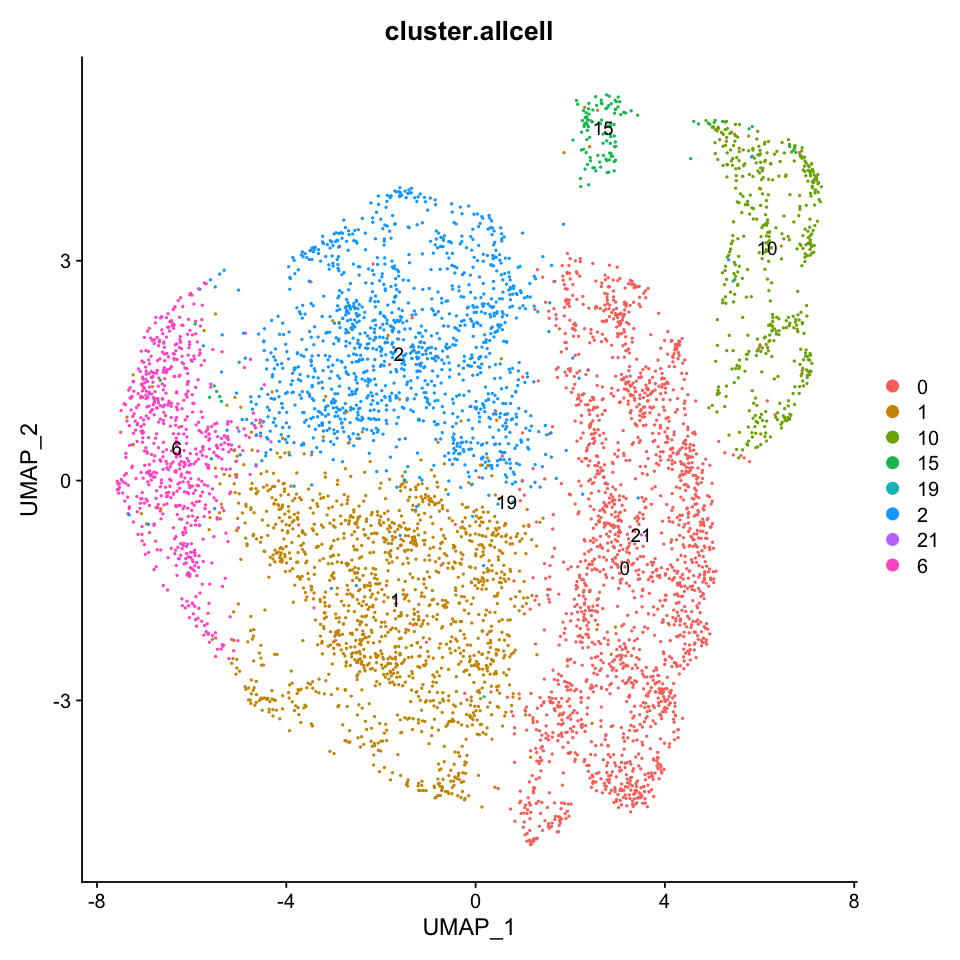

In [34]:
# Seurat clusters on whole embryo clustering
options(repr.plot.width=8, repr.plot.height=8)
p <- DimPlot(seu.ecto.others, reduction = 'umap', group.by = 'cluster.allcell', label = T)
plot(p)
#19&21 were PS1

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5853
Number of edges: 231451

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7843
Number of communities: 14
Elapsed time: 0 seconds


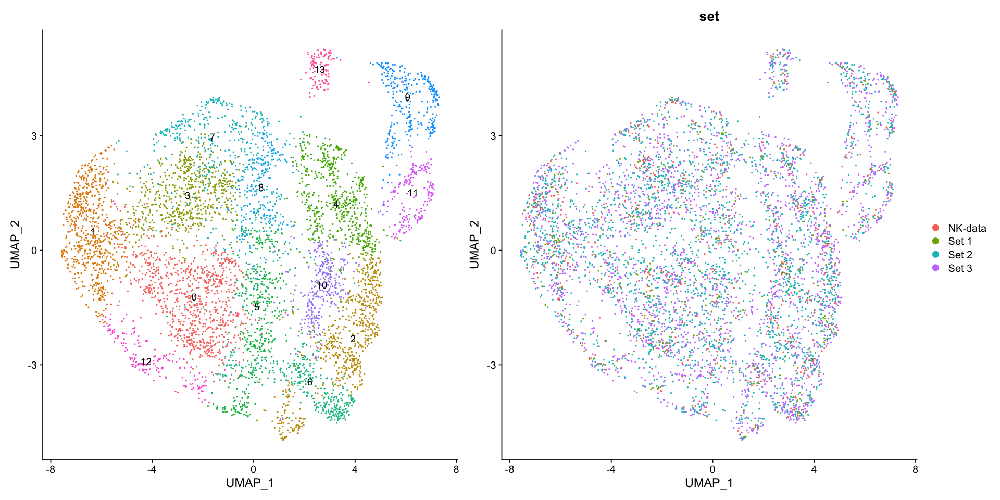

In [35]:
seu.ecto.others <- func.subclustering(seu.ecto.others, resolution = 1.0)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5853
Number of edges: 231451

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.7463
Number of communities: 20
Elapsed time: 0 seconds


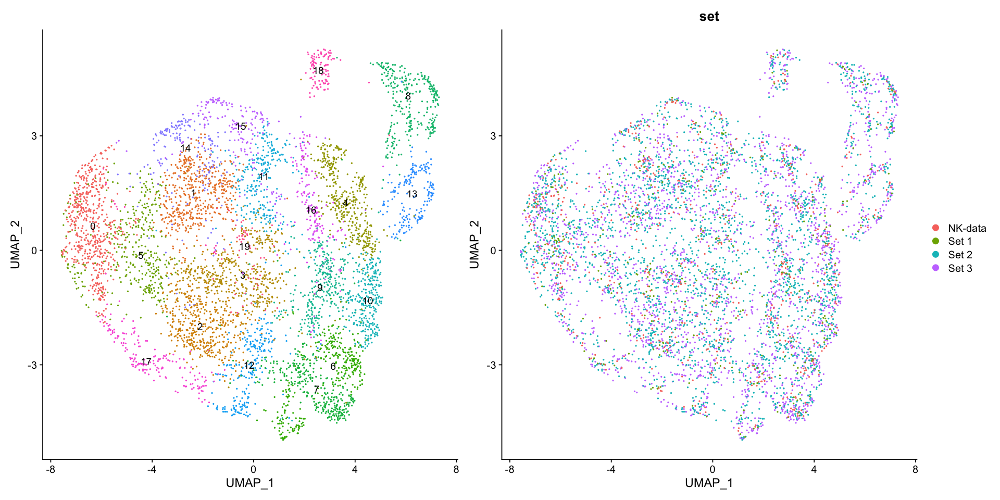

In [36]:
seu.ecto.others <- func.subclustering(seu.ecto.others, resolution = 1.5)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5853
Number of edges: 231451

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.8035
Number of communities: 11
Elapsed time: 0 seconds


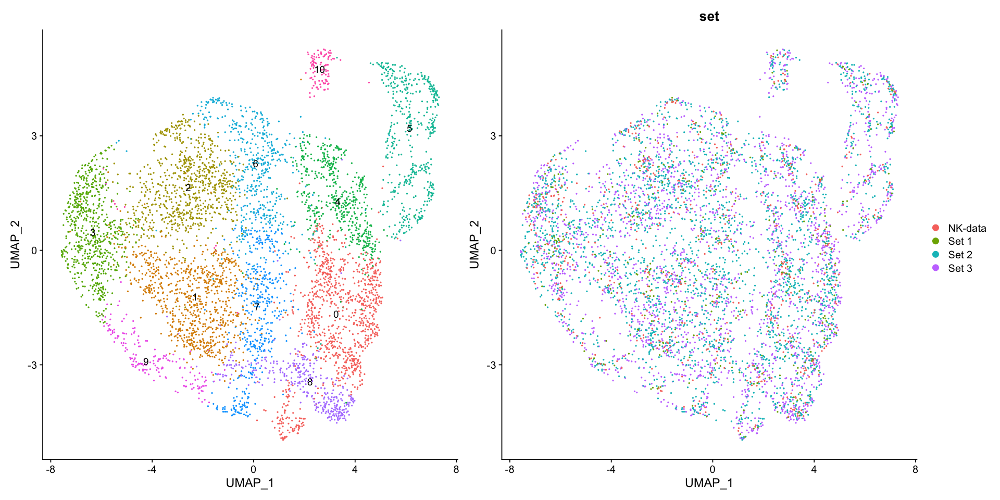

In [37]:
seu.ecto.others <- func.subclustering(seu.ecto.others, resolution = 0.8)

In [38]:
all.markers <- FindAllMarkers(object = seu.ecto.others, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4

Calculating cluster 5

Calculating cluster 6

Calculating cluster 7

Calculating cluster 8

Calculating cluster 9

Calculating cluster 10



[1] 964

[1] 110

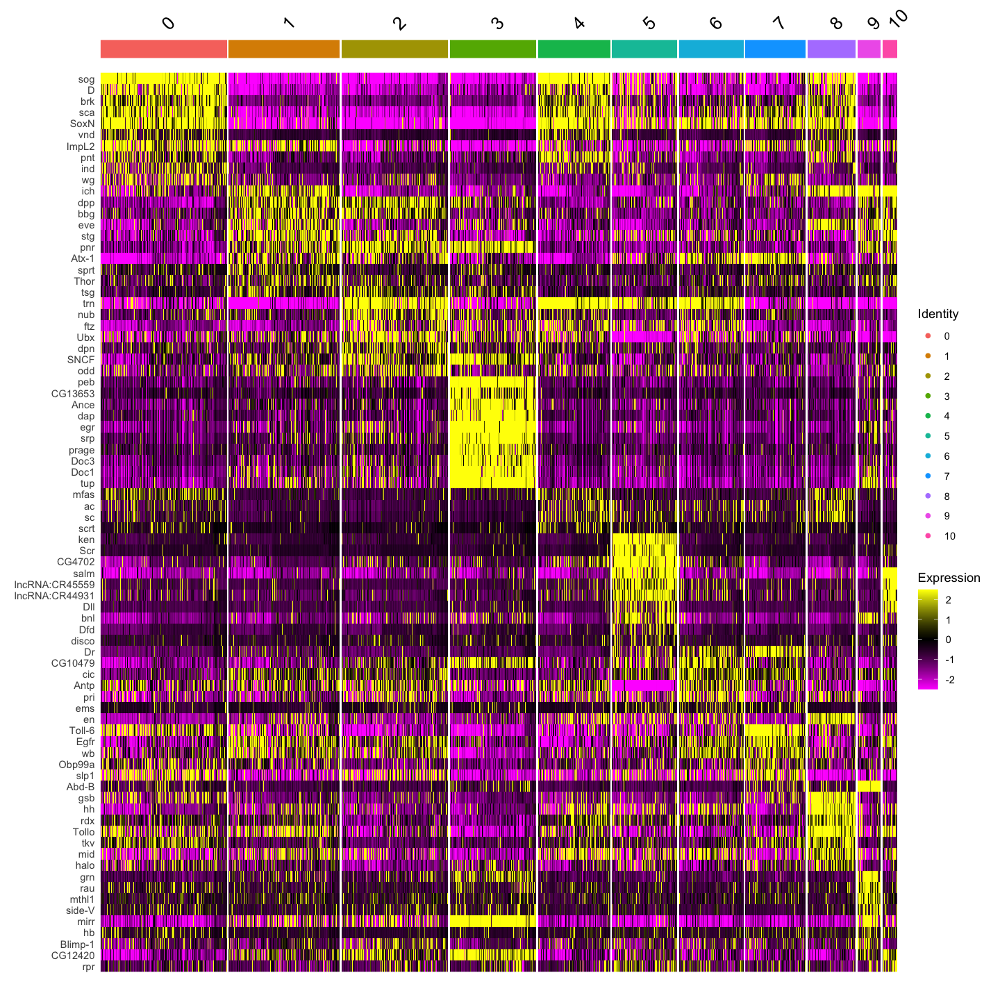

In [39]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto.others, features = c(all.markers.top10$gene))

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 5853
Number of edges: 231451

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.9026
Number of communities: 5
Elapsed time: 0 seconds


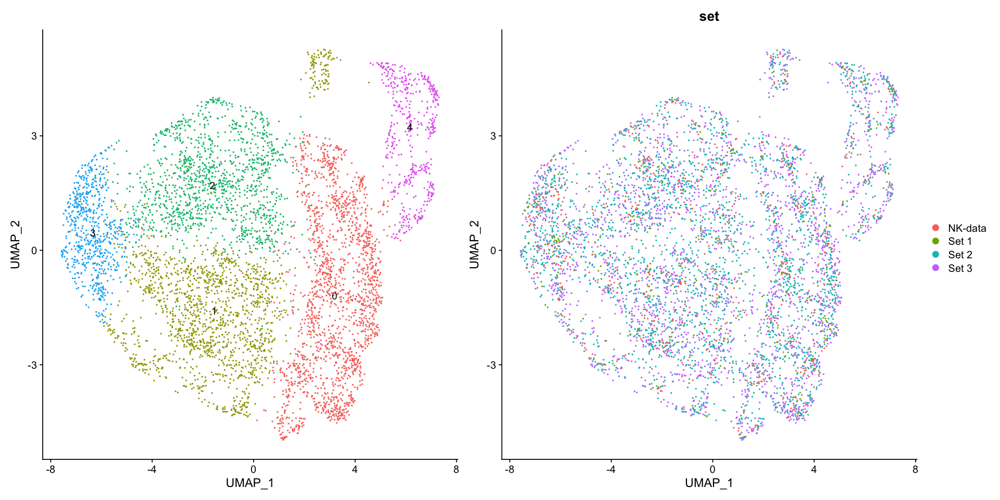

In [40]:
seu.ecto.others <- func.subclustering(seu.ecto.others, resolution = 0.2)

In [41]:
all.markers <- FindAllMarkers(object = seu.ecto.others, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

Calculating cluster 0

Calculating cluster 1

Calculating cluster 2

Calculating cluster 3

Calculating cluster 4



[1] 483

[1] 50

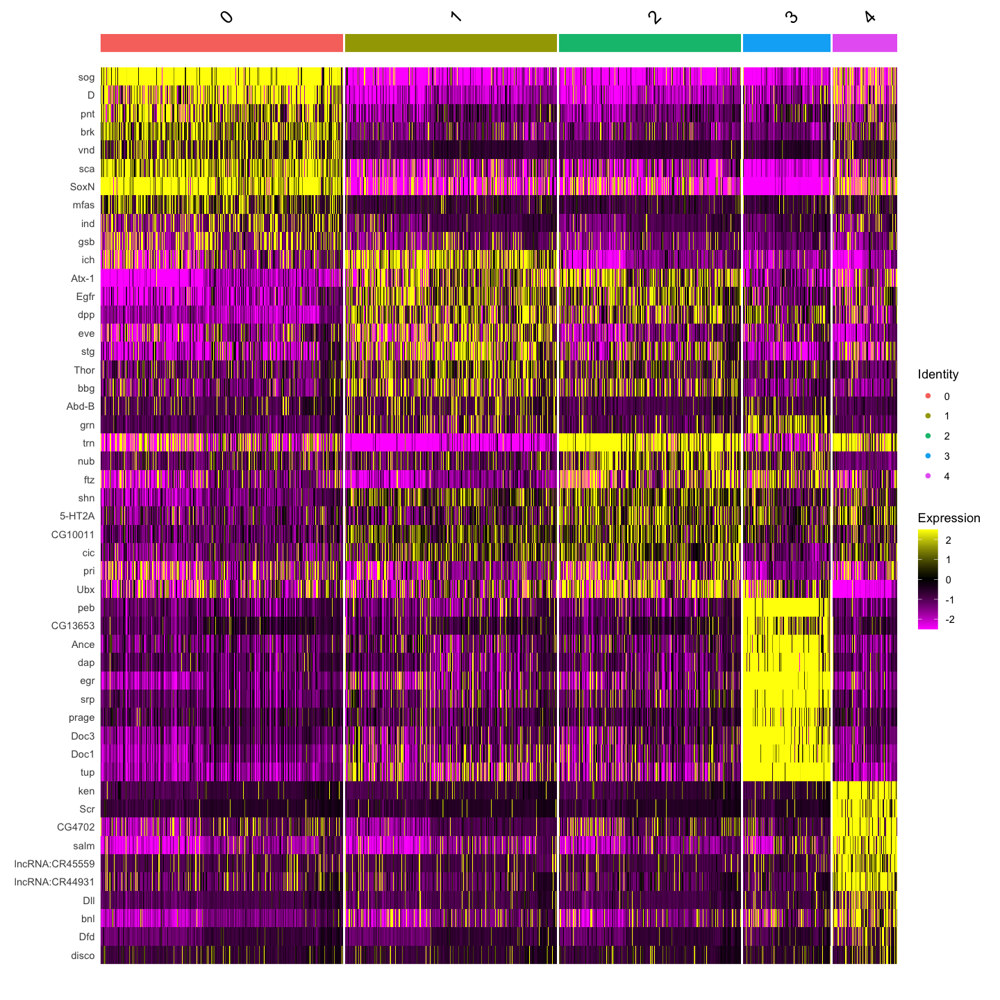

In [42]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto.others, features = c(all.markers.top10$gene))

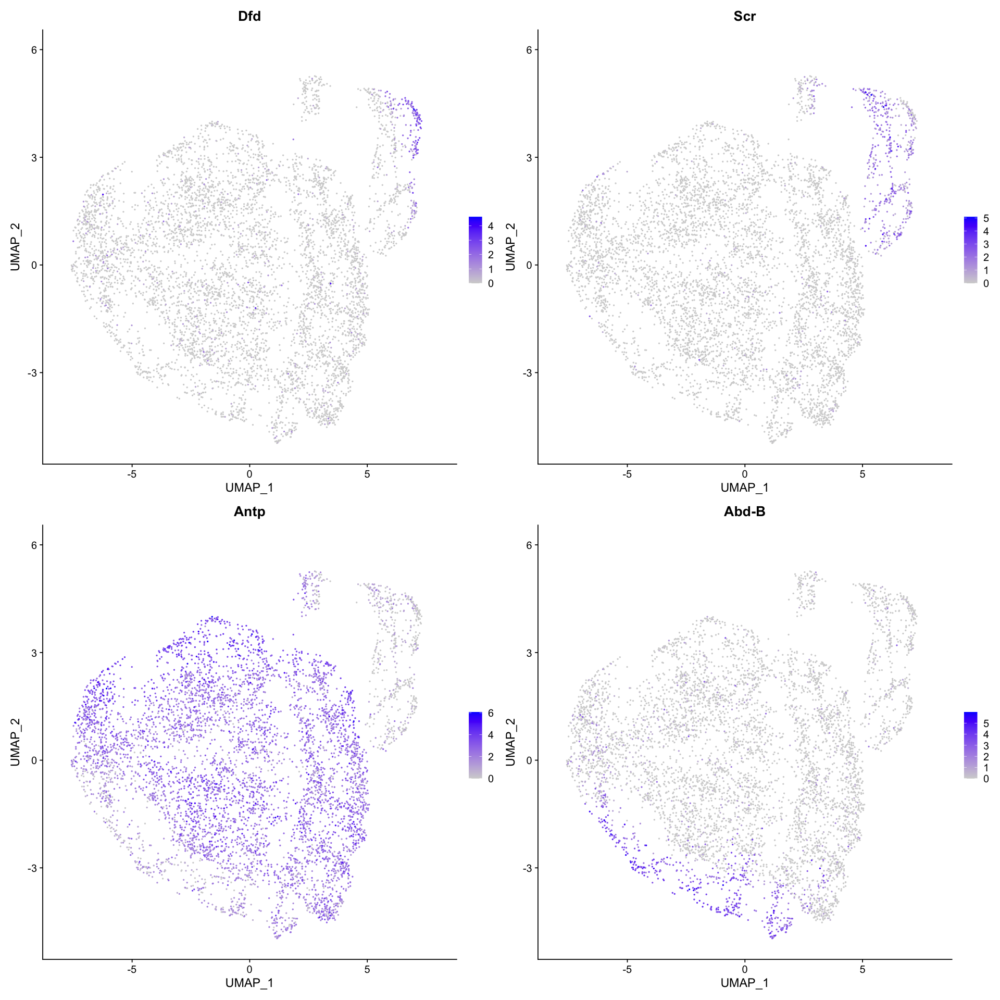

In [43]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto.others, reduction = 'umap', features = c('Dfd','Scr','Antp','Abd-B'))

Failed to separate PS13 (Abd-B+)

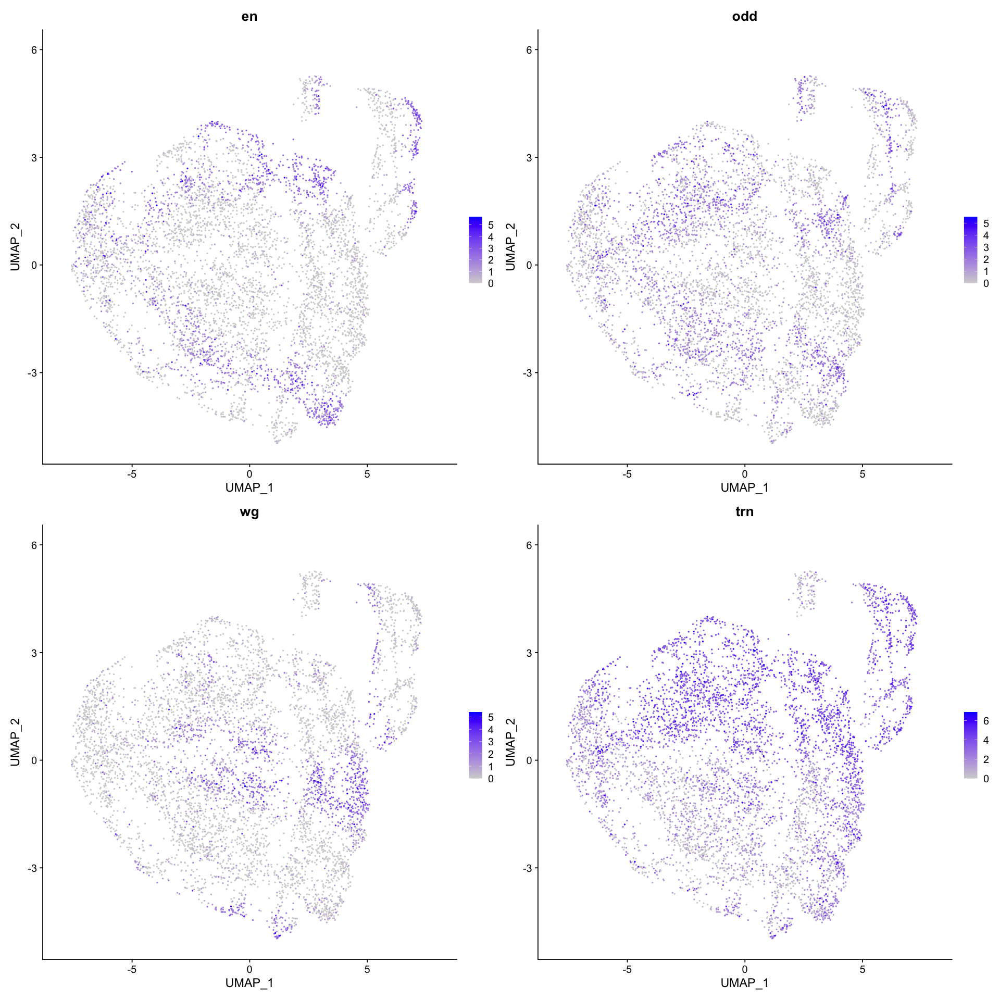

In [44]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ecto.others, reduction = 'umap', features = c('en','odd','wg','trn'))

In [45]:
path = './figures/06_lateral_ecto_subclustering_integrate_all'
for (name in c("trn","eve","en","wg","Dfd", "Scr", "Antp", "Ubx", "abd-A","Abd-B")){
    options(repr.plot.width=8, repr.plot.height=8)
    p <- FeaturePlot(seu.ecto.others, features = name) + theme(plot.title = element_blank())
    basename = paste(name, 'integration_lateral_ecto.eps',sep = '_')
    filename = paste(path, basename, sep = '/')
    ggsave(p, file = filename, width = 8, height = 8)
}

In [46]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto.others, reduction =  "umap", label = TRUE) + NoLegend()
ggsave(fig, file = './figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_seurat_clusters_integration.eps', width = 8, height = 8)

In [47]:
# # Seurat clusters on whole embryo clustering
# options(repr.plot.width=8, repr.plot.height=8)
# p <- DimPlot(seu.ecto.others, reduction = 'umap', group.by = 'cluster.allcell', label = T)
# ggsave(p, file = './figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_seurat_clusters_on_whole_embryo_integration.eps', width = 8, height = 8)
# #19&21 were PS1

### AP annotation

,manual_ID
,<fct>
Set3_CCTCCTCCATTGGATC,1
Set3_TGCGATAGTGAGACCA,4
Set3_CAACGGCAGGATTTGA,4
Set3_CTACATTTCTAGCCTC,1
Set3_TACGCTCCAATCGCAT,4
Set3_AAACCCAAGCAACAAT,2


,manual_ID
,<fct>
Set3_CCTCCTCCATTGGATC,abdominal_odd
Set3_TGCGATAGTGAGACCA,PS2
Set3_CAACGGCAGGATTTGA,PS2
Set3_CTACATTTCTAGCCTC,abdominal_odd
Set3_TACGCTCCAATCGCAT,PS2
Set3_AAACCCAAGCAACAAT,abdominal_even


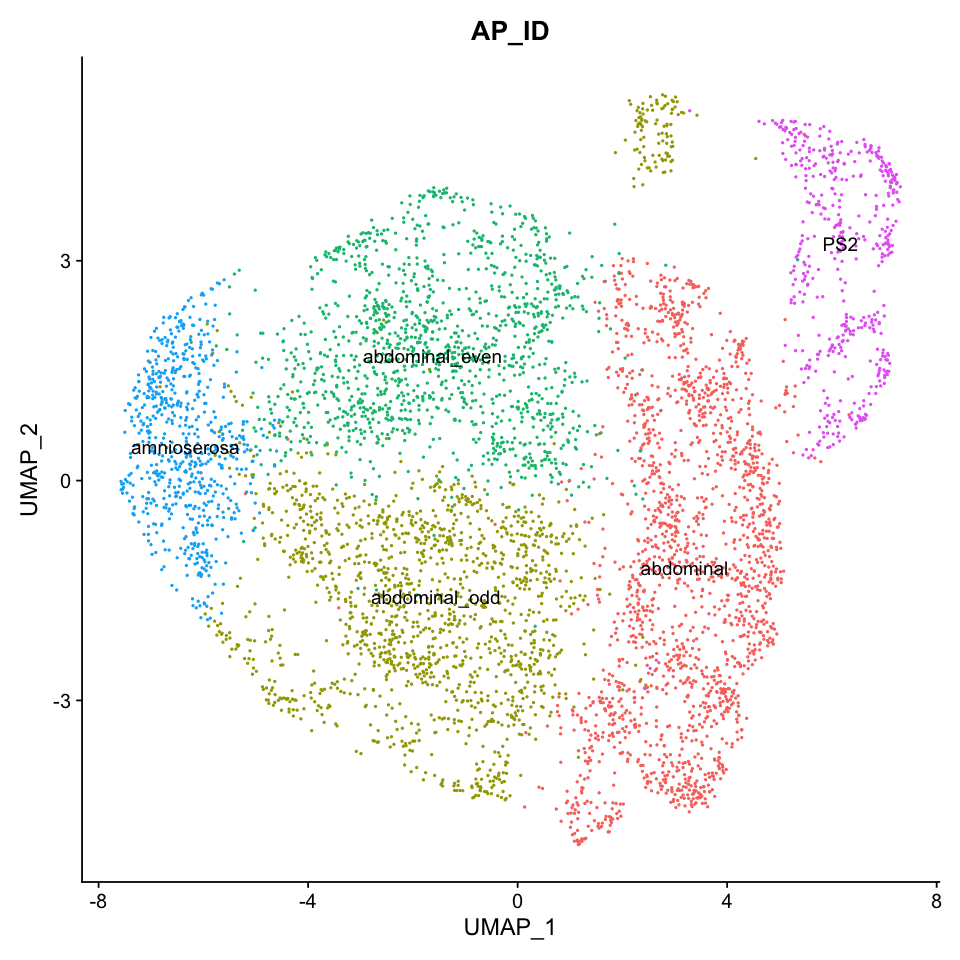

In [48]:
manual_id <- as.data.frame(seu.ecto.others$seurat_clusters)
colnames(manual_id) <- c('manual_ID')
head(manual_id)
manual_id$manual_ID = dplyr::recode(manual_id$manual_ID, 
                                     "0"="abdominal", 
                                     "1"="abdominal_odd",
                                     "2"="abdominal_even",
                                     "3"="amnioserosa",
                                     "4"="PS2"
                                   )
                                    

head(manual_id)
seu.ecto.others$AP_ID <- manual_id
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto.others, reduction = 'umap', label = T, group.by = 'AP_ID') + NoLegend() 

In [49]:
levels <- read.table(file="./lateral_ect_AP_levels_color.txt")
colors <- levels[,2]
levels <- levels[,1]
head(levels)
length(levels)
head(colors)

[1] "PS2"            "abdominal_odd"  "abdominal_even" "abdominal"     
[5] "PS13"           "amnioserosa"

[1] 6

[1] "skyblue3"      "plum3"         "olivedrab3"    "darkslateblue"
[5] "goldenrod3"    "gray75"

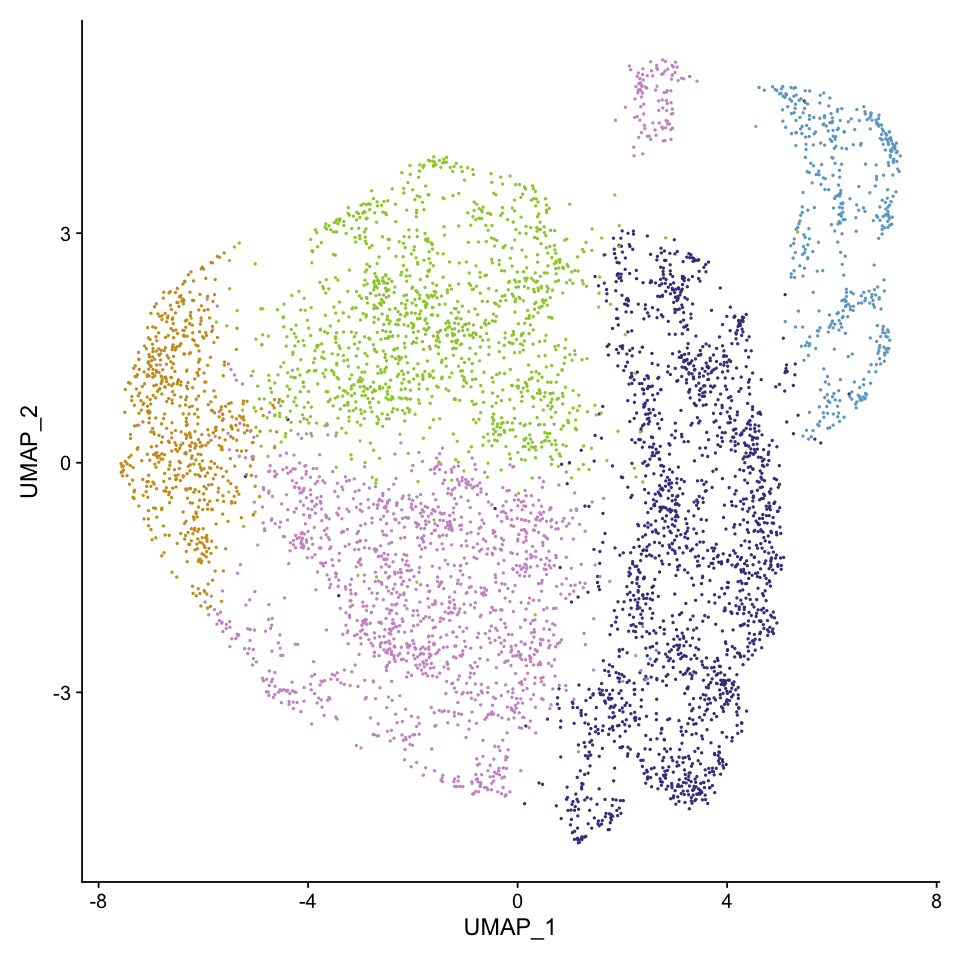

In [50]:
Idents(seu.ecto.others) <- 'AP_ID'
levels(seu.ecto.others) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto.others, reduction =  "umap", label = FALSE, cols = colors) + NoLegend() 
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_umap_AP_IDs.eps", dpi = 300, width =8, height = 8)

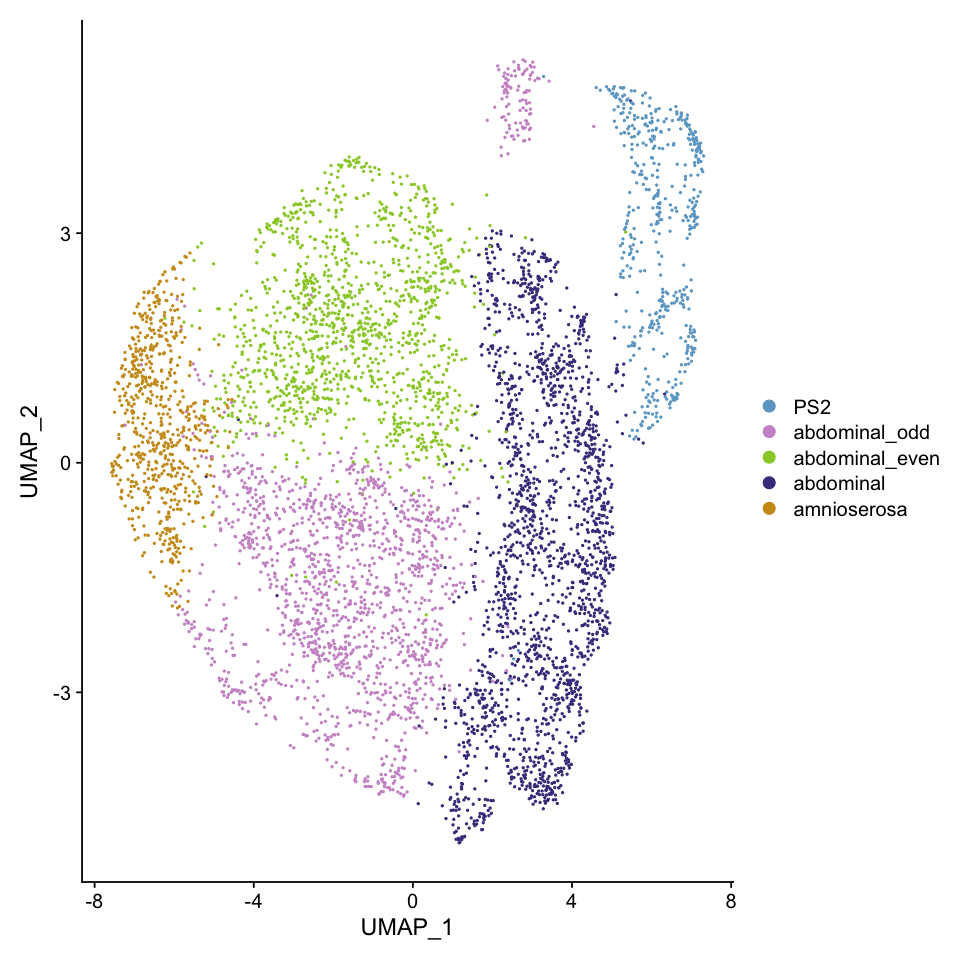

In [51]:
Idents(seu.ecto.others) <- 'AP_ID'
levels(seu.ecto.others) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto.others, reduction =  "umap", label = FALSE, cols = colors)
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_umap2_AP_IDs.eps", dpi = 300, width =8, height = 8)

### DV annotation

In [52]:
DV_genes <- c("rho", "vnd", "pnt", "ind", "sog", "SoxN", "brk", "dpp", "Egfr", "vn", "pnt",
              "Atx-1", "egr", "cv-2", "Doc1", "Ance", "Dr", "emc", "cic",
              "mirr", "ush", "Ama", "bbg", "tup", "zen", "Doc2", "Z600", "C15", "peb",
             "Dtg", "CG13653", "Doc3", "dap","srp", "stg")

In [53]:
norm.count.data <- t(as.matrix(GetAssayData(seu.ecto.others))[DV_genes,])
colnames(norm.count.data) <- 1:dim(norm.count.data)[2]
# Preparation for Harmony
seu.ecto.others@reductions$dv_genes <- CreateDimReducObject(norm.count.data, key = 'DV', assay = DefaultAssay(seu.ecto.others))
# Run Harmony
seu.ecto.others <- RunHarmony(object = seu.ecto.others, group.by.vars = 'set', assay.use="SCT", reduction = 'dv_genes')

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from DV to DV_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to DV_”
Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony converged after 3 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.SCT.harmony; see ?make.names for more details on syntax validity”


In [54]:
norm.count.ecto.dv.genes <- as.matrix(Embeddings(seu.ecto.others, reduction = 'harmony'))
head(norm.count.ecto.dv.genes)

,harmony_1,harmony_2,harmony_3,harmony_4,harmony_5,harmony_6,harmony_7,harmony_8,harmony_9,harmony_10,⋯,harmony_26,harmony_27,harmony_28,harmony_29,harmony_30,harmony_31,harmony_32,harmony_33,harmony_34,harmony_35
Set3_CCTCCTCCATTGGATC,1.4218283,0.038958971,1.3277870,-0.07478519,2.46559252,4.4260728766,1.43404694,0.4424863,3.412664,0.74551342,⋯,0.007432665,1.3108937,0.02246629,1.46657647,2.038780,0.09931728,1.08463843,0.1403373,0.1400505,2.9790604
Set3_TGCGATAGTGAGACCA,0.3172734,0.032569231,0.2397900,-0.06267229,1.87530408,4.0643767543,1.02312545,1.1605450,2.944598,0.05342234,⋯,0.007686039,0.3920204,0.02293135,0.08020415,1.806420,0.09876690,-0.01400953,0.1408182,0.1428815,0.9050083
Set3_CAACGGCAGGATTTGA,0.9777988,0.012314462,0.1782870,-0.05778239,0.74635494,1.5869316024,0.09742294,1.8586592,2.058735,0.14911944,⋯,2.086049369,-0.5867711,0.32019907,0.23041102,2.773959,1.18360537,1.16840409,2.6335831,0.5055897,0.6223893
Set3_CTACATTTCTAGCCTC,2.9798225,0.012696115,0.8681742,-0.05427633,0.04770039,-0.0312720291,0.09202924,2.8640195,1.965852,3.29143612,⋯,1.249467828,1.2043139,1.44416543,0.93623979,2.940342,1.31666468,0.87043261,2.5434496,1.2144752,3.1109549
Set3_TACGCTCCAATCGCAT,3.6813625,0.009200149,1.5792747,-0.08079836,0.08176642,1.6380835835,0.10929354,2.2963393,2.546849,0.12103117,⋯,0.786097911,1.9534483,0.20413304,0.17733061,2.698959,-0.17692830,1.19177614,1.4075225,0.4557138,3.8651651
Set3_AAACCCAAGCAACAAT,3.1978065,0.010817638,0.1834525,-0.06920766,0.06426980,-0.0004491189,0.09616208,2.0935517,1.531053,0.14141602,⋯,0.818557571,0.4907496,0.28147588,0.21564043,2.895813,0.36388394,1.16235280,0.3937062,0.4998635,0.6239642


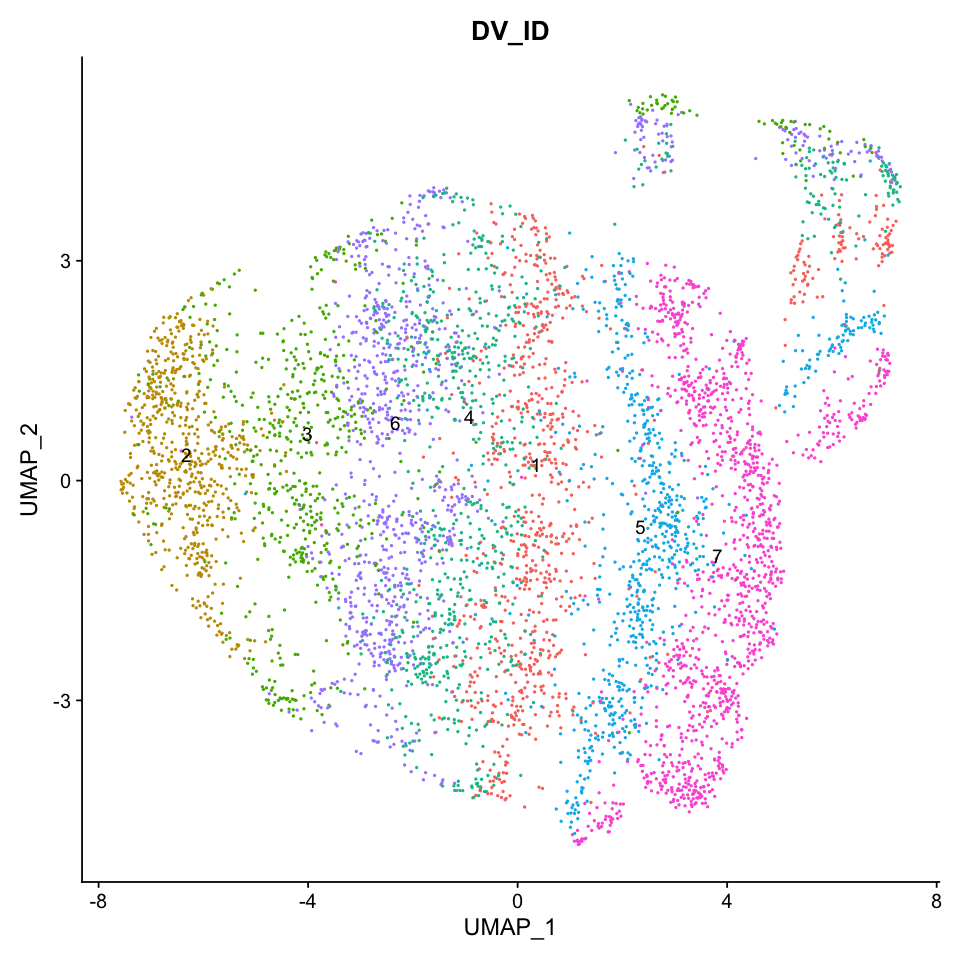

In [55]:
set.seed(0)
trunk_ect_DV_cluster <- kmeans(x=norm.count.ecto.dv.genes, centers=7)
seu.ecto.others$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto.others, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

In [56]:
Idents(seu.ecto.others) <- 'DV_ID'
levels <- c(7,5,1,4,6,3,2)
levels(seu.ecto.others) <- levels
all.markers.ecto <- FindAllMarkers(object = seu.ecto.others, only.pos = TRUE)
nrow(all.markers.ecto)
all.markers.ecto.top10 <- all.markers.ecto %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.ecto.top10)

Calculating cluster 7

Calculating cluster 5

Calculating cluster 1

Calculating cluster 4

Calculating cluster 6

Calculating cluster 3

Calculating cluster 2



[1] 639

[1] 70

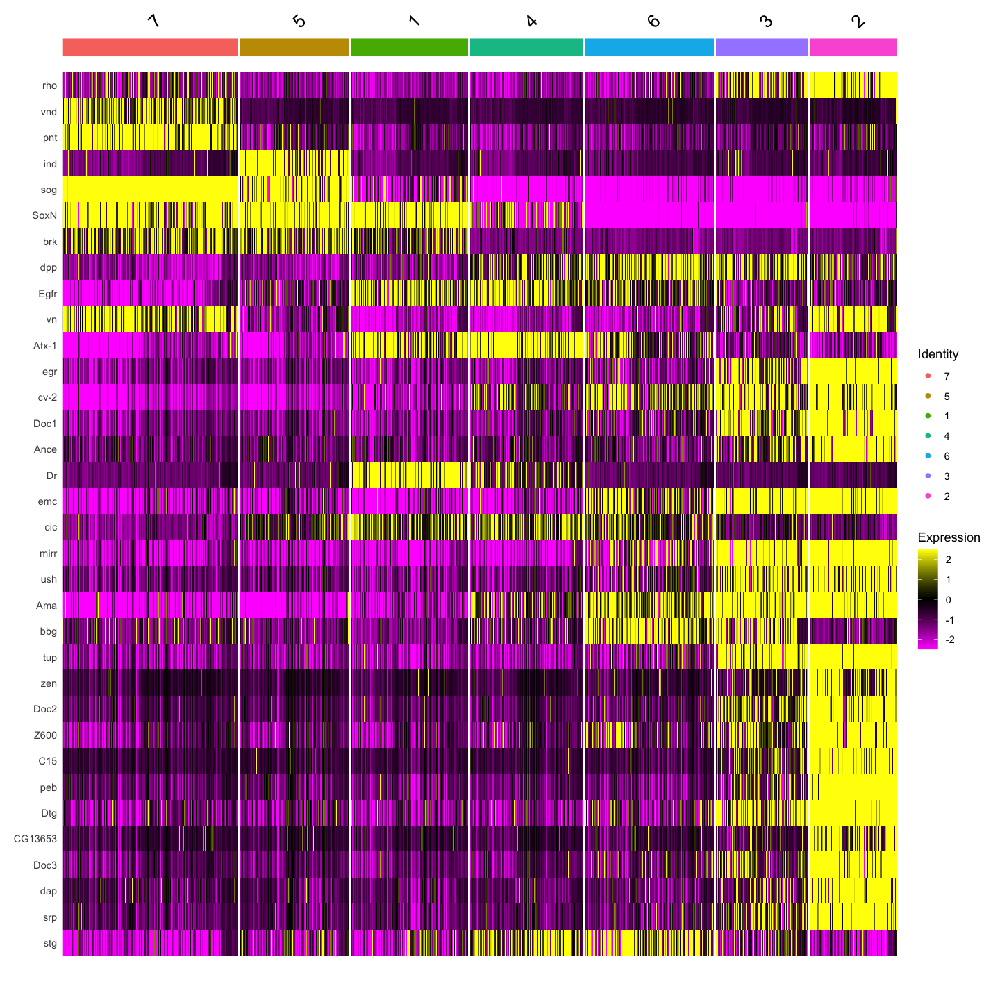

In [57]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto.others, features = DV_genes)

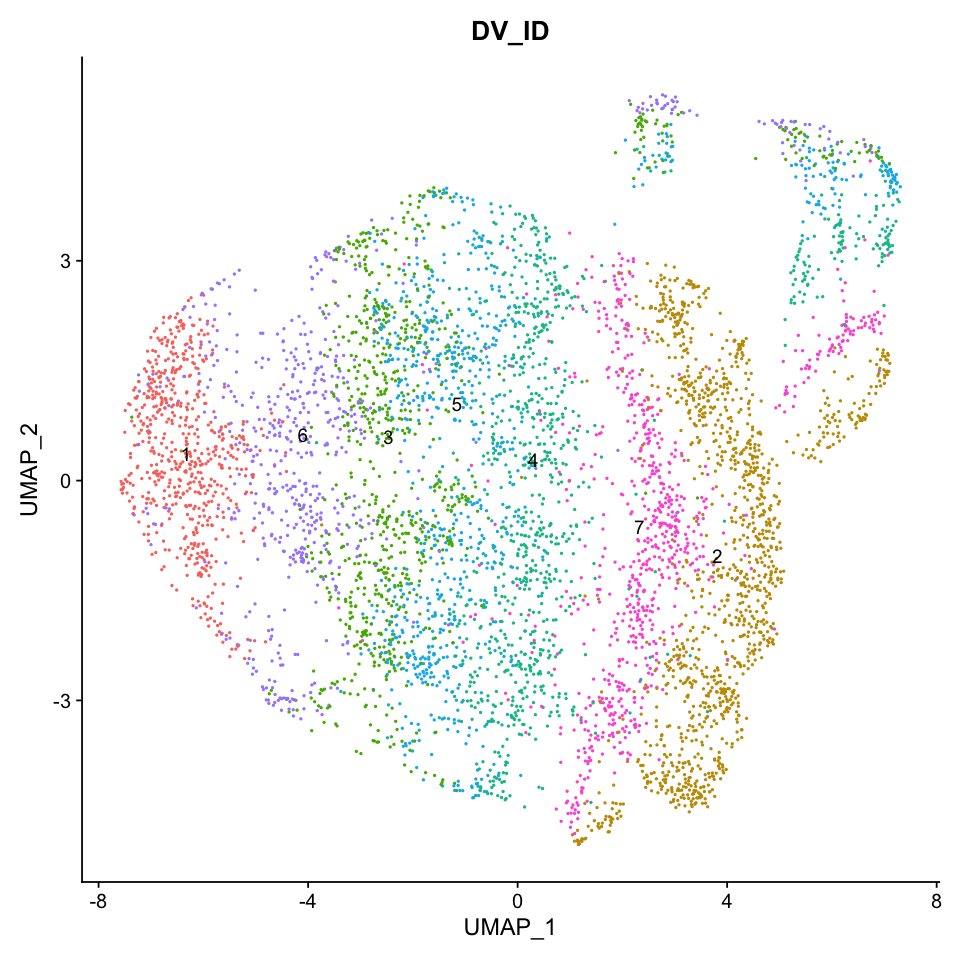

In [58]:
set.seed(2)
trunk_ect_DV_cluster <- kmeans(x=norm.count.ecto.dv.genes, centers=7)
seu.ecto.others$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto.others, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

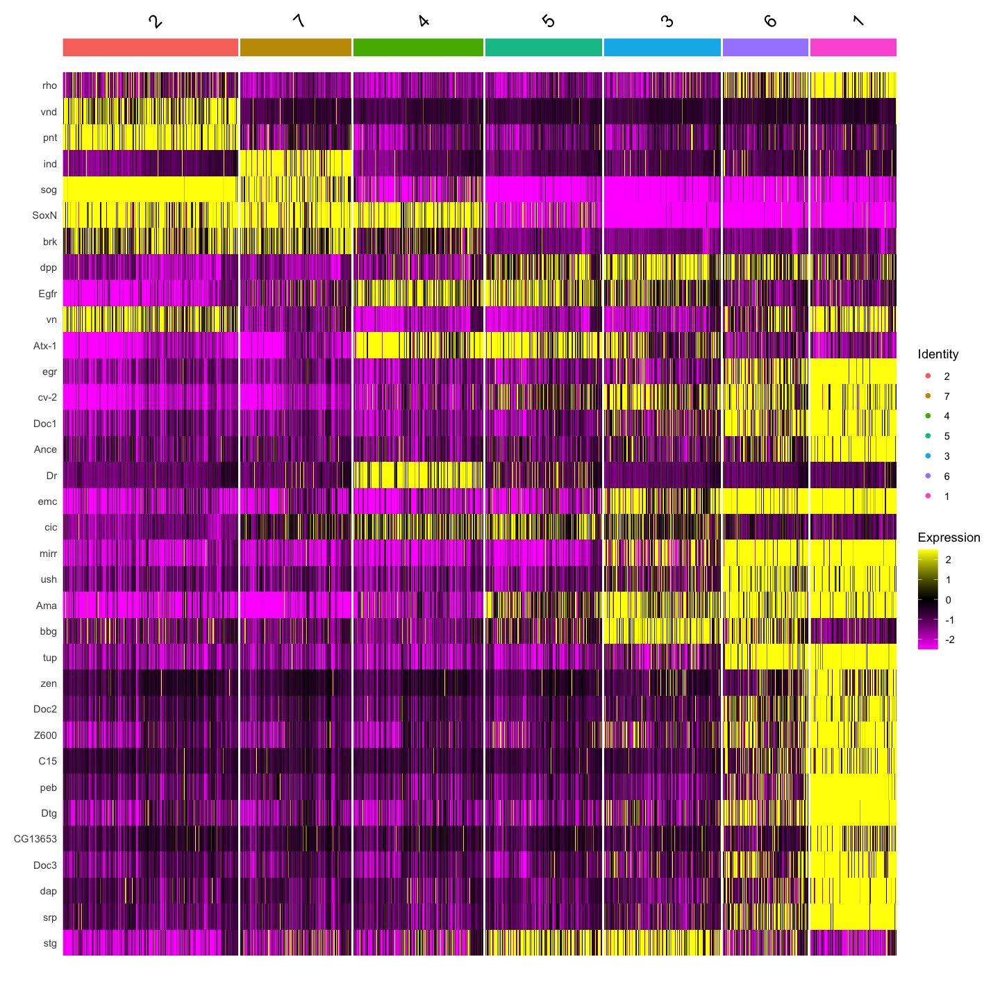

In [59]:
Idents(seu.ecto.others) <- 'DV_ID'
levels <- c(2,7,4,5,3,6,1)
levels(seu.ecto.others) <- levels
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ecto.others, features = DV_genes)

,manual_ID
,<int>
Set3_CCTCCTCCATTGGATC,4
Set3_TGCGATAGTGAGACCA,4
Set3_CAACGGCAGGATTTGA,6
Set3_CTACATTTCTAGCCTC,6
Set3_TACGCTCCAATCGCAT,6
Set3_AAACCCAAGCAACAAT,6


,manual_ID
,<chr>
Set3_CCTCCTCCATTGGATC,ectoderm_lateral_NE
Set3_TGCGATAGTGAGACCA,ectoderm_lateral_NE
Set3_CAACGGCAGGATTTGA,ectoderm_medial_DE
Set3_CTACATTTCTAGCCTC,ectoderm_medial_DE
Set3_TACGCTCCAATCGCAT,ectoderm_medial_DE
Set3_AAACCCAAGCAACAAT,ectoderm_medial_DE


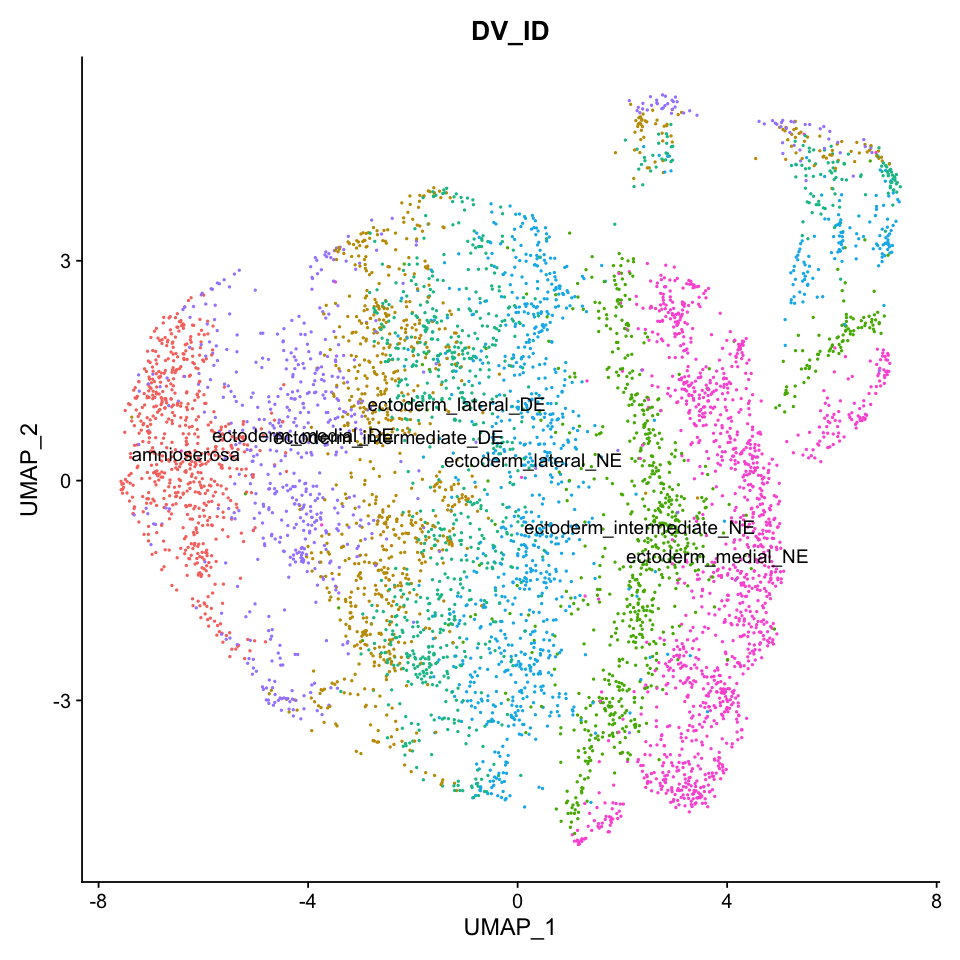

In [60]:
manual_id <- as.data.frame(seu.ecto.others$DV_ID)
colnames(manual_id) <- c('manual_ID')
head(manual_id)
manual_id$manual_ID = dplyr::recode(manual_id$manual_ID, 
                                     "2"="ectoderm_medial_NE", 
                                     "7"="ectoderm_intermediate_NE",
                                     "4"="ectoderm_lateral_NE",
                                     "5"="ectoderm_lateral_DE",
                                     "3"="ectoderm_intermediate_DE",
                                     "6"="ectoderm_medial_DE",
                                     "1"="amnioserosa",
                                   )
                                    

head(manual_id)
seu.ecto.others$DV_ID <- manual_id
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto.others, reduction = 'umap', label = T, group.by = 'DV_ID') + NoLegend() 

In [61]:
levels <- read.table(file="./lateral_ect_DV_levels_color.txt")
colors <- levels[,2]
levels <- levels[,1]
head(levels)
length(levels)
head(colors)

[1] "ectoderm_medial_DE"       "ectoderm_intermediate_DE"
[3] "ectoderm_lateral_DE"      "ectoderm_lateral_NE"     
[5] "ectoderm_intermediate_NE" "ectoderm_medial_NE"

[1] 7

[1] "skyblue3"   "olivedrab2" "olivedrab4" "goldenrod3" "plum1"     
[6] "plum4"

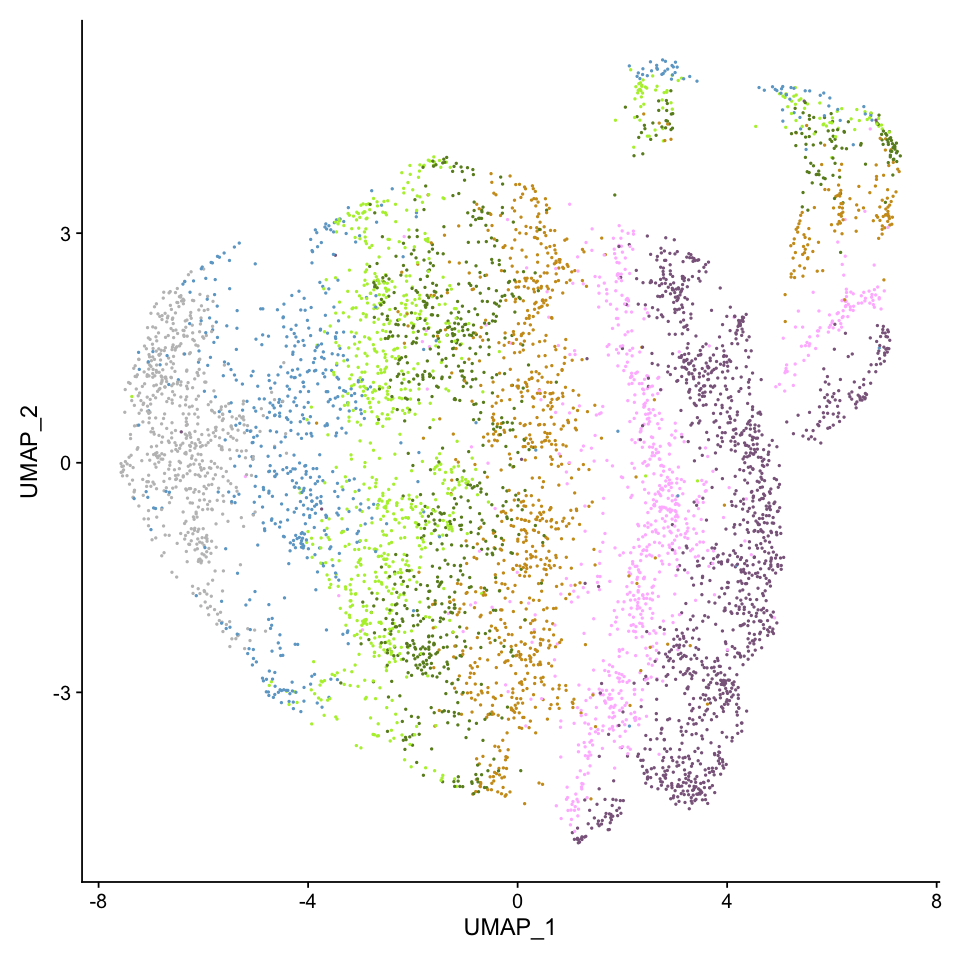

In [62]:
Idents(seu.ecto.others) <- 'DV_ID'
levels(seu.ecto.others) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto.others, reduction =  "umap", label = FALSE, cols = colors) + NoLegend() 
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_umap_DV_IDs.eps", dpi = 300, width =8, height = 8)

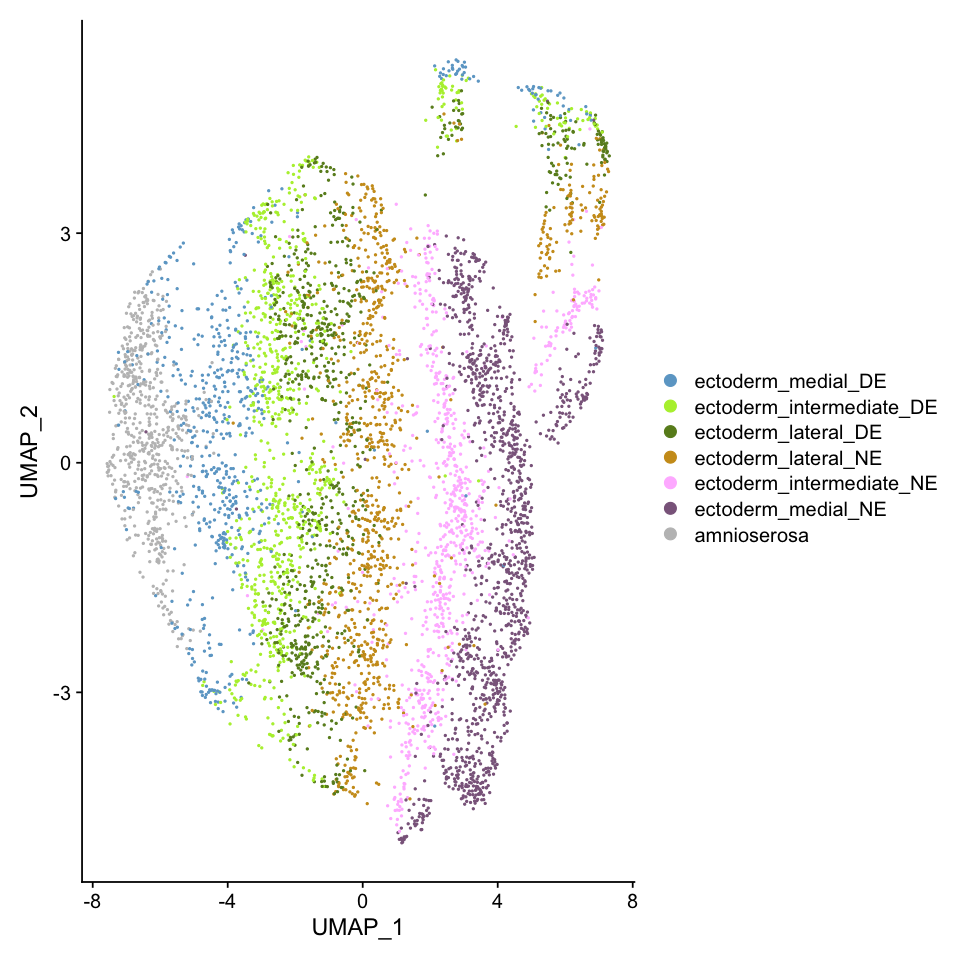

In [63]:
Idents(seu.ecto.others) <- 'DV_ID'
levels(seu.ecto.others) <- levels
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto.others, reduction =  "umap", label = FALSE, cols = colors) 
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_umap2_DV_IDs.eps", dpi = 300, width =8, height = 8)

### Merge AP and DV ID

In [64]:
table(seu.ecto.others@meta.data[c('DV_ID','AP_ID')])

                          AP_ID
DV_ID                      abdominal abdominal_odd abdominal_even amnioserosa
  amnioserosa                      0            30              8         577
  ectoderm_intermediate_DE         2           432            352           1
  ectoderm_intermediate_NE       621            40             48           0
  ectoderm_lateral_DE              0           385            347           0
  ectoderm_lateral_NE             31           400            378           0
  ectoderm_medial_DE               4           283            212          74
  ectoderm_medial_NE            1144             2              5           1
                          AP_ID
DV_ID                       PS2
  amnioserosa                 0
  ectoderm_intermediate_DE   46
  ectoderm_intermediate_NE   83
  ectoderm_lateral_DE        98
  ectoderm_lateral_NE       119
  ectoderm_medial_DE         35
  ectoderm_medial_NE         95

In [65]:
merged.id <- as.data.frame(paste(seu.ecto.others$DV_ID, seu.ecto.others$AP_ID,sep = '_'))
colnames(merged.id) <- c('manual_ID')
row.names(merged.id) <- colnames(seu.ecto.others)
head(merged.id)

,manual_ID
,<chr>
Set3_CCTCCTCCATTGGATC,ectoderm_lateral_NE_abdominal_odd
Set3_TGCGATAGTGAGACCA,ectoderm_lateral_NE_PS2
Set3_CAACGGCAGGATTTGA,ectoderm_medial_DE_PS2
Set3_CTACATTTCTAGCCTC,ectoderm_medial_DE_abdominal_odd
Set3_TACGCTCCAATCGCAT,ectoderm_medial_DE_PS2
Set3_AAACCCAAGCAACAAT,ectoderm_medial_DE_abdominal_even


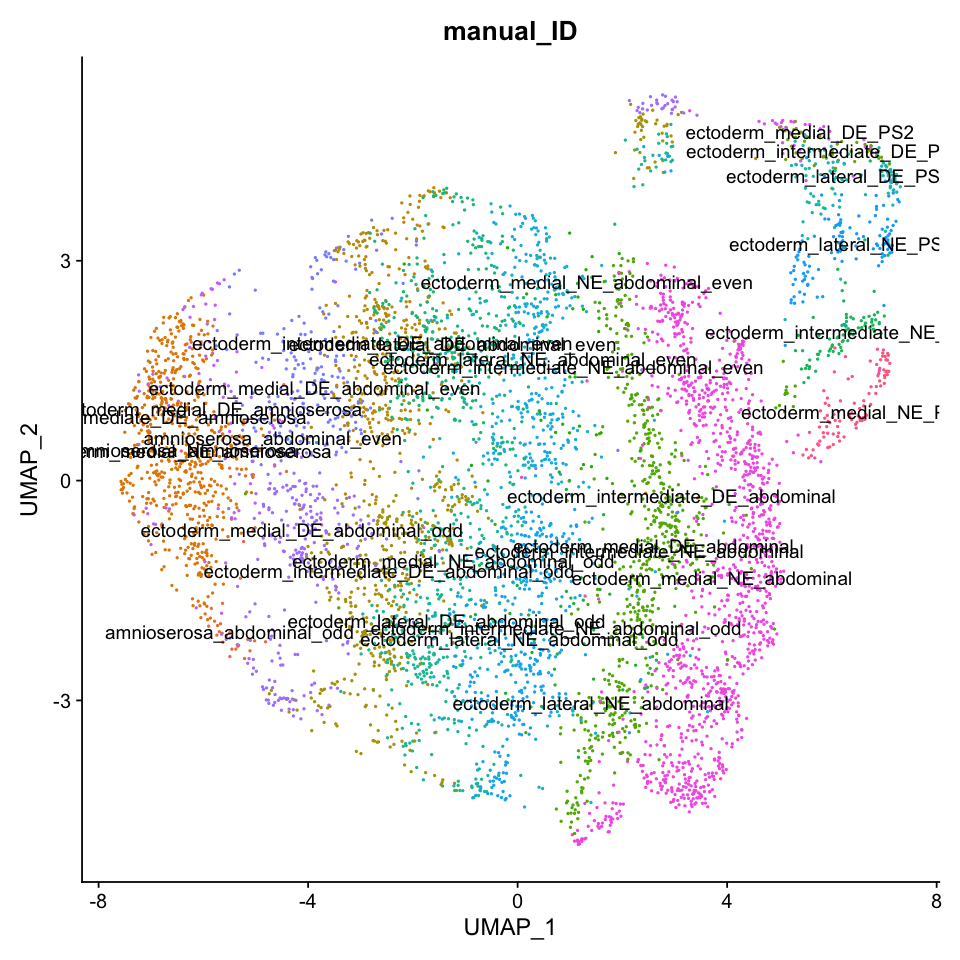

In [66]:
seu.ecto.others$manual_ID <- merged.id$manual_ID
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto.others, reduction = 'umap', group.by = 'manual_ID',label = TRUE) + NoLegend()

In [67]:
merged.id$manual_ID <- gsub('amnioserosa_abdominal_odd','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('amnioserosa_abdominal_even','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('amnioserosa_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('ectoderm_medial_DE_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('ectoderm_intermediate_NE_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('ectoderm_medial_NE_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)
merged.id$manual_ID <- gsub('ectoderm_intermediate_DE_amnioserosa','amnioserosa_trunk', merged.id$manual_ID)

merged.id$manual_ID <- gsub('abdominal_odd','abdominal', merged.id$manual_ID)
merged.id$manual_ID <- gsub('abdominal_even','abdominal', merged.id$manual_ID)

In [68]:
unique(merged.id$manual_ID)

[1] "ectoderm_lateral_NE_abdominal"      "ectoderm_lateral_NE_PS2"           
 [3] "ectoderm_medial_DE_PS2"             "ectoderm_medial_DE_abdominal"      
 [5] "ectoderm_medial_NE_abdominal"       "amnioserosa_trunk"                 
 [7] "ectoderm_intermediate_DE_abdominal" "ectoderm_intermediate_DE_PS2"      
 [9] "ectoderm_lateral_DE_abdominal"      "ectoderm_intermediate_NE_abdominal"
[11] "ectoderm_intermediate_NE_PS2"       "ectoderm_medial_NE_PS2"            
[13] "ectoderm_lateral_DE_PS2"

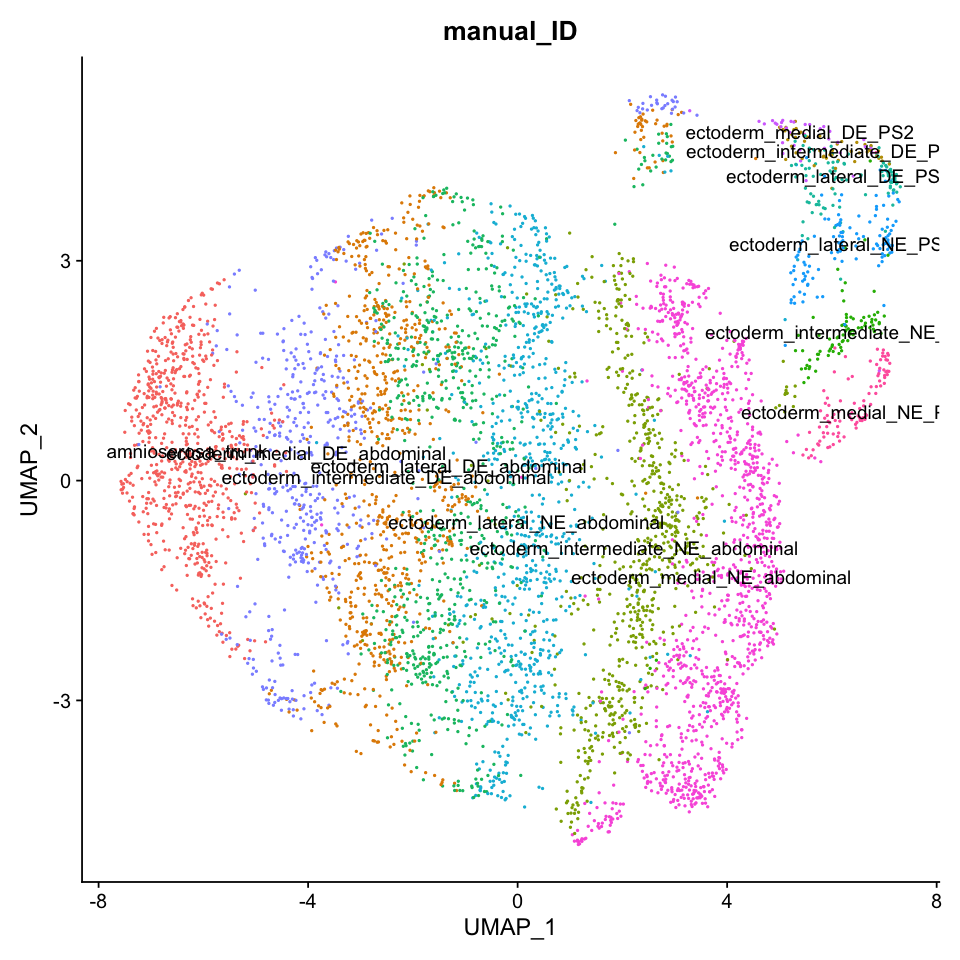

In [69]:
seu.ecto.others$manual_ID <- merged.id$manual_ID
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto.others, reduction = 'umap', group.by = 'manual_ID',label = TRUE) + NoLegend()

In [70]:
levels.lateral.ecto <- c('ectoderm_medial_DE_PS2','ectoderm_intermediate_DE_PS2','ectoderm_lateral_DE_PS2',
                         'ectoderm_lateral_NE_PS2','ectoderm_intermediate_NE_PS2','ectoderm_medial_NE_PS2',
                        'ectoderm_medial_DE_abdominal','ectoderm_intermediate_DE_abdominal',
                         'ectoderm_lateral_DE_abdominal',
                         'ectoderm_lateral_NE_abdominal',
                         'ectoderm_intermediate_NE_abdominal','ectoderm_medial_NE_abdominal','amnioserosa_trunk')
Idents(seu.ecto.others) <- 'manual_ID'
levels(seu.ecto.others) <- levels.lateral.ecto
levels(seu.ecto.others) 
all.markers <- FindAllMarkers(object = seu.ecto.others, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

[1] "ectoderm_medial_DE_PS2"             "ectoderm_intermediate_DE_PS2"      
 [3] "ectoderm_lateral_DE_PS2"            "ectoderm_lateral_NE_PS2"           
 [5] "ectoderm_intermediate_NE_PS2"       "ectoderm_medial_NE_PS2"            
 [7] "ectoderm_medial_DE_abdominal"       "ectoderm_intermediate_DE_abdominal"
 [9] "ectoderm_lateral_DE_abdominal"      "ectoderm_lateral_NE_abdominal"     
[11] "ectoderm_intermediate_NE_abdominal" "ectoderm_medial_NE_abdominal"      
[13] "amnioserosa_trunk"

Calculating cluster ectoderm_medial_DE_PS2

Calculating cluster ectoderm_intermediate_DE_PS2

Calculating cluster ectoderm_lateral_DE_PS2

Calculating cluster ectoderm_lateral_NE_PS2

Calculating cluster ectoderm_intermediate_NE_PS2

Calculating cluster ectoderm_medial_NE_PS2

Calculating cluster ectoderm_medial_DE_abdominal

Calculating cluster ectoderm_intermediate_DE_abdominal

Calculating cluster ectoderm_lateral_DE_abdominal

Calculating cluster ectoderm_lateral_NE_abdominal

Calculating cluster ectoderm_intermediate_NE_abdominal

Calculating cluster ectoderm_medial_NE_abdominal

Calculating cluster amnioserosa_trunk



[1] 1171

[1] 130

Saving 7 x 7 in image



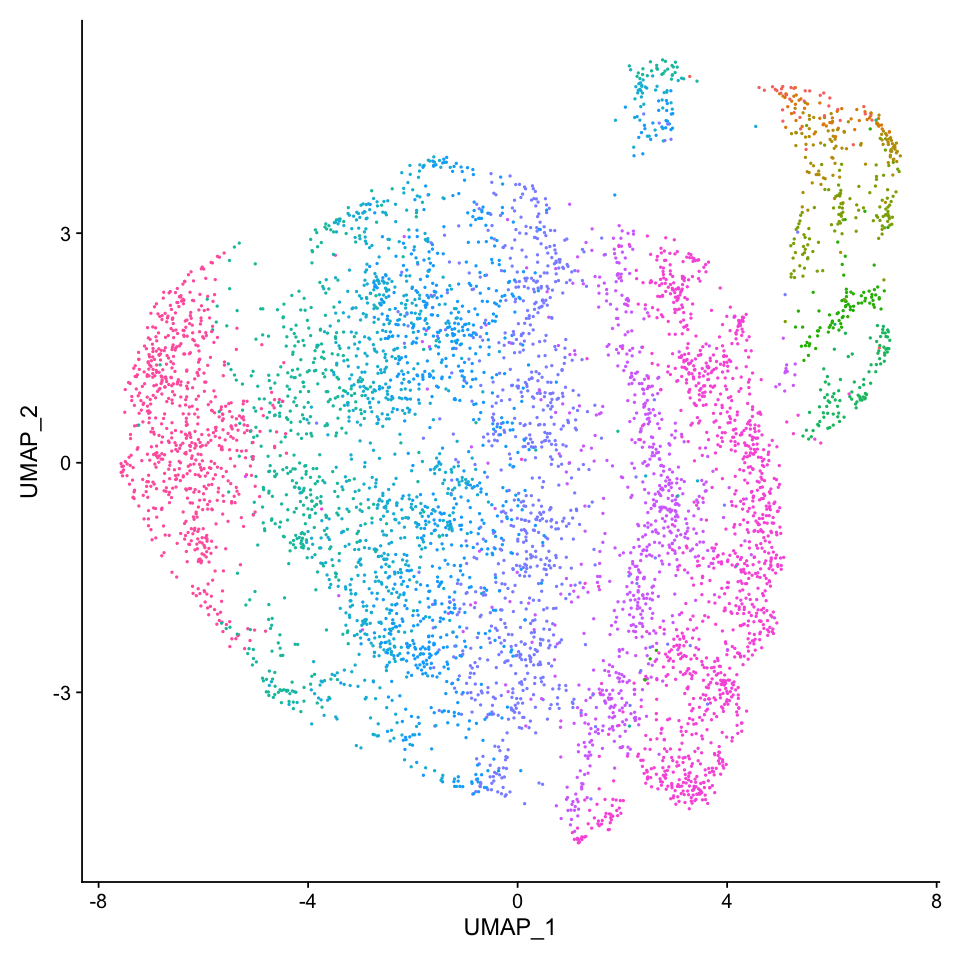

In [71]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto.others, reduction =  "umap", label = FALSE) + NoLegend() 
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_umap1.eps", dpi = 300)

Saving 12 x 7 in image



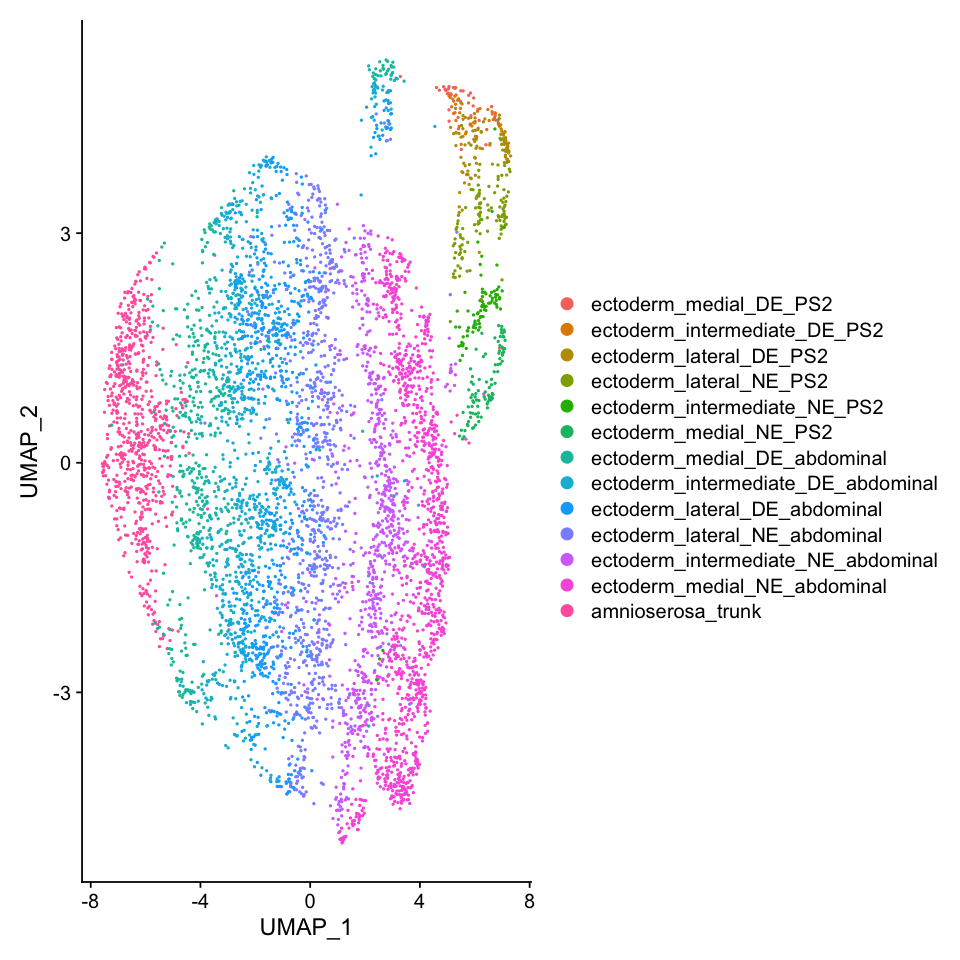

In [72]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto.others, reduction =  "umap", label = FALSE)
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_umap2.eps", dpi = 300, width = 12)

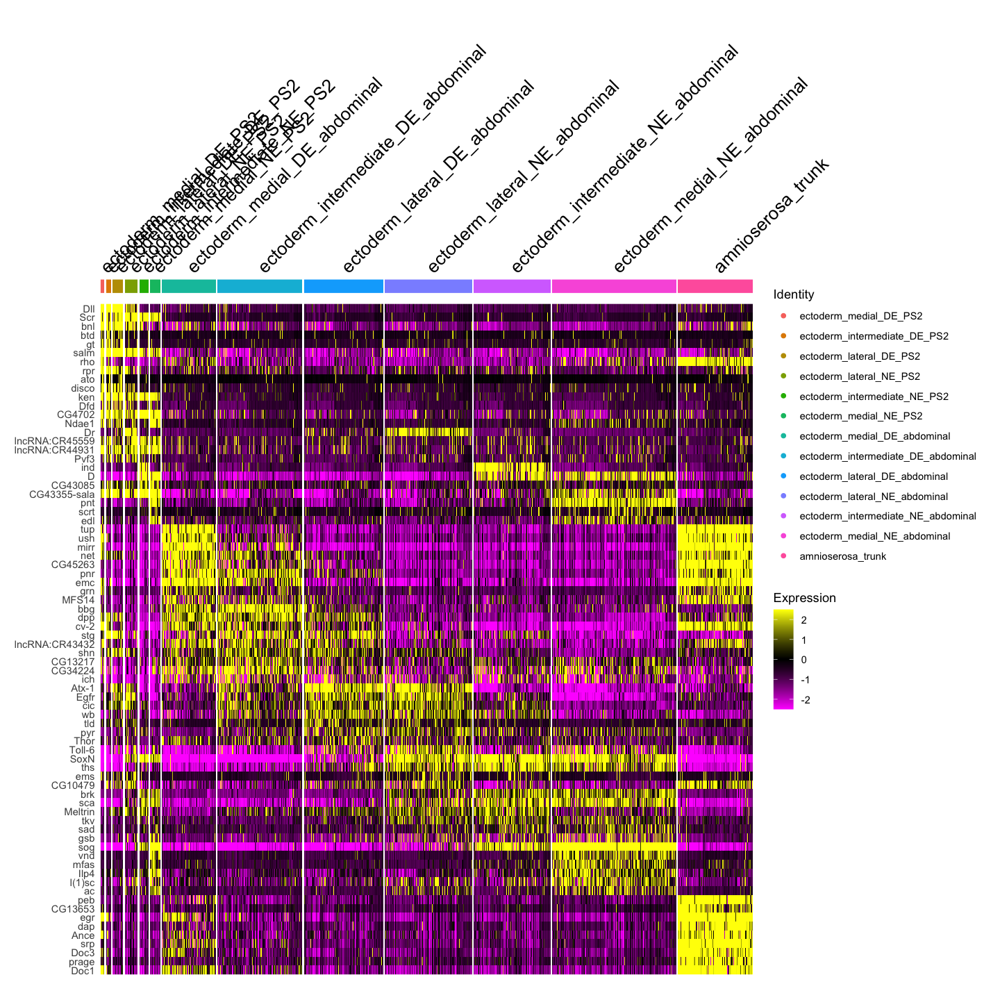

In [73]:
options(repr.plot.width=12, repr.plot.height=12)
fig <- DoHeatmap(seu.ecto.others, features = c(all.markers.top10$gene))
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_manualID_heatmap.eps", dpi = 300,  width = 15, height = 12)

## Annotation of PS1

In [74]:
seu.ps1 <- subset(seu.ecto,idents = 7)
seu.ps1

An object of class Seurat 
25136 features across 414 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, harmony, umap, umapwoharmony

### Clustering

Warning message in PrepDR(object = object, features = features, verbose = verbose):
“The following 18 features requested have not been scaled (running reduction without them): St4, lncRNA:CR44017, asRNA:CR44351, asRNA:CR44873, sing, CG15449, lncRNA:CR45602, TTLL6A, lncRNA:CR43640, asRNA:CR45468, CG9254, lncRNA:CR46031, lncRNA:CR44082, asRNA:CR45124, yellow-f2, asRNA:CR43786, asRNA:CR45208, GstO3”
PC_ 1 
Positive:  Dfd, salm, CG43355-sala, Pvf3, path, Blimp-1, uif, cnc, NetB, gt 
	   CG15628, rdx, CG13427, CG43085, CG17716, SoxN, Con, px, D, Toll-6 
	   Six4, Hsp83, Ilp4, tmod, sog, aos, bnl, CG15480, CG13894, noc 
Negative:  CG34224, Antp, tsh, lncRNA:bxd, Ubx, trn, CG13217, pri, mirr, CG45263 
	   cv-2, ftz, Glut4EF, tup, SNCF, Ama, abd-A, pnr, Z600, emc 
	   Nrt, bbg, lncRNA:CR43432, egr, cv-c, Dtg, Svil, 5-HT2A, lncRNA:CR43887, E2f1 
PC_ 2 
Positive:  sog, D, SoxN, ImpL2, sca, vn, fend, pnt, brk, ths 
	   Tollo, Ilp4, ind, CG17716, NetB, CG43394, trn, vnd, tkv, edl 
	   hh, rdx, E(s

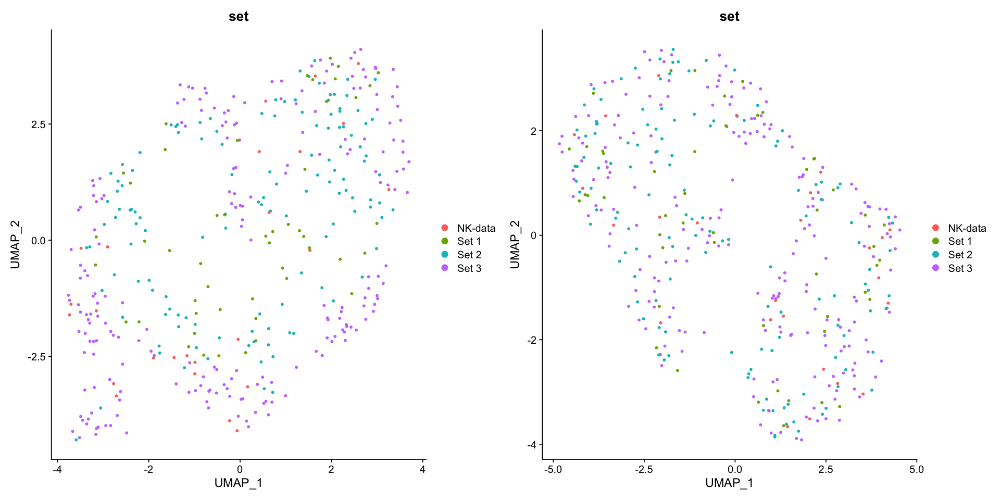

In [75]:
seu.ps1 <- RunPCA(seu.ps1)
seu.ps1 <- RunHarmony(object = seu.ps1, group.by.vars = 'set', assay.use="SCT")
seu.ps1 <- RunUMAP(seu.ps1, dims = 1:30, n.neighbors = 20L, reduction = 'harmony')
seu.ps1 <- RunUMAP(seu.ps1, dims = 1:30, n.neighbors = 20L, reduction = 'pca', reduction.name = 'umapwoharmony')

options(repr.plot.width=16, repr.plot.height=8)
p <- DimPlot(seu.ps1, reduction = 'umapwoharmony', group.by = 'set') + DimPlot(seu.ps1, reduction = 'umap', group.by = 'set')
plot(p)

Computing nearest neighbor graph

Computing SNN



Modularity Optimizer version 1.3.0 by Ludo Waltman and Nees Jan van Eck

Number of nodes: 414
Number of edges: 18696

Running Louvain algorithm...
Maximum modularity in 10 random starts: 0.6354
Number of communities: 5
Elapsed time: 0 seconds


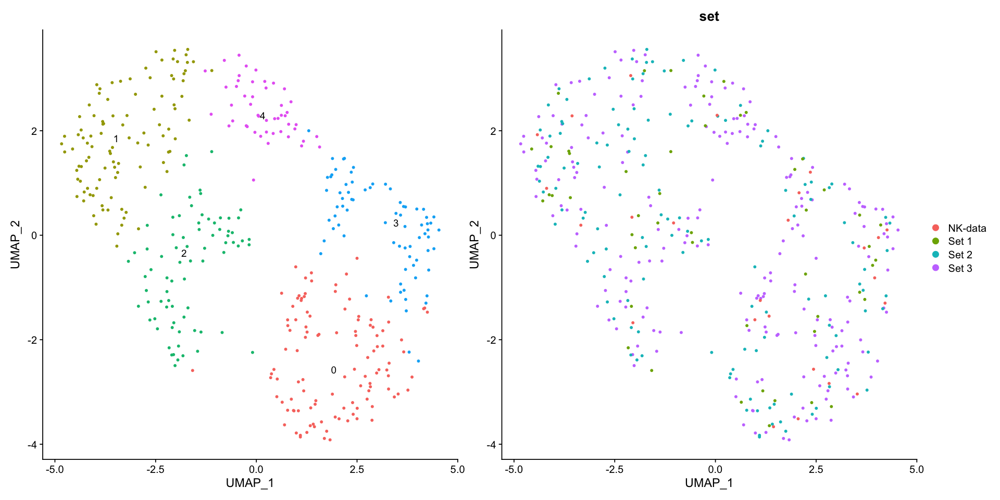

In [76]:
seu.ps1 <- func.subclustering(seu.ps1)

In [77]:
levels(seu.ps1) <- c(3,0,4,2,1)
all.markers <- FindAllMarkers(object = seu.ps1, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

Calculating cluster 3

Calculating cluster 0

Calculating cluster 4

Calculating cluster 2

Calculating cluster 1



[1] 396

[1] 50

Warning message in DoHeatmap(seu.ps1, features = c(all.markers.top10$gene)):
“The following features were omitted as they were not found in the scale.data slot for the SCT assay: CG42817”


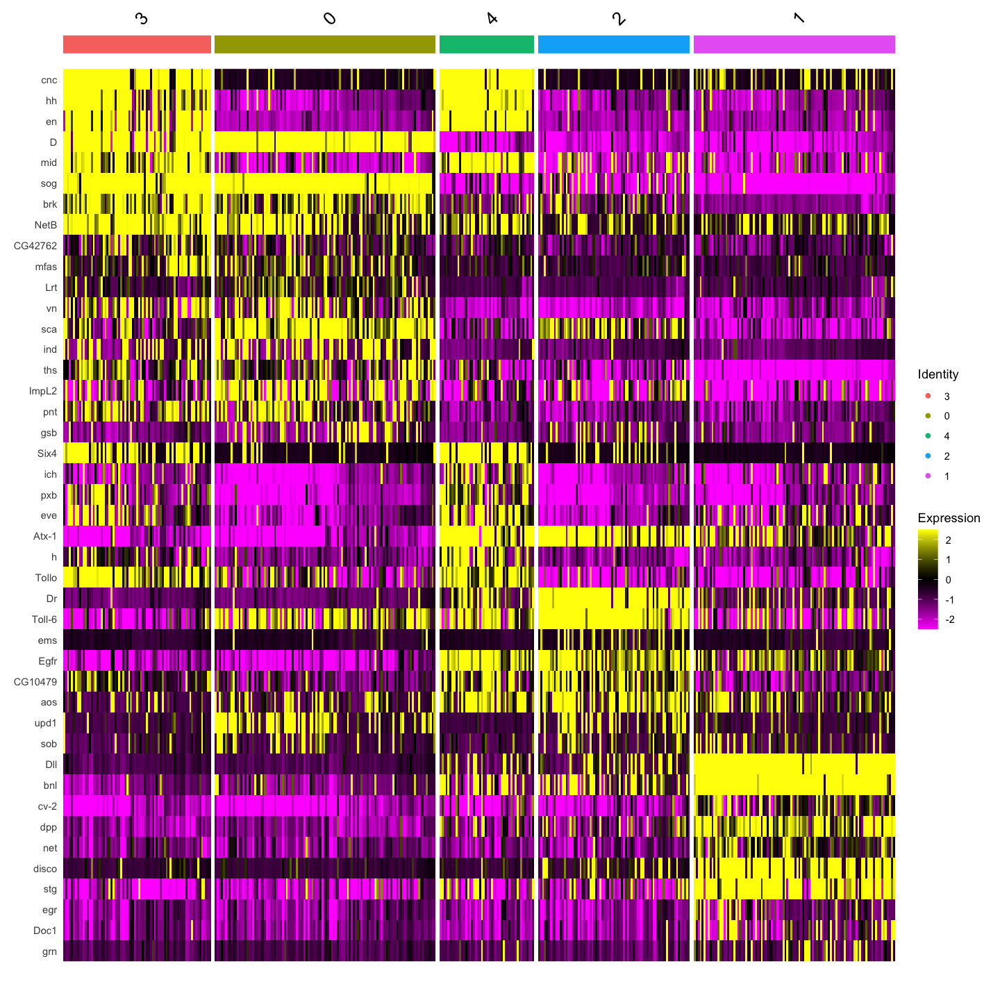

In [78]:
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ps1, features = c(all.markers.top10$gene))

### DV annotation

In [79]:
DV_genes <- c("vnd", "pnt", "ind", "sog", "SoxN", "brk", "dpp", "Egfr", "vn", "pnt",
              "Atx-1", "egr", "cv-2", "Doc1", "Ance", "Dr",  "cic",
              "mirr", "ush", "Ama", "Doc2", "Z600", "Doc3", "stg")

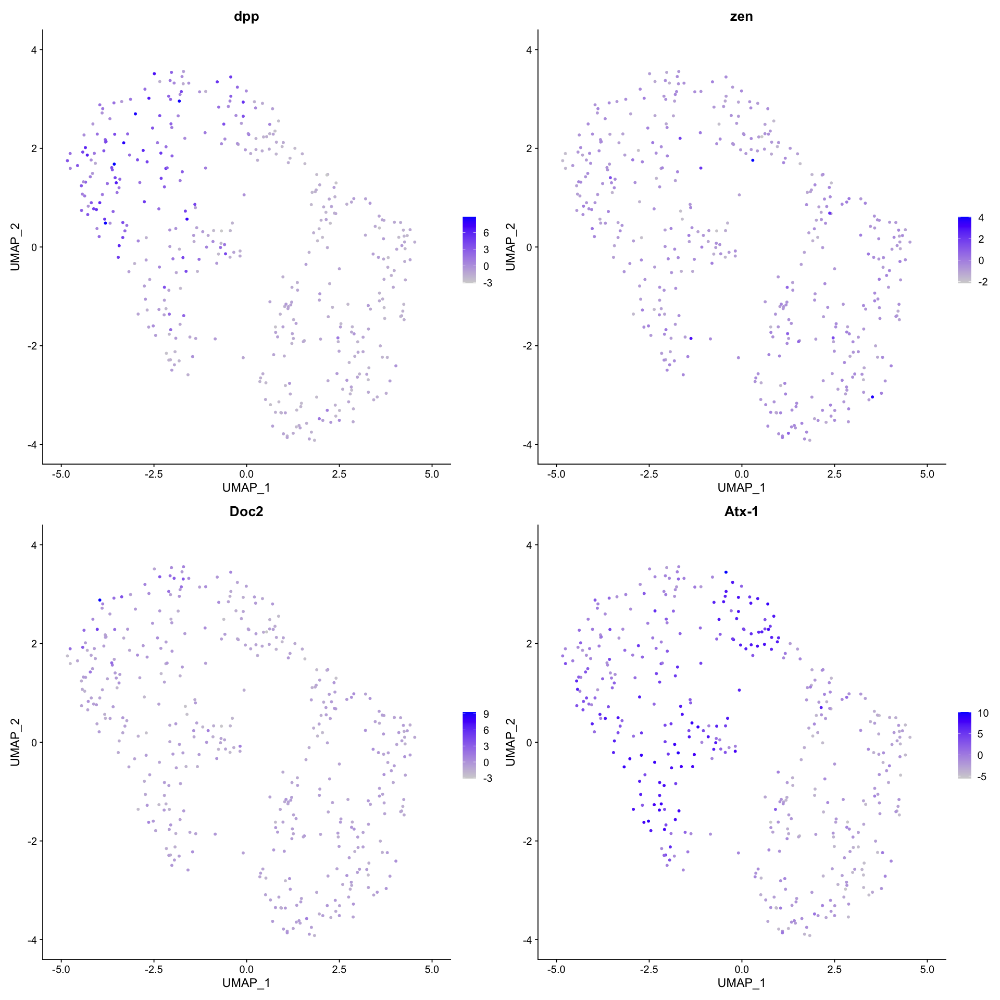

In [80]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ps1, reduction = "umap", features = c("dpp", "zen",'Doc2','Atx-1'), 
            pt.size = 1,  ncol = 2, slot = 'scale.data')

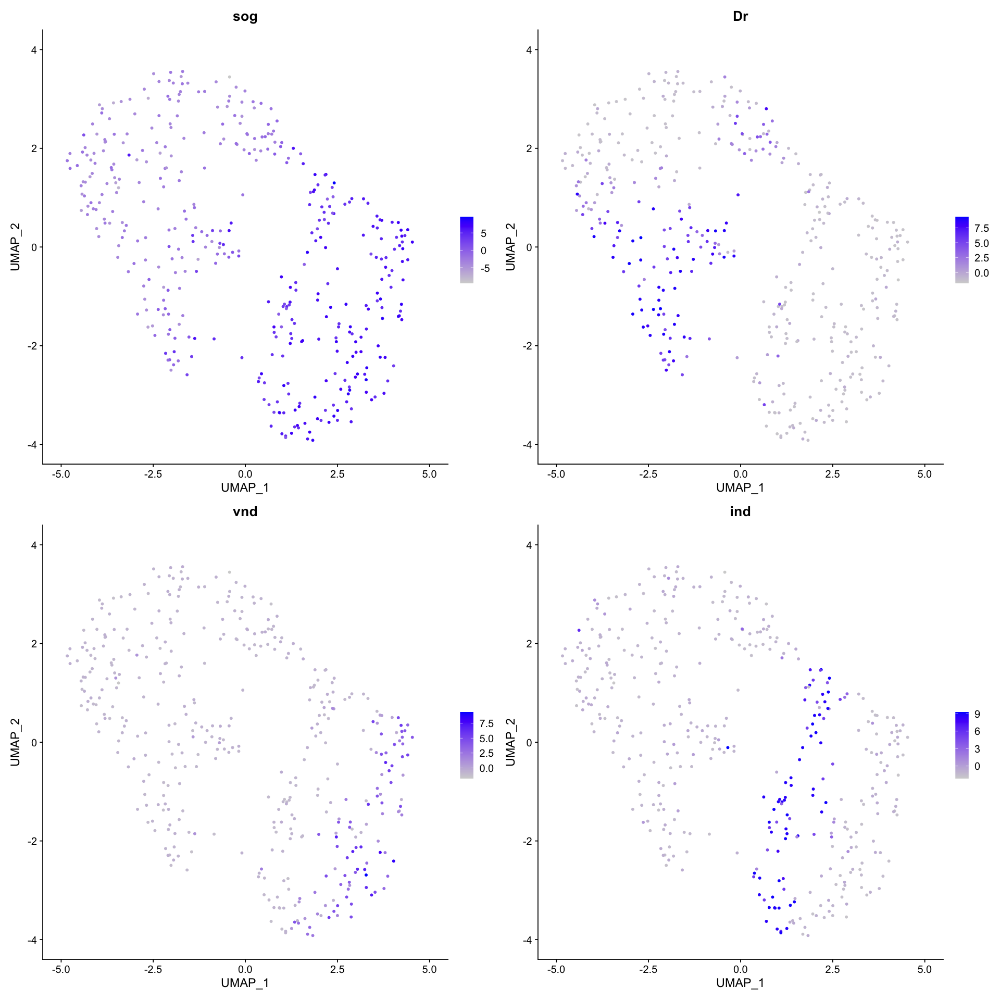

In [81]:
options(repr.plot.width=16, repr.plot.height=16)
FeaturePlot(seu.ps1, reduction = "umap", features = c("sog", "Dr",'vnd','ind'), 
            pt.size = 1,  ncol = 2, slot = 'scale.data')

In [82]:
norm.count.data <- t(as.matrix(GetAssayData(seu.ps1))[DV_genes,])
colnames(norm.count.data) <- 1:dim(norm.count.data)[2]
# Preparation for Harmony
seu.ps1@reductions$dv_genes <- CreateDimReducObject(norm.count.data, key = 'DV', assay = DefaultAssay(seu.ps1))
# Run Harmony
seu.ps1 <- RunHarmony(object = seu.ps1, group.by.vars = 'set', assay.use="SCT", reduction = 'dv_genes')

Warning message:
“Keys should be one or more alphanumeric characters followed by an underscore, setting key from DV to DV_”
Warning message:
“All keys should be one or more alphanumeric characters followed by an underscore '_', setting key to DV_”
Harmony 1/10

Harmony 2/10

Harmony 3/10

Harmony converged after 3 iterations

Warning message:
“Invalid name supplied, making object name syntactically valid. New object name is Seurat..ProjectDim.SCT.harmony; see ?make.names for more details on syntax validity”


In [83]:
norm.count.ecto.dv.genes <- as.matrix(Embeddings(seu.ps1, reduction = 'harmony'))
# norm.count.ecto.dv.genes <- as.matrix(Embeddings(seu.ecto, reduction = 'dv_genes'))
head(norm.count.ecto.dv.genes)

,harmony_1,harmony_2,harmony_3,harmony_4,harmony_5,harmony_6,harmony_7,harmony_8,harmony_9,harmony_10,⋯,harmony_15,harmony_16,harmony_17,harmony_18,harmony_19,harmony_20,harmony_21,harmony_22,harmony_23,harmony_24
Set3_AAAGTCCCACTAGAGG,0.070176589,1.0955770,2.88899814,3.48324264,4.20635113,2.2158478,0.15821517,2.866595,0.59613713,1.0955770,⋯,0.05488463,0.05443226,2.152083,0.04966818,0.78300561,3.0200265,0.017399685,0.8699130,-0.001778131,1.666007
Set3_AACAAGAGTTCACCGG,2.133732815,2.7373256,1.67776538,4.17304844,4.03566884,1.8819494,0.08064263,1.557628,0.67667014,2.7373256,⋯,1.15274426,0.03879219,1.429717,1.69730217,0.12513350,0.8419096,0.024405152,-0.1811068,-0.002880320,1.290736
Set3_AACCTGAAGCGACTGA,0.018198750,1.4205310,-0.11025818,1.67918964,1.39436953,0.1476359,1.91908501,3.428235,1.73455234,1.4205310,⋯,2.33334520,-0.02287355,2.321864,1.23822643,1.87874224,4.3368352,1.799855671,0.4585209,2.437087105,2.745163
Set3_AAGAACAAGGAATTAC,0.090039940,1.3423056,2.95025390,3.76704712,4.19593638,2.0732942,0.09174844,1.581868,0.99158928,1.3423056,⋯,0.05900791,0.74242012,1.467991,0.04420455,0.08794492,1.4736271,0.007854698,0.4633244,-0.009726327,1.242519
Set3_AAGCCATAGCAGCCTC,0.051815633,0.7160679,2.98741998,3.30664710,4.46428599,2.0059907,0.20373786,2.753604,-0.09597083,0.7160679,⋯,0.05189105,0.05961638,2.148295,0.05100913,0.08961928,2.2619023,0.022641223,0.8681489,0.002704558,1.679124
Set3_AAGCGAGCAACAGCCC,0.007526628,1.4236943,-0.08053919,0.07190974,0.01342005,0.1435914,2.58522986,2.251927,0.11667982,1.4236943,⋯,0.81553510,-0.03486797,1.349064,1.92386341,1.46895732,3.9492640,0.859951813,0.8709600,1.915411851,3.783944


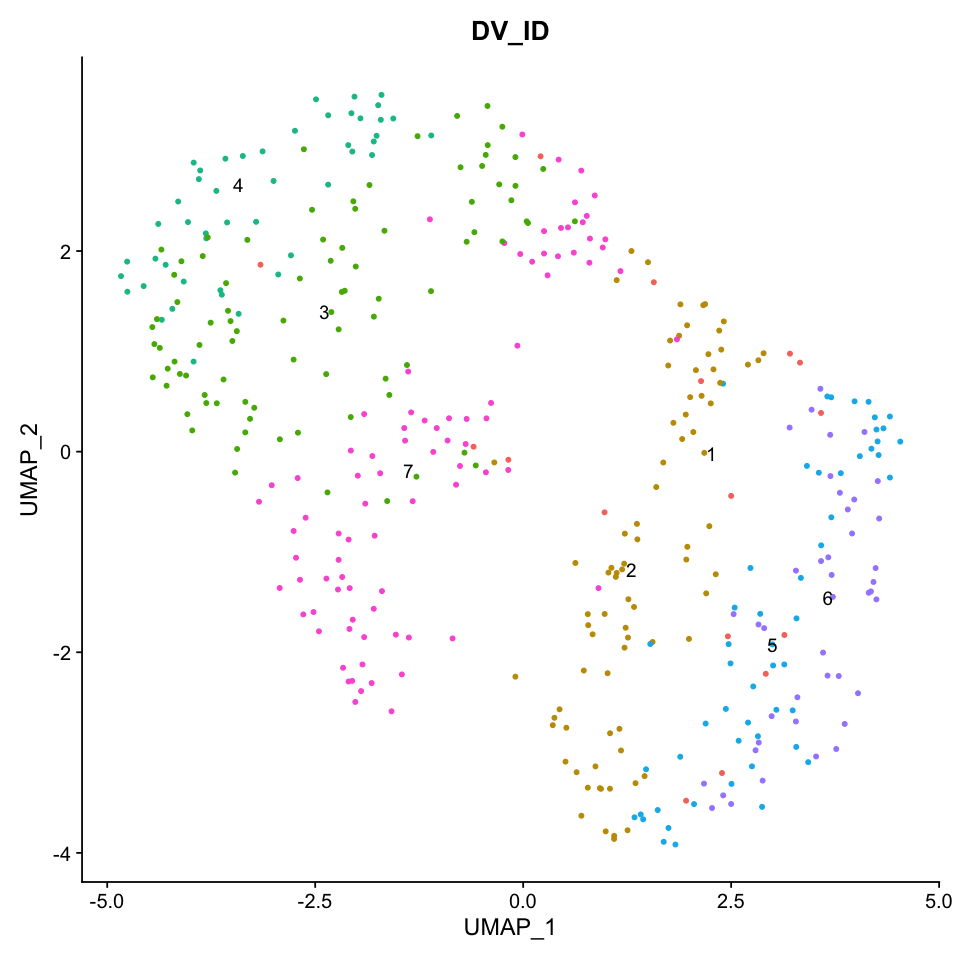

In [84]:
set.seed(0)
trunk_ect_DV_cluster <- kmeans(x=norm.count.ecto.dv.genes, centers=7)
seu.ps1$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ps1, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

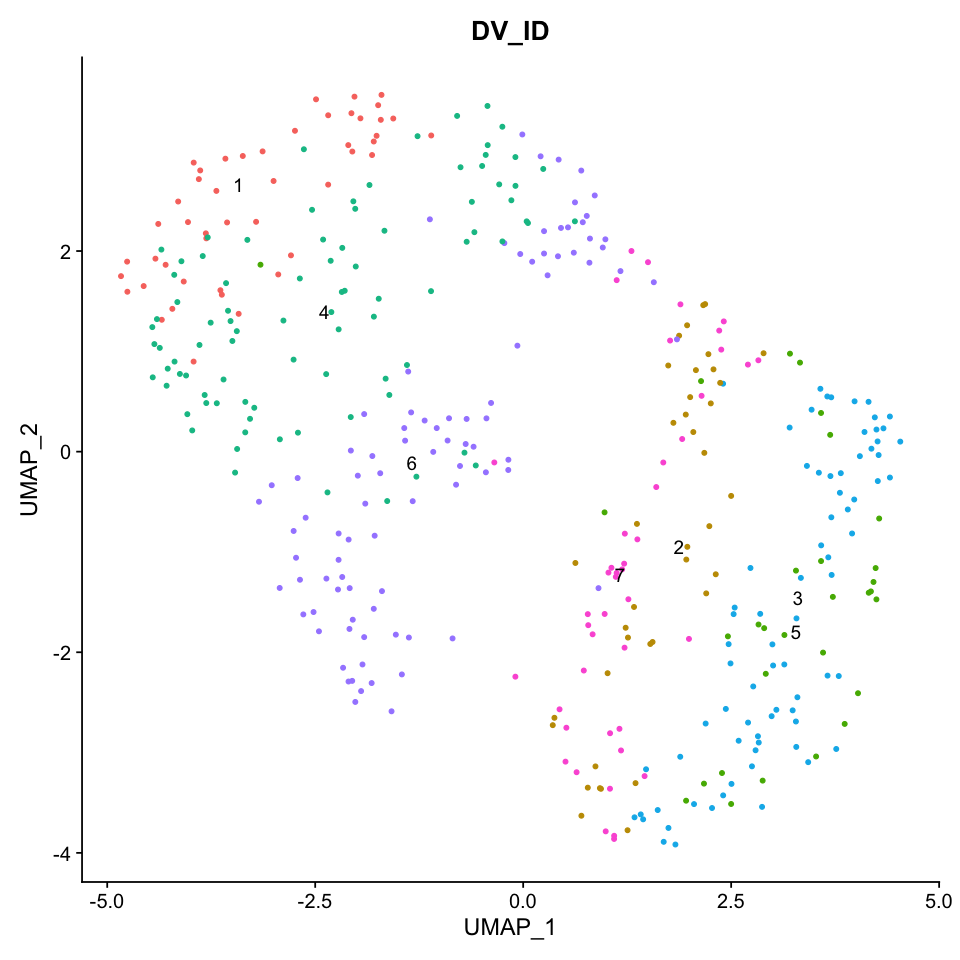

In [85]:
set.seed(3)
trunk_ect_DV_cluster <- kmeans(x=norm.count.ecto.dv.genes, centers=7)
seu.ps1$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ps1, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

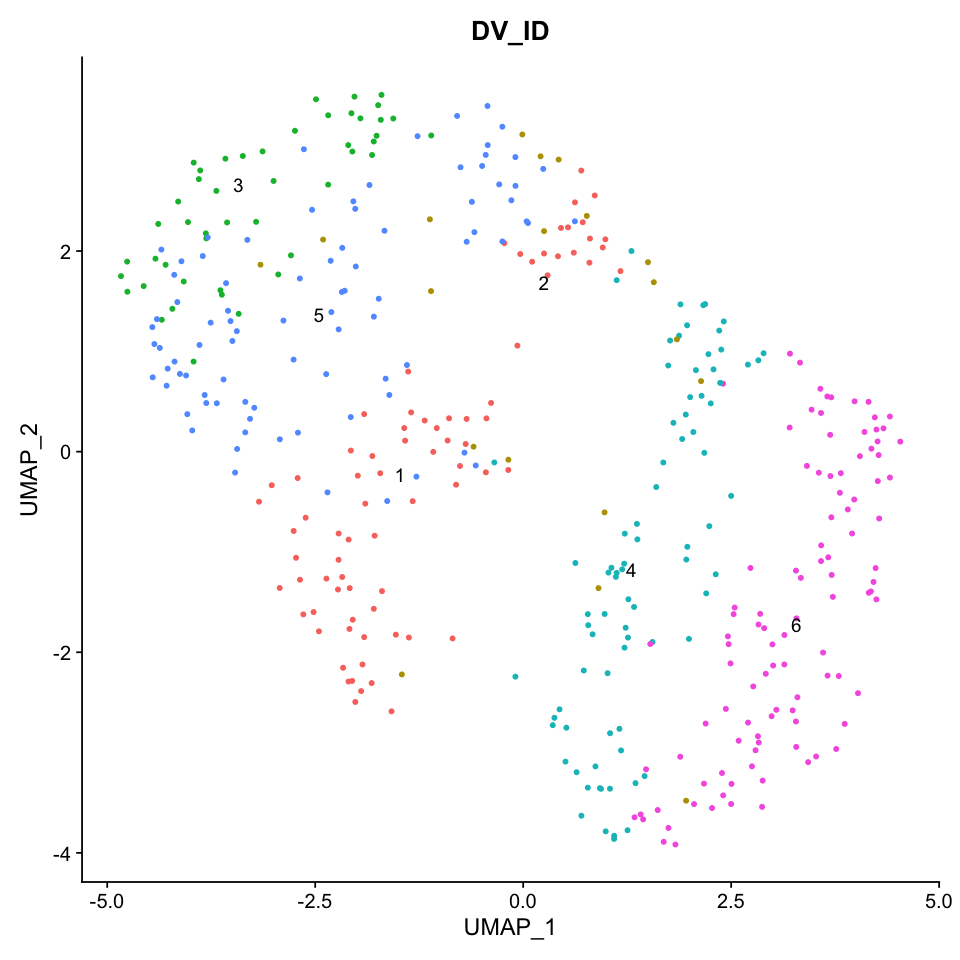

In [86]:
set.seed(2)
trunk_ect_DV_cluster <- kmeans(x=norm.count.ecto.dv.genes, centers=6)
seu.ps1$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ps1, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

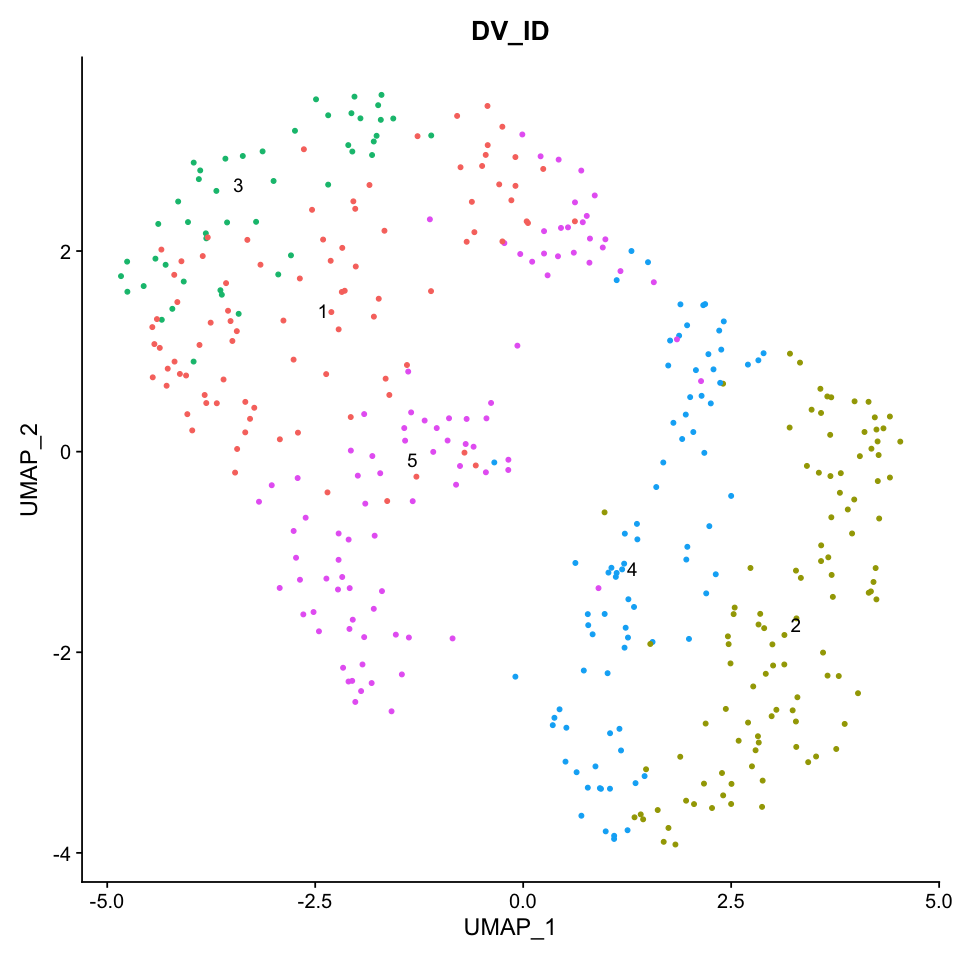

In [87]:
set.seed(2)
trunk_ect_DV_cluster <- kmeans(x=norm.count.ecto.dv.genes, centers=5)
seu.ps1$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ps1, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

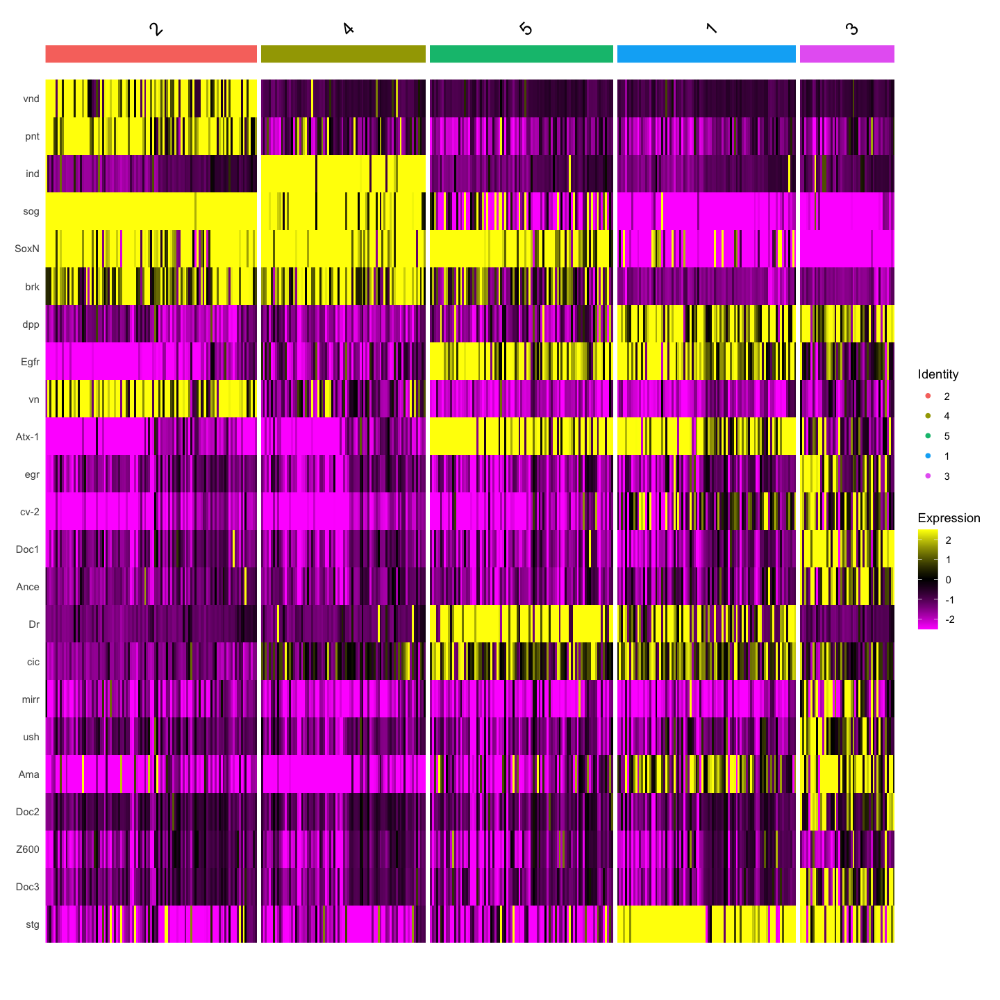

In [88]:
Idents(seu.ps1) <- 'DV_ID'
levels <- c(2,4,5,1,3)
levels(seu.ps1) <- levels
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ps1, features = DV_genes)

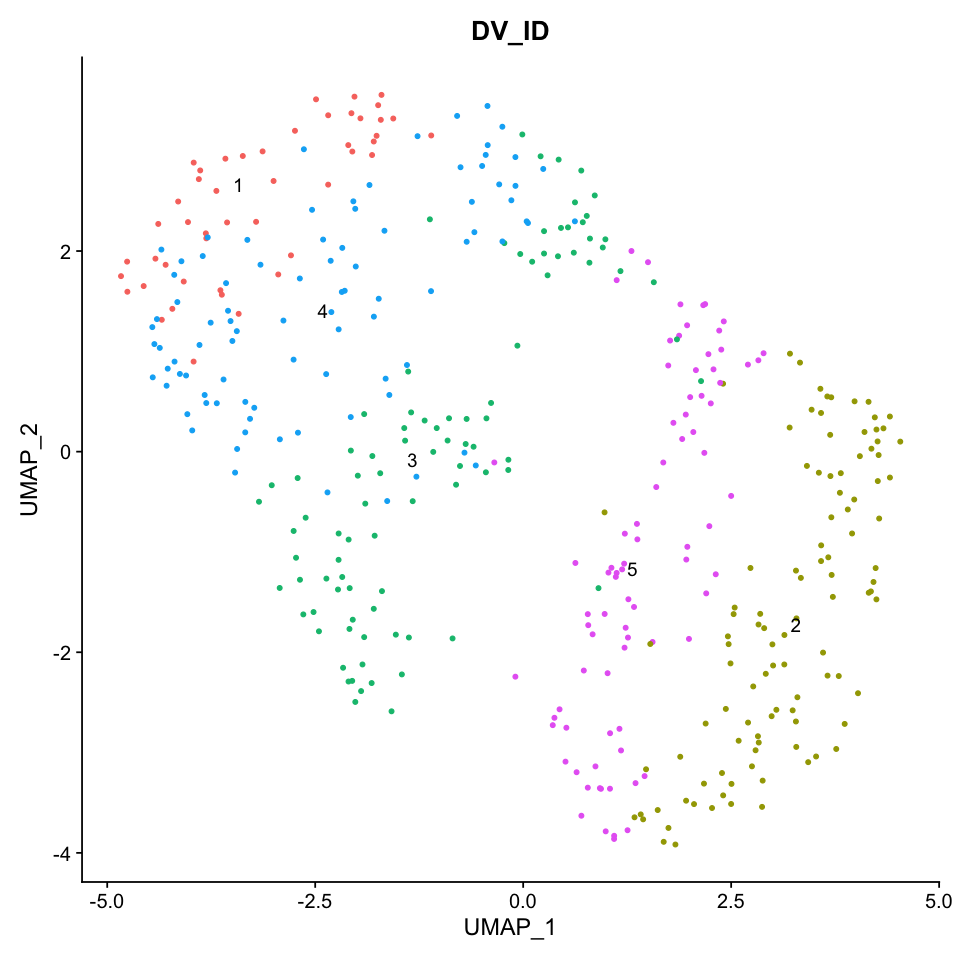

In [89]:
set.seed(4)
trunk_ect_DV_cluster <- kmeans(x=norm.count.ecto.dv.genes, centers=5)
seu.ps1$DV_ID <- trunk_ect_DV_cluster$cluster
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ps1, reduction = 'umap', group.by = 'DV_ID',label = TRUE) + NoLegend()

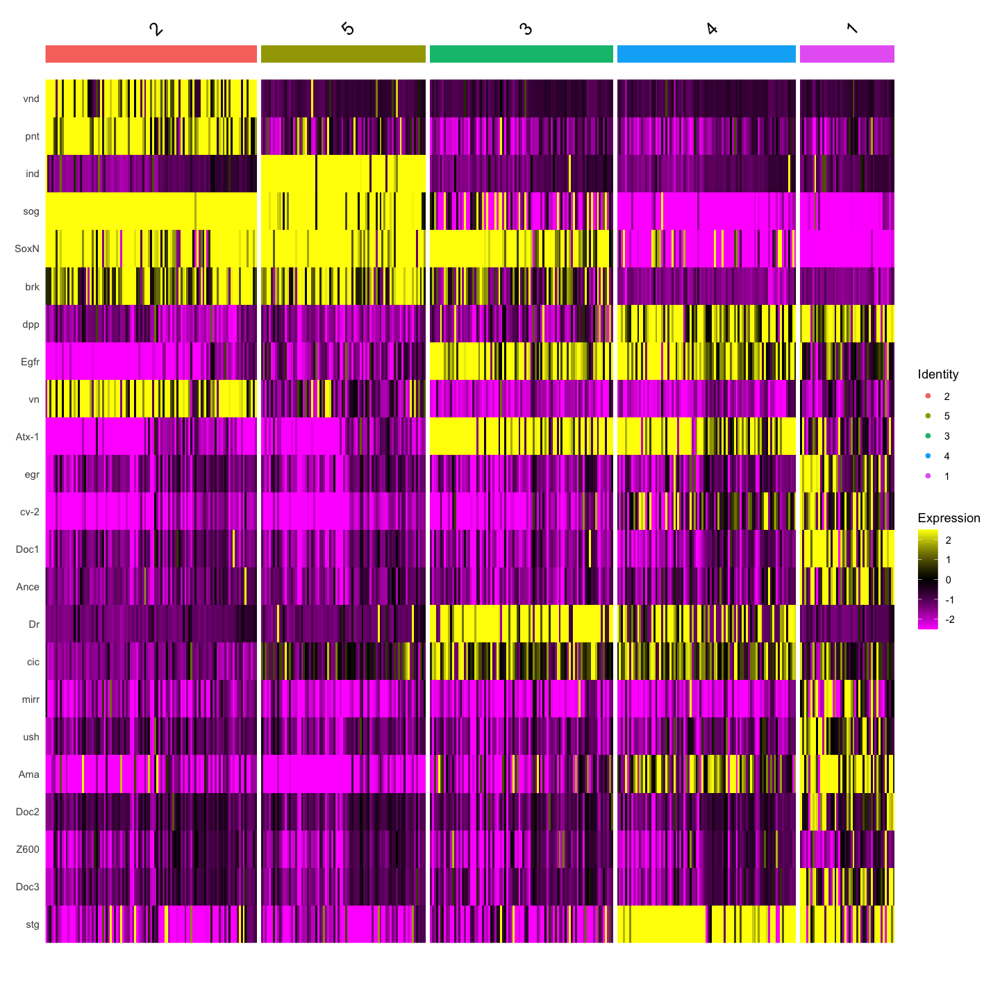

In [90]:
Idents(seu.ps1) <- 'DV_ID'
levels <- c(2,5,3,4,1)
levels(seu.ps1) <- levels
options(repr.plot.width=12, repr.plot.height=12)
DoHeatmap(seu.ps1, features = DV_genes)

,manual_ID
,<int>
Set3_AAAGTCCCACTAGAGG,5
Set3_AACAAGAGTTCACCGG,2
Set3_AACCTGAAGCGACTGA,1
Set3_AAGAACAAGGAATTAC,5
Set3_AAGCCATAGCAGCCTC,5
Set3_AAGCGAGCAACAGCCC,1


,manual_ID
,<chr>
Set3_AAAGTCCCACTAGAGG,ectoderm_intermediate_NE_PS1
Set3_AACAAGAGTTCACCGG,ectoderm_medial_NE_PS1
Set3_AACCTGAAGCGACTGA,ectoderm_medial_DE_PS1
Set3_AAGAACAAGGAATTAC,ectoderm_intermediate_NE_PS1
Set3_AAGCCATAGCAGCCTC,ectoderm_intermediate_NE_PS1
Set3_AAGCGAGCAACAGCCC,ectoderm_medial_DE_PS1


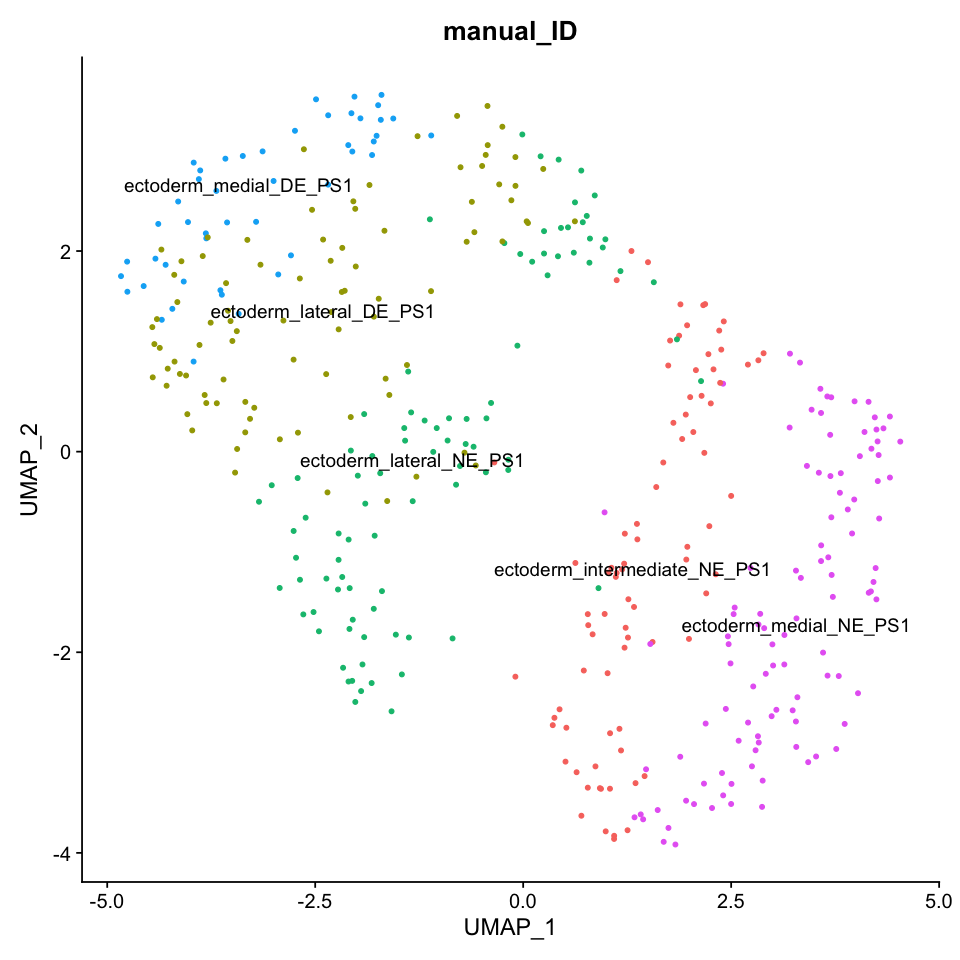

In [91]:
manual_id <- as.data.frame(seu.ps1$DV_ID)
colnames(manual_id) <- c('manual_ID')
head(manual_id)
manual_id$manual_ID = dplyr::recode(manual_id$manual_ID, 
                                     "2"="ectoderm_medial_NE_PS1", 
                                     "5"="ectoderm_intermediate_NE_PS1",
                                     "3"="ectoderm_lateral_NE_PS1",
                                     "4"="ectoderm_lateral_DE_PS1",
                                     "1"="ectoderm_medial_DE_PS1",
                                   )
                                    

head(manual_id)
seu.ps1$manual_ID <- manual_id
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ps1, reduction = 'umap', label = T, group.by = 'manual_ID') + NoLegend() 

In [92]:
levels.ps1 <- c('ectoderm_medial_DE_PS1','ectoderm_lateral_DE_PS1',
                         'ectoderm_lateral_NE_PS1','ectoderm_intermediate_NE_PS1','ectoderm_medial_NE_PS1')
Idents(seu.ps1) <- 'manual_ID'
levels(seu.ps1) <- levels.ps1
levels(seu.ps1) 
all.markers <- FindAllMarkers(object = seu.ps1, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

[1] "ectoderm_medial_DE_PS1"       "ectoderm_lateral_DE_PS1"     
[3] "ectoderm_lateral_NE_PS1"      "ectoderm_intermediate_NE_PS1"
[5] "ectoderm_medial_NE_PS1"

Calculating cluster ectoderm_medial_DE_PS1

Calculating cluster ectoderm_lateral_DE_PS1

Calculating cluster ectoderm_lateral_NE_PS1

Calculating cluster ectoderm_intermediate_NE_PS1

Calculating cluster ectoderm_medial_NE_PS1



[1] 327

[1] 50

Saving 7 x 7 in image



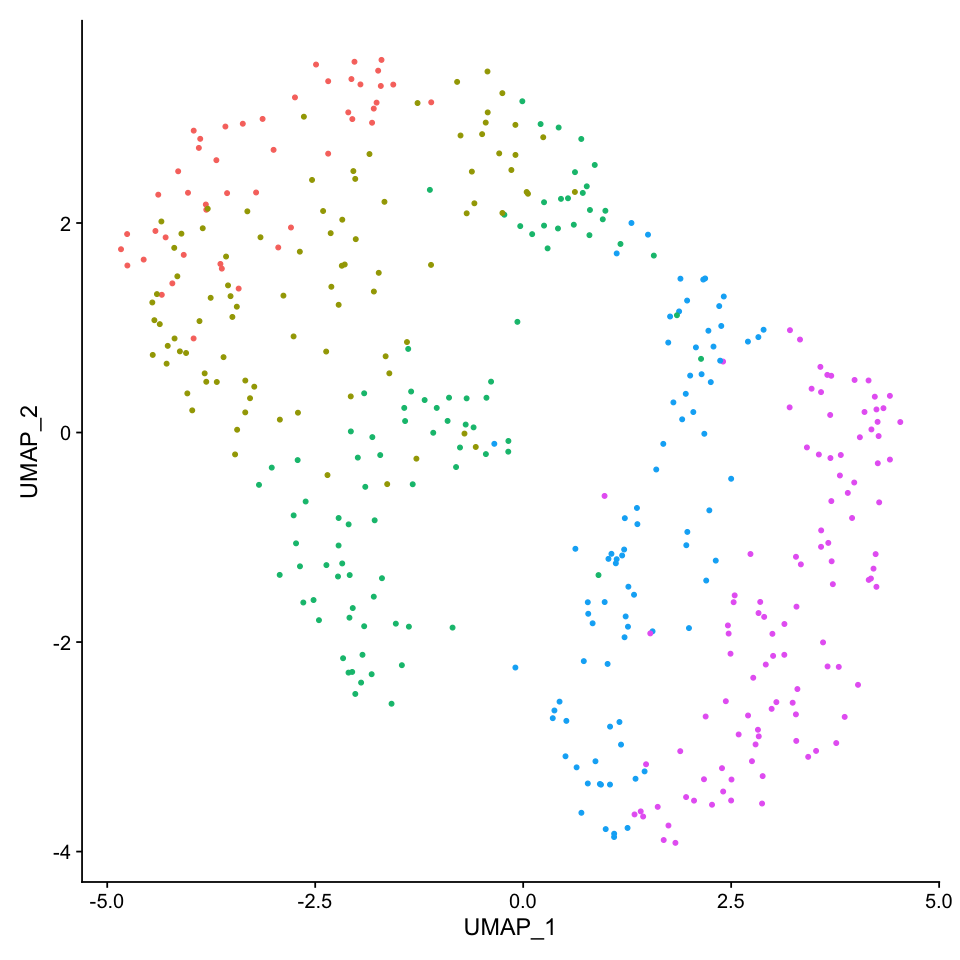

In [93]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ps1, reduction =  "umap", label = FALSE) + NoLegend() 
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/PS1_umap1.eps", dpi = 300)

Saving 7 x 7 in image



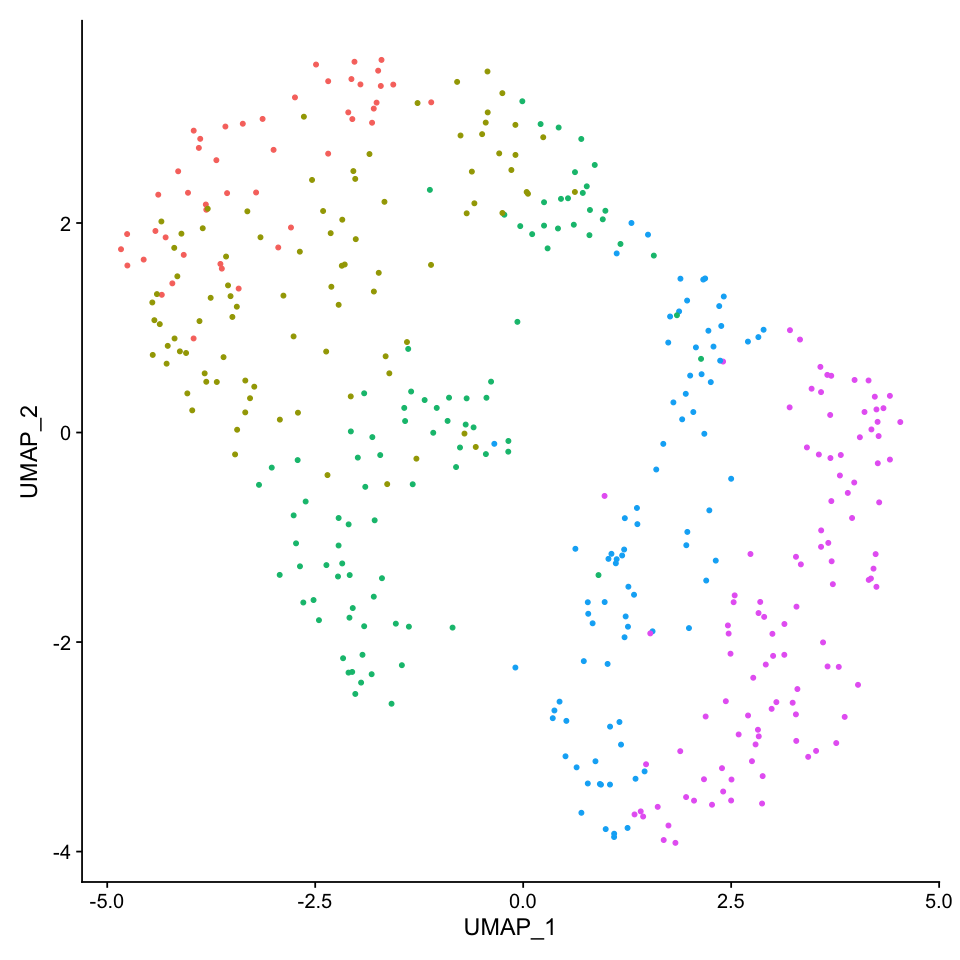

In [94]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ps1, reduction =  "umap", label = FALSE) + NoLegend() 
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/PS1_umap2.eps", dpi = 300)

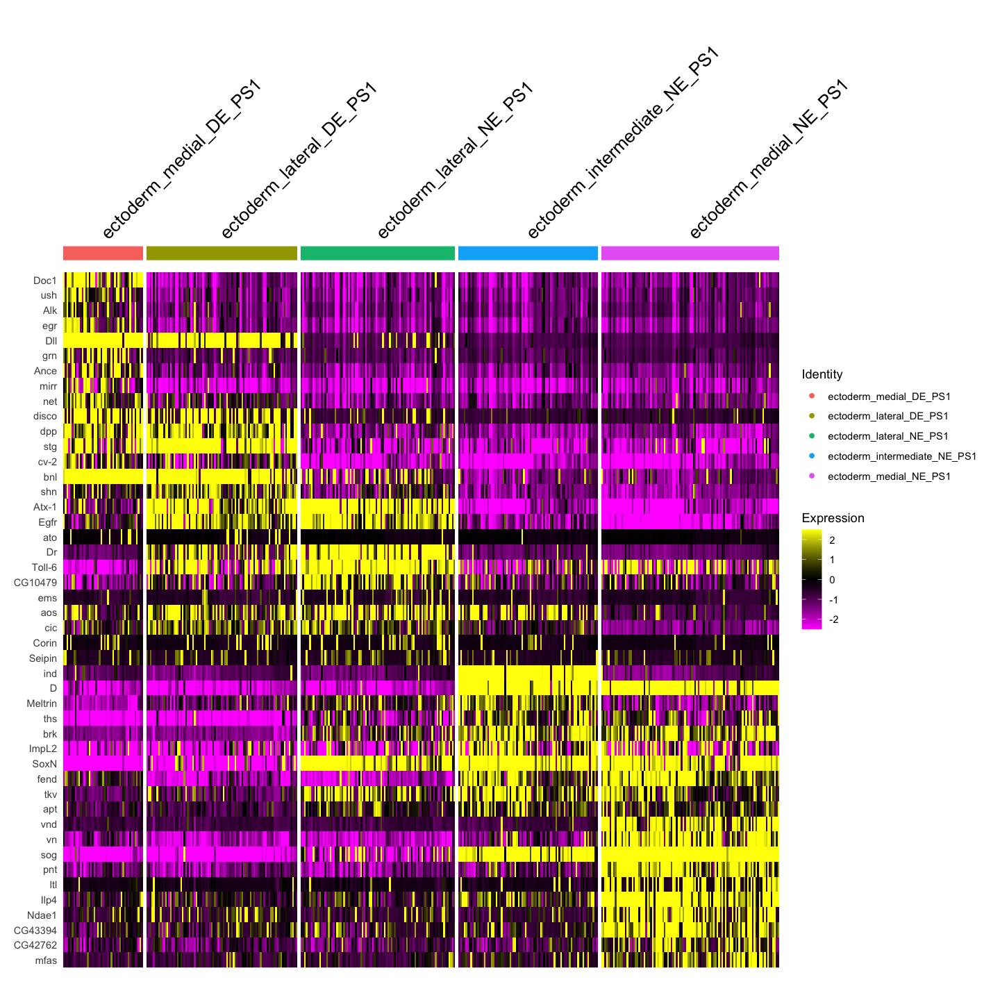

In [95]:
options(repr.plot.width=12, repr.plot.height=12)
fig <- DoHeatmap(seu.ps1, features = c(all.markers.top10$gene))
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/PS1_manualID_heatmap.eps", dpi = 300,  width = 12, height = 8)

## Merge results

In [96]:
seu.merge <- merge(seu.ecto.others, c(seu.ant.as, seu.ps1))
seu.merge
seu.ecto$manual_ID <- seu.merge$manual_ID
seu.ecto

An object of class Seurat 
25136 features across 6432 samples within 2 assays 
Active assay: SCT (12568 features, 0 variable features)
 1 other assay present: RNA

An object of class Seurat 
25136 features across 6432 samples within 2 assays 
Active assay: SCT (12568 features, 3000 variable features)
 1 other assay present: RNA
 4 dimensional reductions calculated: pca, harmony, umap, umapwoharmony

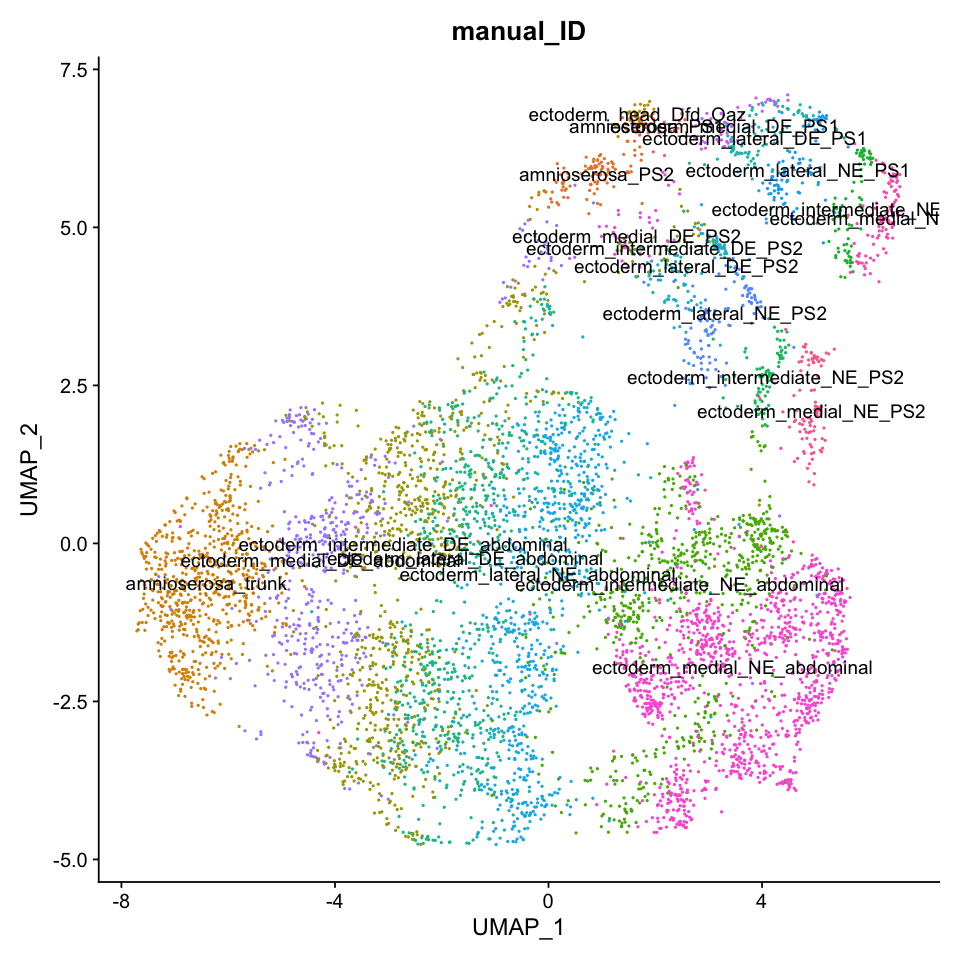

In [97]:
options(repr.plot.width=8, repr.plot.height=8)
DimPlot(seu.ecto, reduction = 'umap', group.by = 'manual_ID',label = TRUE) + NoLegend()

In [98]:
Idents(seu.ecto) <- 'manual_ID'
levels(seu.ecto) <- c(levels.ant.as, levels.ps1, levels.lateral.ecto)
levels(seu.ecto) 
all.markers <- FindAllMarkers(object = seu.ecto, only.pos = TRUE)
nrow(all.markers)
all.markers.top10 <- all.markers %>% group_by(cluster) %>% top_n(n = 10, wt = avg_logFC)
nrow(all.markers.top10)

[1] "ectoderm_head_Dfd_Oaz"              "amnioserosa_PS1"                   
 [3] "amnioserosa_PS2"                    "ectoderm_medial_DE_PS1"            
 [5] "ectoderm_lateral_DE_PS1"            "ectoderm_lateral_NE_PS1"           
 [7] "ectoderm_intermediate_NE_PS1"       "ectoderm_medial_NE_PS1"            
 [9] "ectoderm_medial_DE_PS2"             "ectoderm_intermediate_DE_PS2"      
[11] "ectoderm_lateral_DE_PS2"            "ectoderm_lateral_NE_PS2"           
[13] "ectoderm_intermediate_NE_PS2"       "ectoderm_medial_NE_PS2"            
[15] "ectoderm_medial_DE_abdominal"       "ectoderm_intermediate_DE_abdominal"
[17] "ectoderm_lateral_DE_abdominal"      "ectoderm_lateral_NE_abdominal"     
[19] "ectoderm_intermediate_NE_abdominal" "ectoderm_medial_NE_abdominal"      
[21] "amnioserosa_trunk"

Calculating cluster ectoderm_head_Dfd_Oaz

Calculating cluster amnioserosa_PS1

Calculating cluster amnioserosa_PS2

Calculating cluster ectoderm_medial_DE_PS1

Calculating cluster ectoderm_lateral_DE_PS1

Calculating cluster ectoderm_lateral_NE_PS1

Calculating cluster ectoderm_intermediate_NE_PS1

Calculating cluster ectoderm_medial_NE_PS1

Calculating cluster ectoderm_medial_DE_PS2

Calculating cluster ectoderm_intermediate_DE_PS2

Calculating cluster ectoderm_lateral_DE_PS2

Calculating cluster ectoderm_lateral_NE_PS2

Calculating cluster ectoderm_intermediate_NE_PS2

Calculating cluster ectoderm_medial_NE_PS2

Calculating cluster ectoderm_medial_DE_abdominal

Calculating cluster ectoderm_intermediate_DE_abdominal

Calculating cluster ectoderm_lateral_DE_abdominal

Calculating cluster ectoderm_lateral_NE_abdominal

Calculating cluster ectoderm_intermediate_NE_abdominal

Calculating cluster ectoderm_medial_NE_abdominal

Calculating cluster amnioserosa_trunk



[1] 4280

[1] 210

Saving 7 x 7 in image



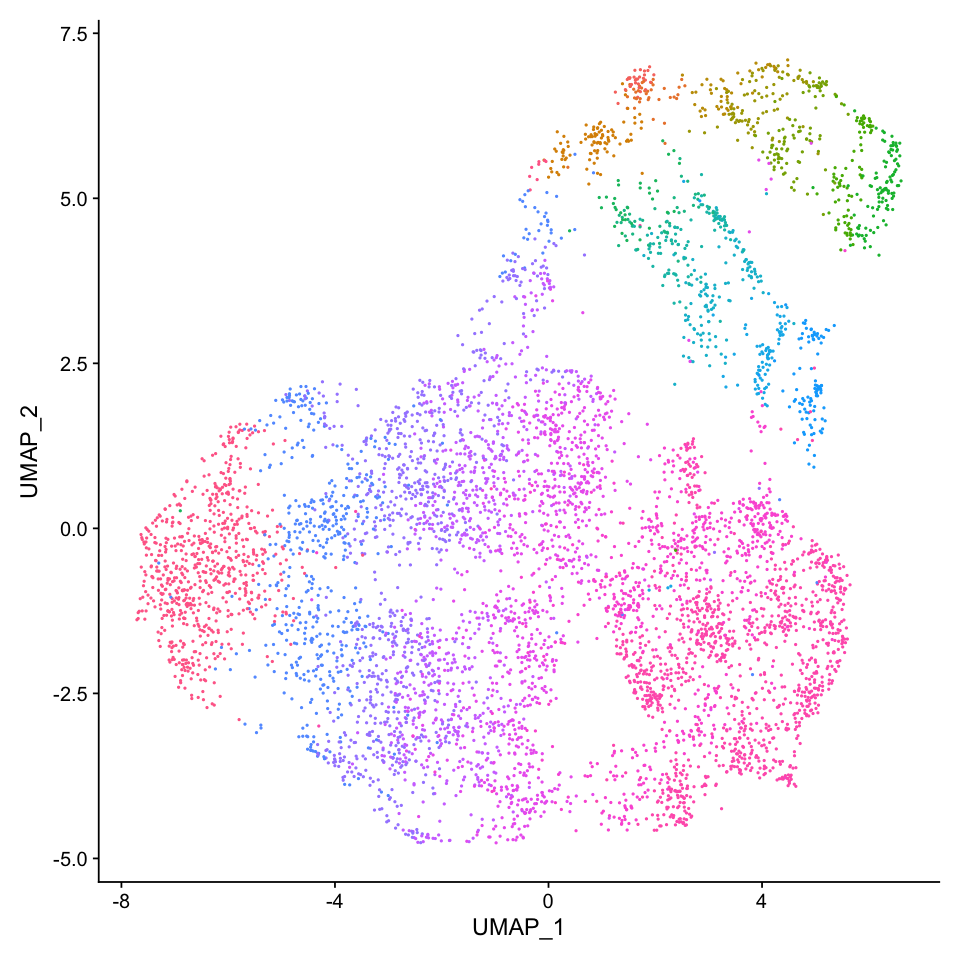

In [99]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE) + NoLegend() 

fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_AS_umap1.eps", dpi = 300)

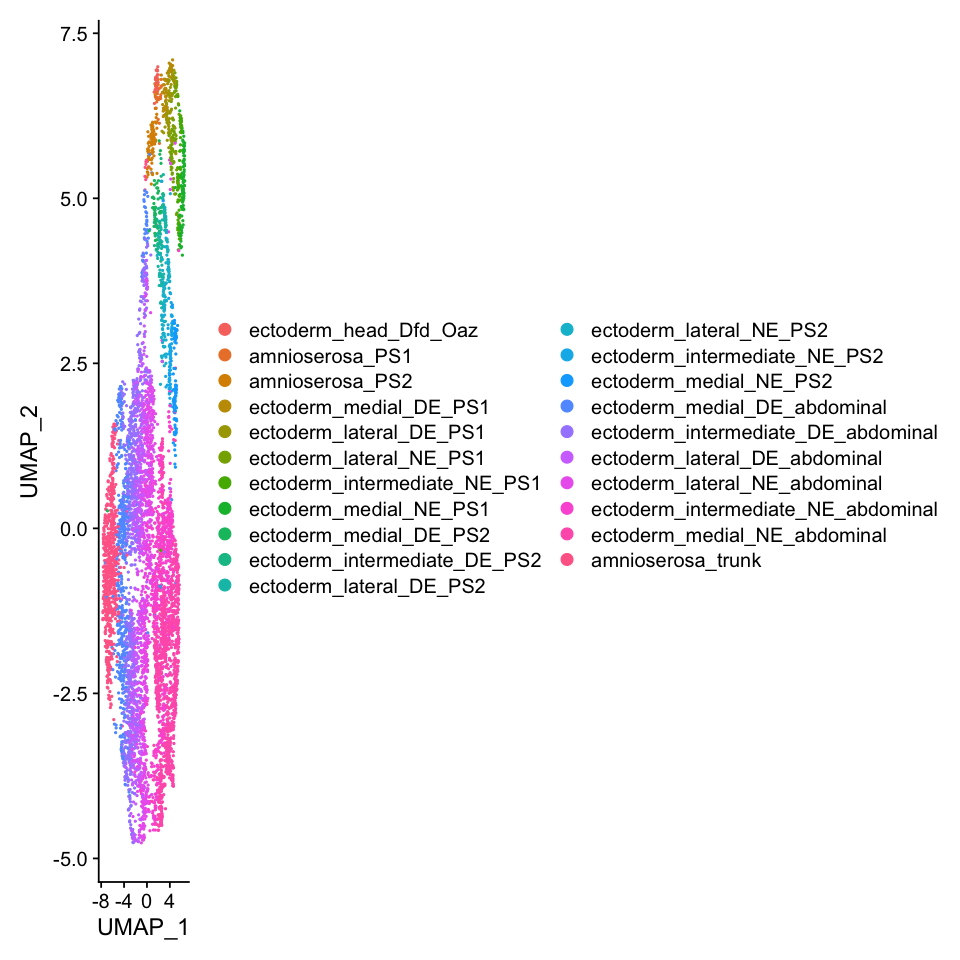

In [100]:
options(repr.plot.width=8, repr.plot.height=8)
fig <- DimPlot(seu.ecto, reduction =  "umap", label = FALSE)
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_AS_umap2.eps", dpi = 300, width = 15, height = 8)

Warning message in DoHeatmap(seu.ecto, features = c(all.markers.top10$gene)):
“The following features were omitted as they were not found in the scale.data slot for the SCT assay: Dscam2”


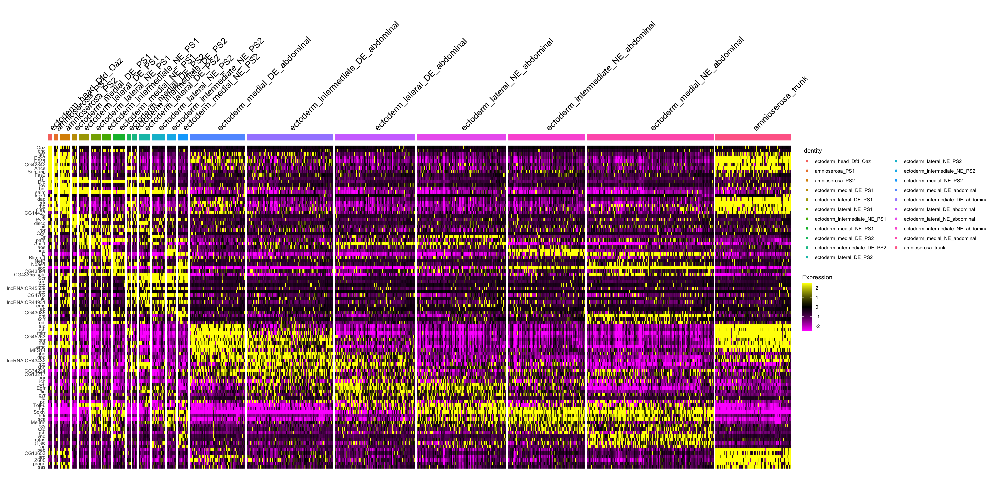

In [101]:
options(repr.plot.width=25, repr.plot.height=12)
fig <- DoHeatmap(seu.ecto, features = c(all.markers.top10$gene))
fig
ggsave(fig, file = "./figures/06_lateral_ecto_subclustering_integrate_all/lateral_ecto_AS_manualID_heatmap.eps", dpi = 300,  width = 25, height = 12)

In [102]:
seu.others <- subset(seu_HQC, cells = colnames(seu.ecto), invert = T)
seu.others$manual_ID <- 'others'
seu.merge <- merge(seu.ecto, seu.others)
seu_HQC$manual_ID <- seu.merge$manual_ID

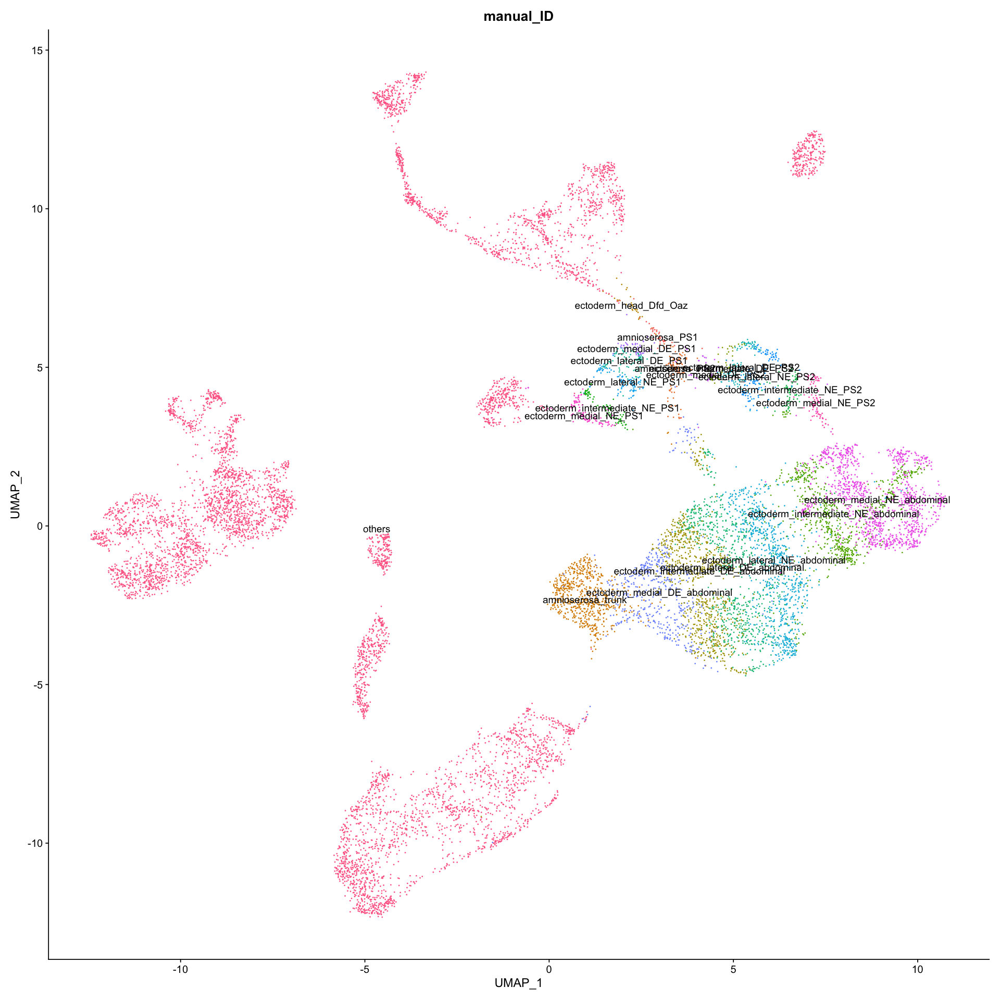

In [103]:
options(repr.plot.width=16, repr.plot.height=16)
DimPlot(seu_HQC, reduction = 'umap', group.by = 'manual_ID',label = TRUE) + NoLegend()

In [104]:
saveRDS(object = seu.ecto, file = '../../data/seurat_object/all_integration/subclustering/seu_ecto_subclustering.obj')